## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'coco-outdoor' 
TRANSFORM = 'gabor'
CHANNEL = 'green'
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
green_gabor_outdoor_coco.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/coco/outdoor/gabor/green'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 65536000,
 1: 65536000,
 2: 65536000,
 3: 65536000,
 4: 65536000,
 5: 65536000,
 6: 65536000,
 7: 65536000,
 8: 65536000,
 9: 65536000,
 10: 65536000,
 11: 65536000,
 12: 65536000,
 13: 65536000,
 14: 65536000,
 15: 65536000,
 16: 65536000,
 17: 65536000,
 18: 65536000,
 19: 65536000,
 20: 65536000,
 21: 65536000,
 22: 65536000,
 23: 65536000,
 24: 65536000,
 25: 65536000,
 26: 65536000,
 27: 65536000,
 28: 65536000,
 29: 65536000,
 30: 65536000,
 31: 65536000,
 32: 65536000,
 33: 65536000,
 34: 65536000,
 35: 65536000,
 36: 65536000,
 37: 65536000,
 38: 65536000,
 39: 65536000,
 40: 65536000,
 41: 65536000}

Running 12760 CDFs


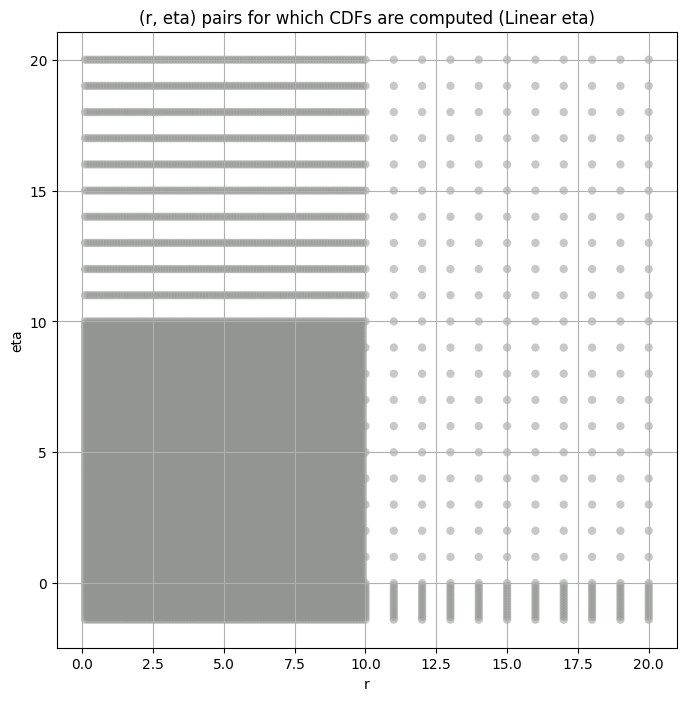

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,53968.47700,42842.63700,65663.23400,4.529419,2.671541,9.929728,65536000.0,"(2.0, 0.5, 0.044)"
1,20821.29500,16402.21900,26296.40400,5.743000,3.342600,14.397355,65536000.0,"(2.0, 0.5, 0.065)"
2,7666.59000,6005.21500,9682.26800,7.084080,3.844694,16.008696,65536000.0,"(2.0, 0.5, 0.096)"
3,3192.91380,2420.70830,4104.83300,8.654820,4.767221,21.822508,65536000.0,"(2.0, 0.5, 0.141)"
4,1371.63120,1016.44110,1742.18730,9.491283,5.425109,24.351202,65536000.0,"(2.0, 0.5, 0.208)"
5,537.38885,396.54030,695.85910,10.527098,5.672311,24.628796,65536000.0,"(2.0, 0.5, 0.306)"
6,364.30988,267.56274,482.30508,10.603776,6.072431,26.286480,65536000.0,"(2.0, 0.5, 0.45)"
7,76423.19500,61806.15600,95057.44500,5.325180,3.042860,11.335867,65536000.0,"(2.0, 1.0, 0.044)"
8,28467.82000,21926.42800,36817.16400,7.597873,3.740597,19.843456,65536000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,53968.47700,53968.476562,52171.199219,50966.539062,49009.585938
1,20821.29500,20821.294922,20042.849609,19518.396484,18663.681641
2,7666.59000,7666.589844,7343.755859,7127.635254,6774.272949
3,3192.91380,3192.913818,3037.943604,2936.143066,2771.522949
4,1371.63120,1371.631226,1299.315186,1253.428345,1181.651733
5,537.38885,537.388855,508.363007,489.044373,457.970276
6,364.30988,364.309875,344.503418,331.544006,310.609894
7,76423.19500,76423.195312,73572.851562,71612.375000,68459.414062
8,28467.82000,28467.820312,27089.269531,26213.785156,24848.791016


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.007354785186968901 53968.477


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.007932301471666514 52171.2


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.008258618661319606 50966.54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.008822032083650663 49009.586
Number of samples: 100000, Without approximation : 65536000.0


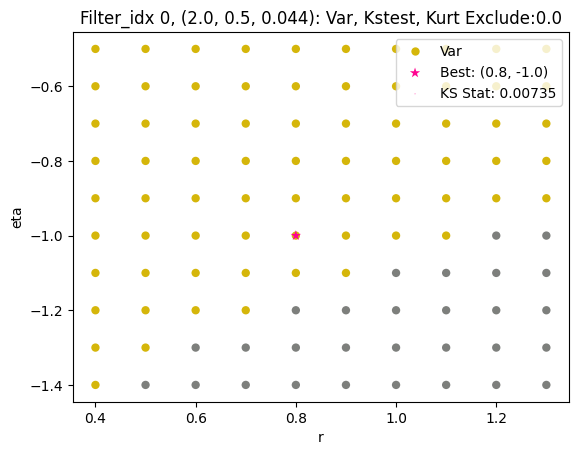

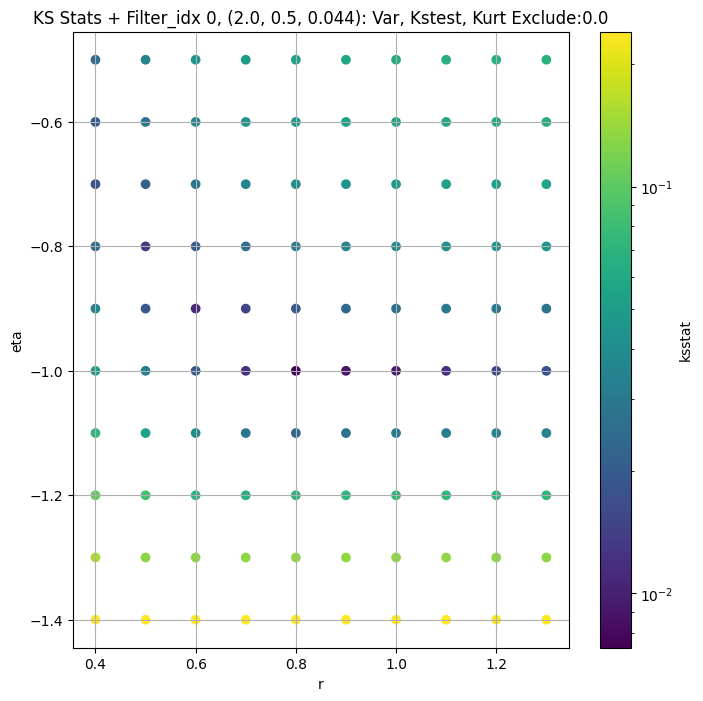

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.0038339913104782353 20821.295


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.004381077988072121 20042.85


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.005649883129027949 19518.396


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.006202536462752498 18663.682
Number of samples: 100000, Without approximation : 65536000.0


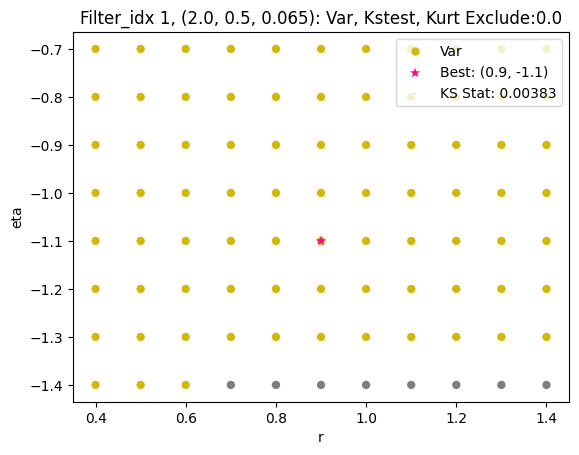

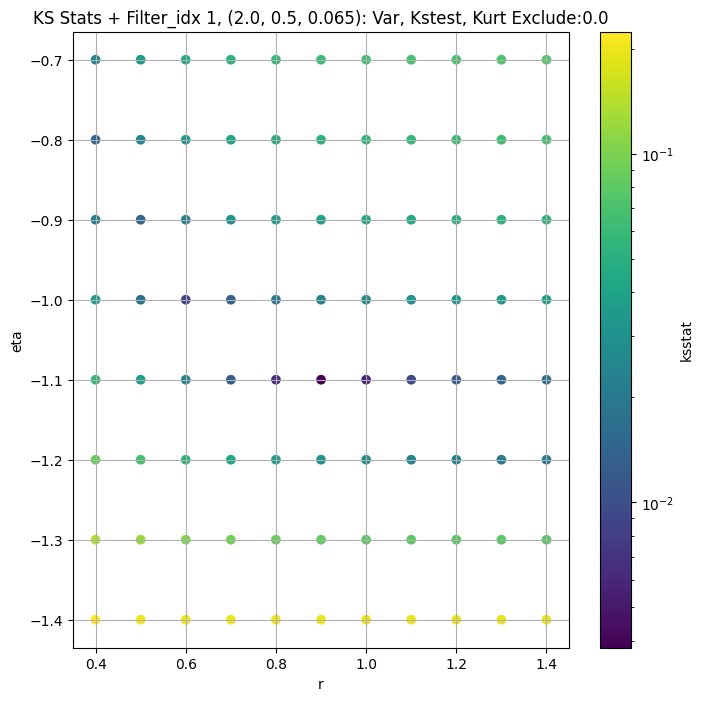

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.005156349032790386 7666.59


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.0044281594508295274 7343.756


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.005520822458642528 7127.6353


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.006488181550940553 6774.273
Number of samples: 100000, Without approximation : 65536000.0


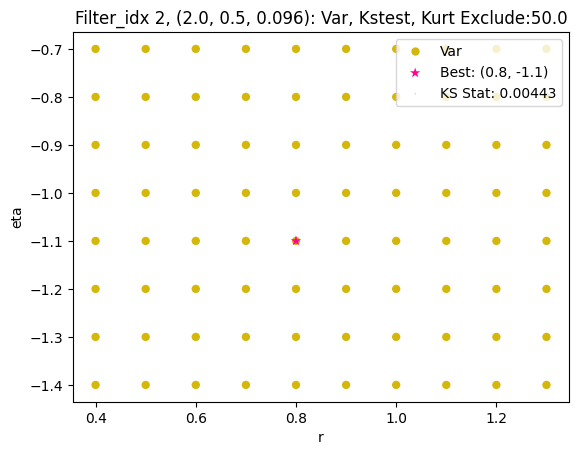

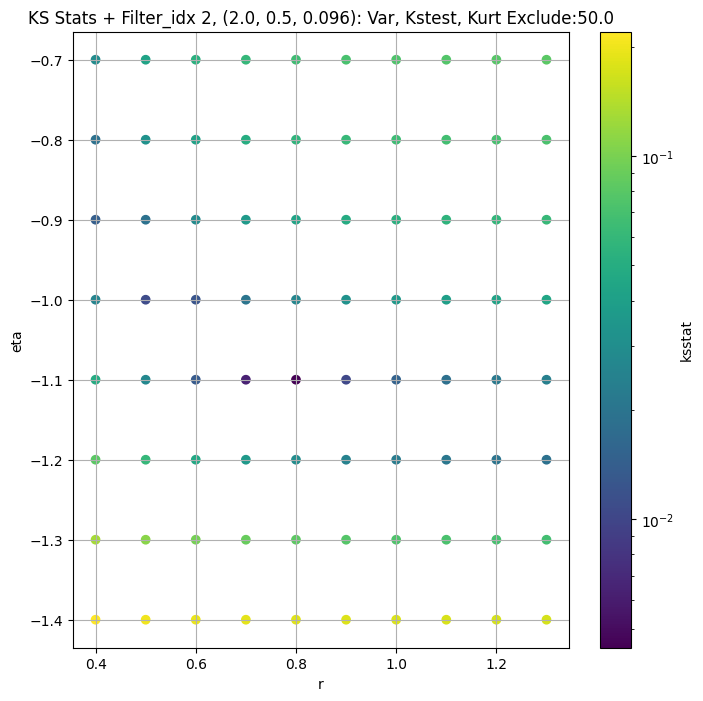

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.0043648491234128325 3192.9138


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.006560515864277208 3037.9436


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.005705483563101299 2936.143


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.007733853176715821 2771.523
Number of samples: 100000, Without approximation : 65536000.0


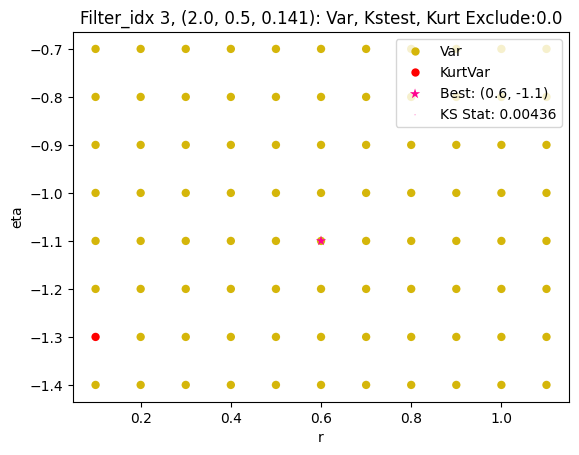

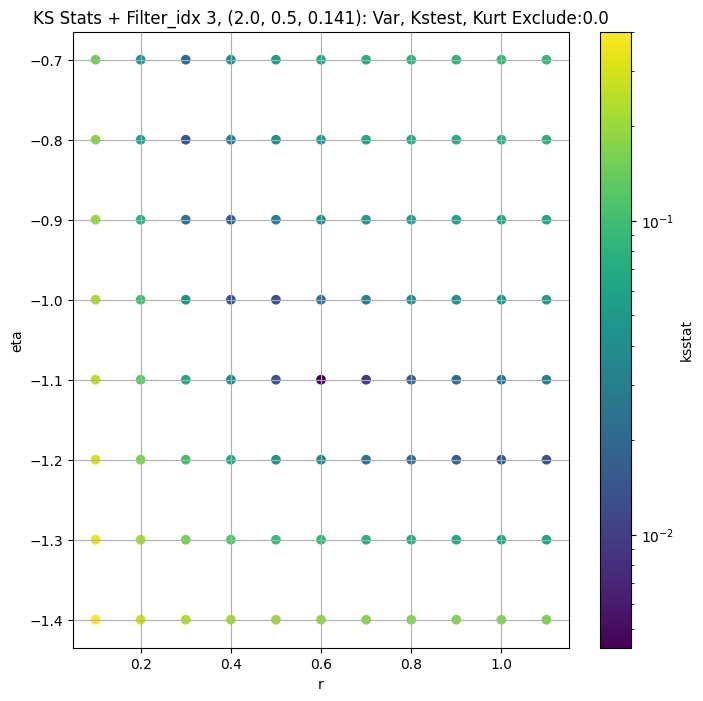

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.006904573126828795 1371.6312


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.005394385834461446 1299.3152


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.006380812314237733 1253.4283


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.008758361081052025 1181.6517
Number of samples: 100000, Without approximation : 65536000.0


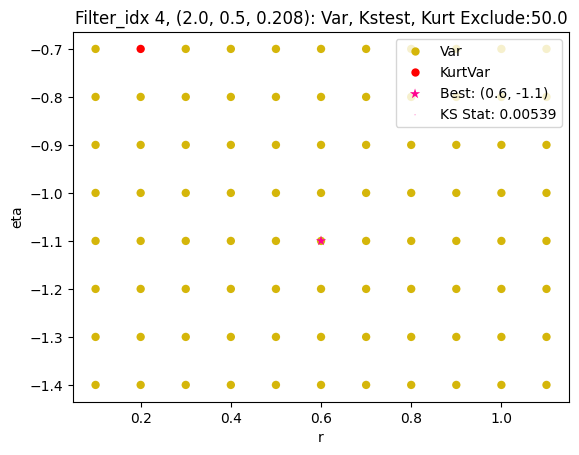

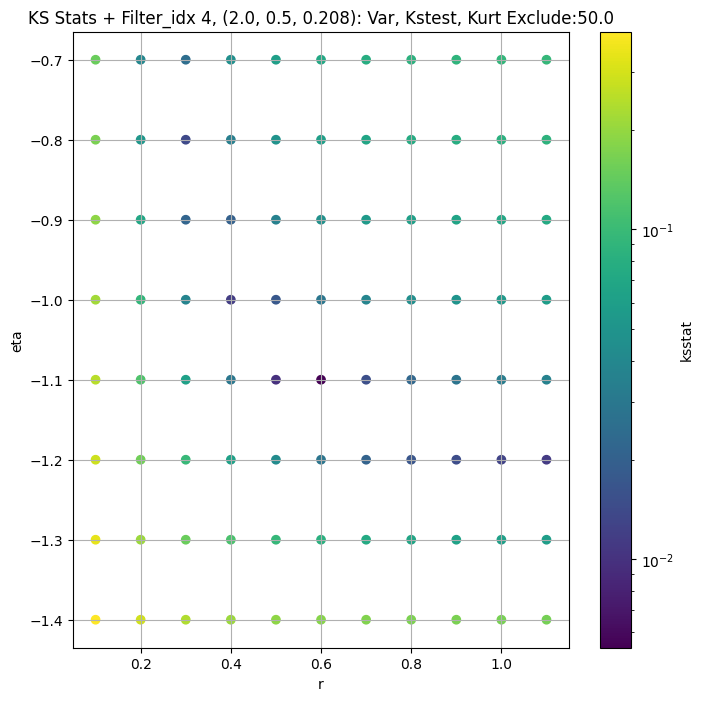

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.00925408486860857 537.38885


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.009287040648231382 508.363


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.009275283318255612 489.04437


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.009275902790784607 457.97028
Number of samples: 100000, Without approximation : 65536000.0


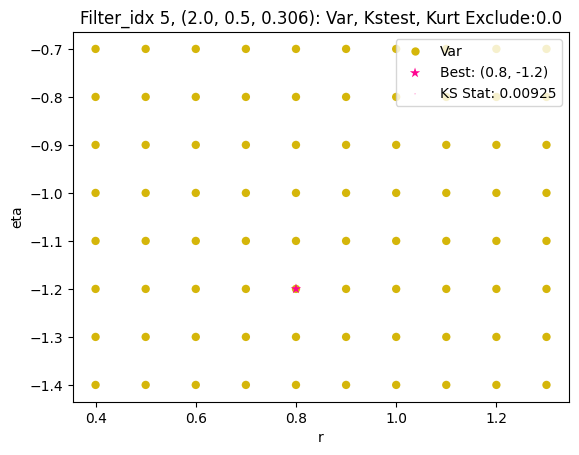

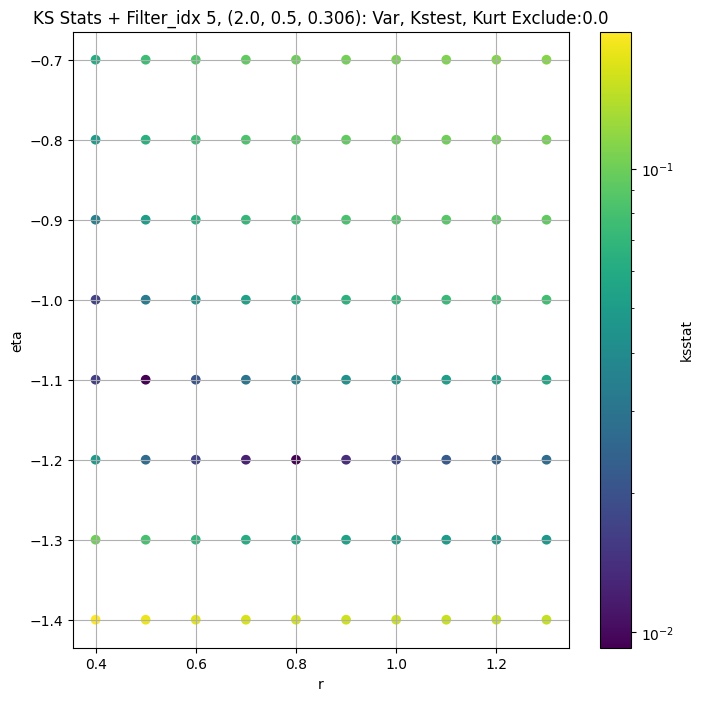

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.011972135617695778 364.30988


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.011957984260485388 344.50342


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.011957170978819875 331.544


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.01195575124805015 310.6099
Number of samples: 100000, Without approximation : 65536000.0


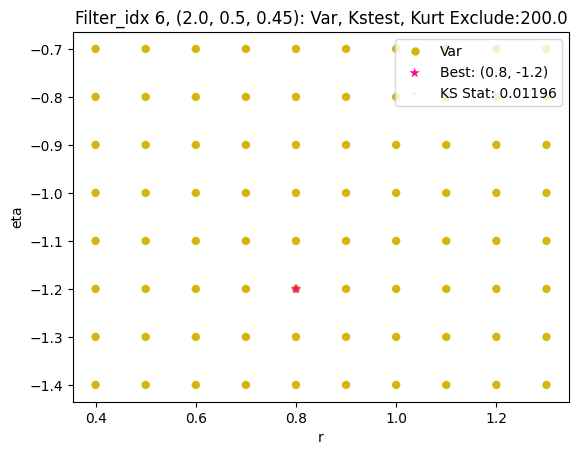

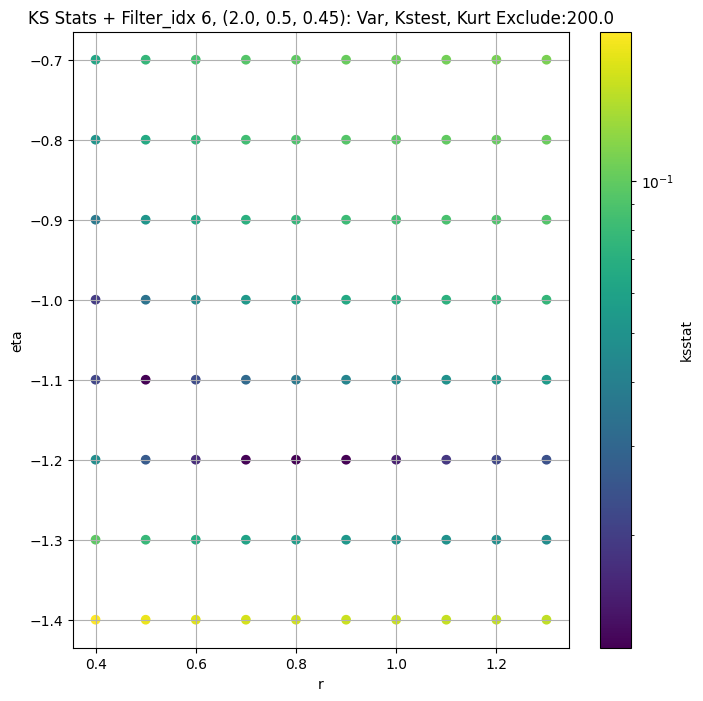

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.006877405292939065 76423.195


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.006107499078419565 73572.85


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.0061811977185065176 71612.375


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.007627181647400283 68459.414
Number of samples: 100000, Without approximation : 65536000.0


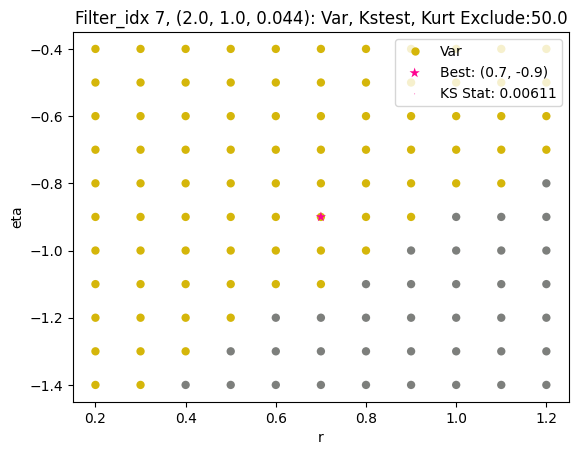

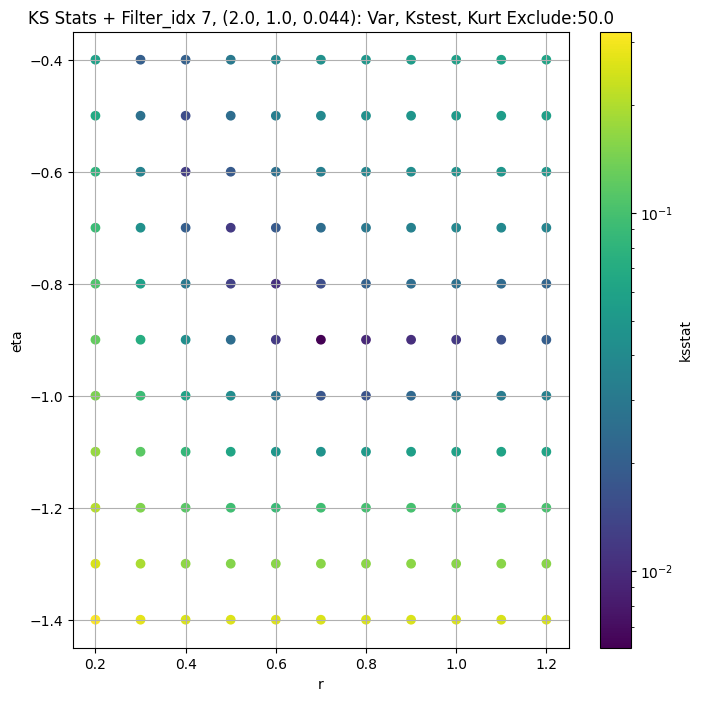

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.0042319935730710245 28467.82


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.003859120687796369 27089.27


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.0034857642581663795 26213.785


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.004733681931402889 24848.791
Number of samples: 100000, Without approximation : 65536000.0


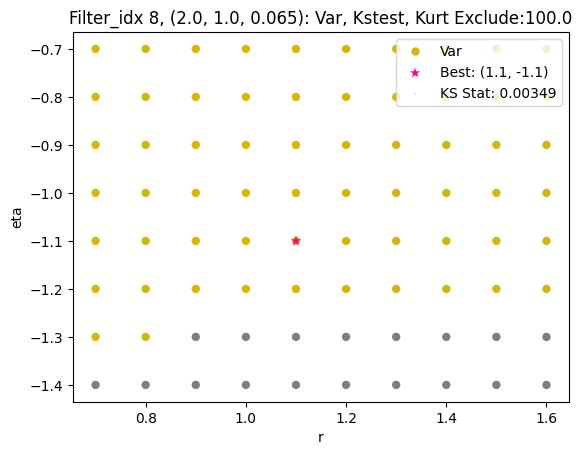

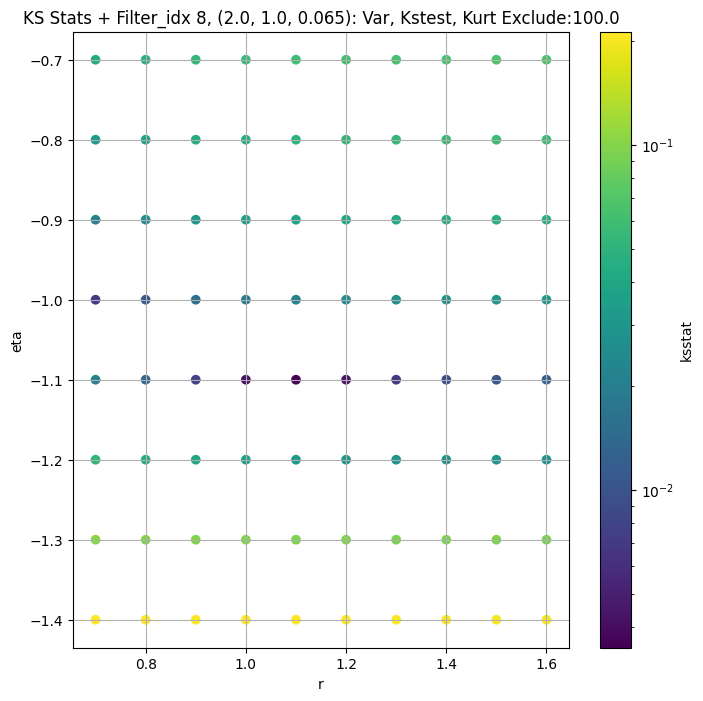

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.0035769741236502395 11275.832


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.003962673979804432 10685.757


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.003379431251290633 10313.786


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.004877542720222894 9734.004
Number of samples: 100000, Without approximation : 65536000.0


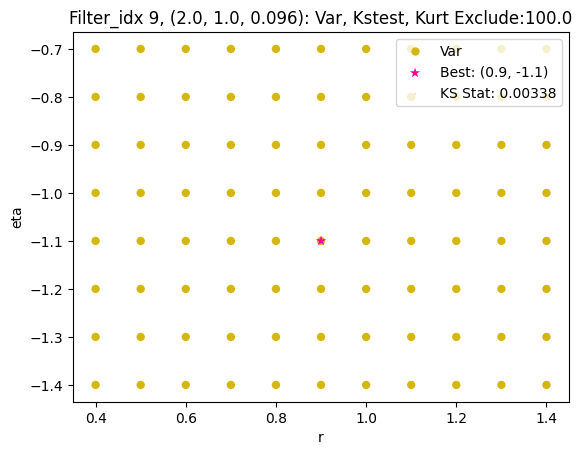

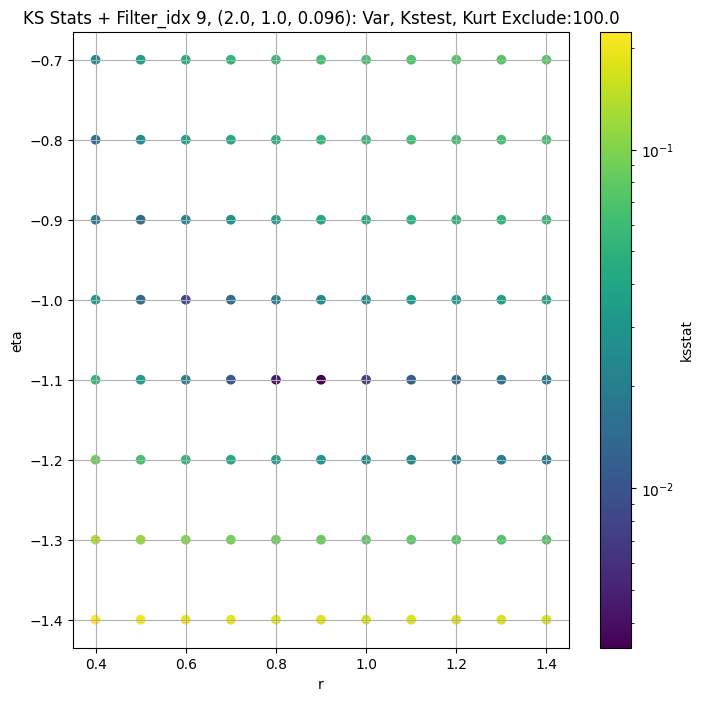

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.004529508292325124 4387.605


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.004717256151634652 4129.7764


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.005115935200046273 3968.928


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.004839851998998685 3723.82
Number of samples: 100000, Without approximation : 65536000.0


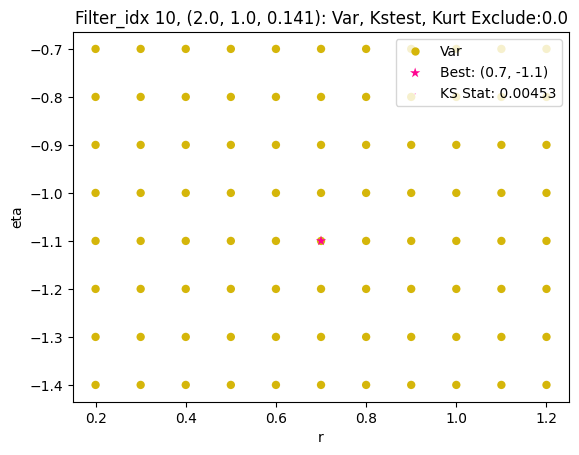

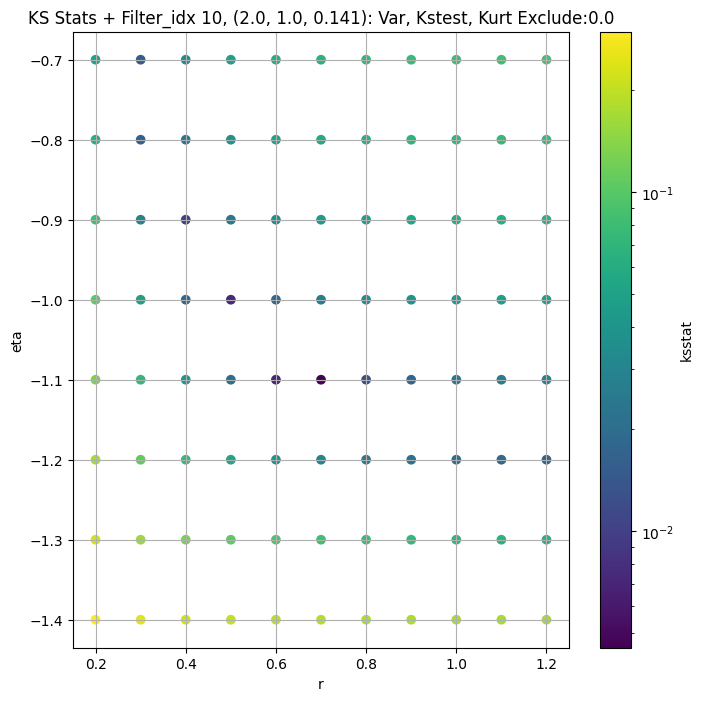

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.005735841833327426 1762.8989


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.00361003210688865 1650.4352


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.0037189562490590466 1580.8365


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.004911800728983673 1475.1118
Number of samples: 100000, Without approximation : 65536000.0


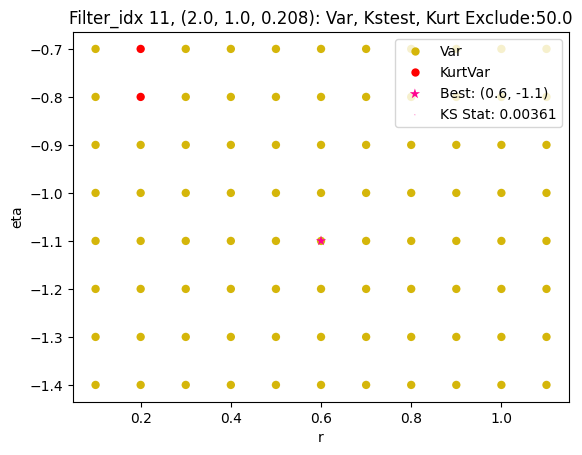

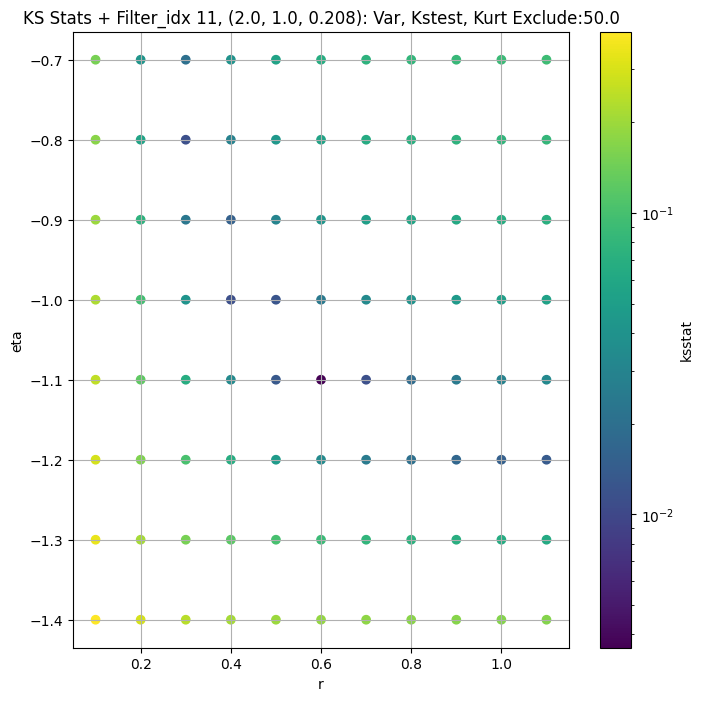

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.007329667219200697 745.6645


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.007328930320942284 694.4183


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.008068811300691925 662.7385


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.007432729972661534 615.50256
Number of samples: 100000, Without approximation : 65536000.0


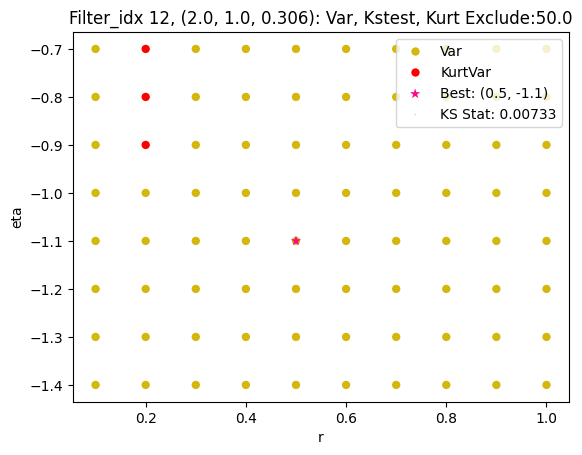

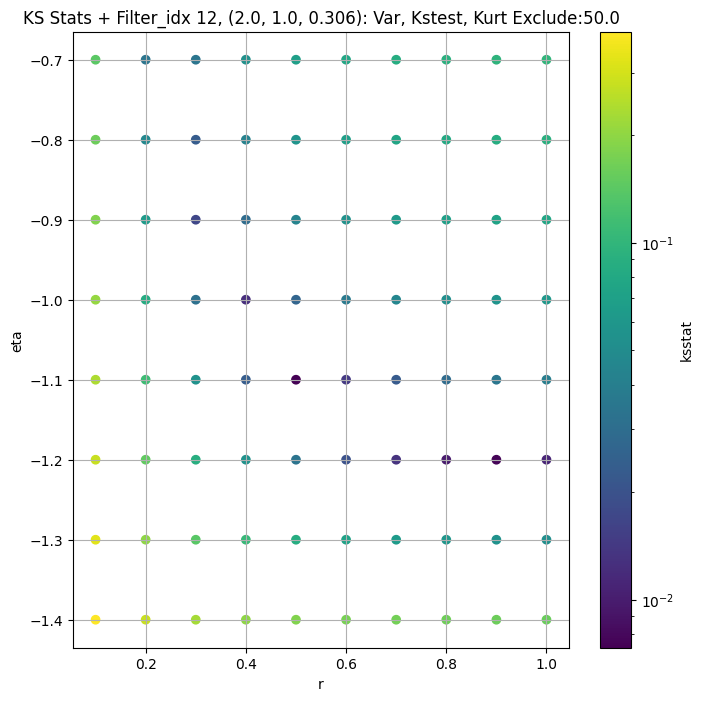

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.009853803150707385 384.10773


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.009841838815502546 356.88498


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.0098406597225148 340.03168


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.00981620091418367 314.6147
Number of samples: 100000, Without approximation : 65536000.0


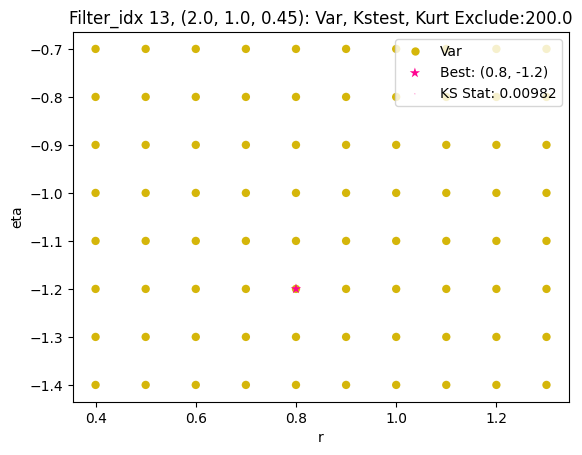

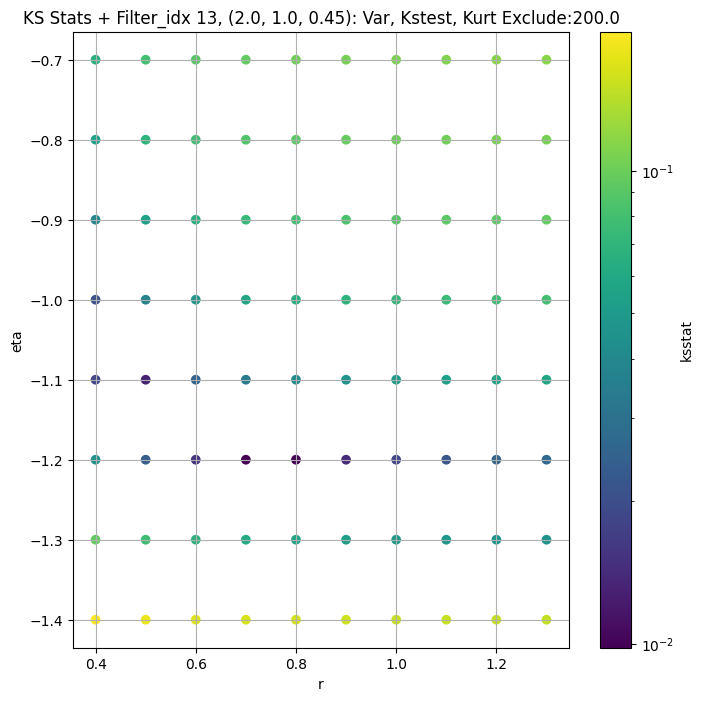

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.005292446901680958 51914.2


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.006758003949291824 49859.13


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.007900267351831358 48530.457


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.008415371602605956 46392.99
Number of samples: 100000, Without approximation : 65536000.0


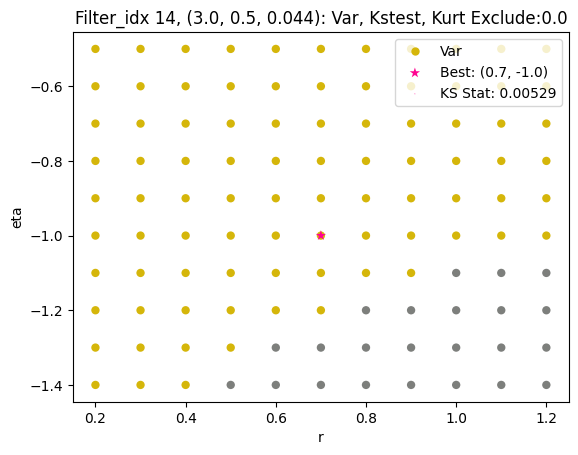

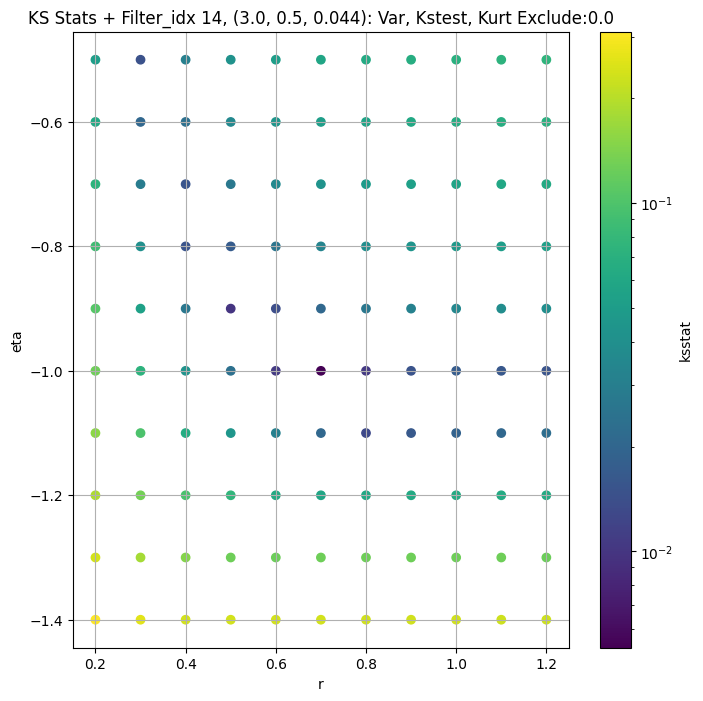

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.004826257806363143 20121.014


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.004921988674524813 19166.2


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.005491900365793945 18563.445


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.006645501466901696 17614.846
Number of samples: 100000, Without approximation : 65536000.0


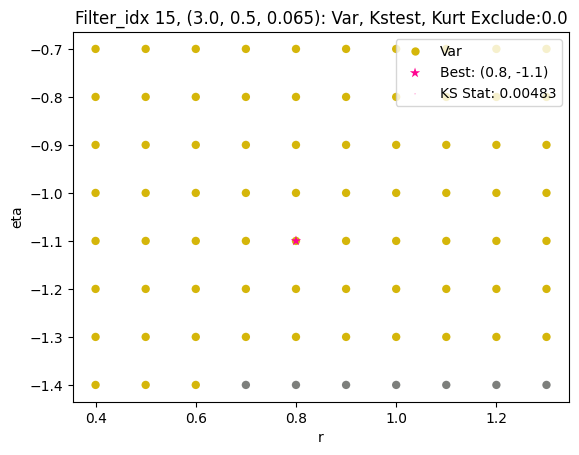

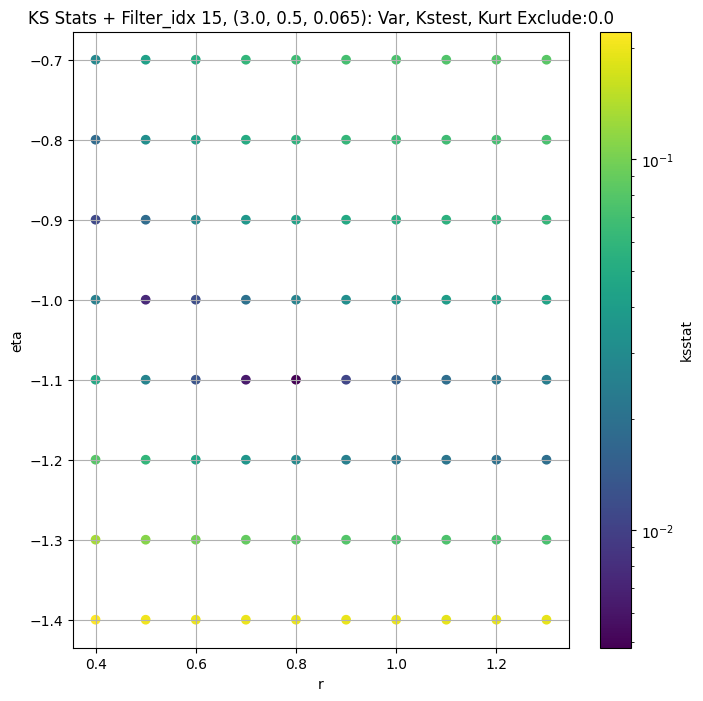

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.006488889443842849 7553.185


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.007161276064714839 7144.3457


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.007629477533182105 6888.434


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.006299935114499333 6487.4814
Number of samples: 100000, Without approximation : 65536000.0


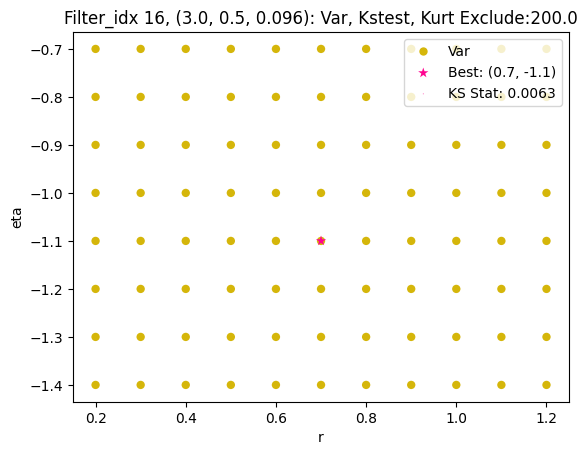

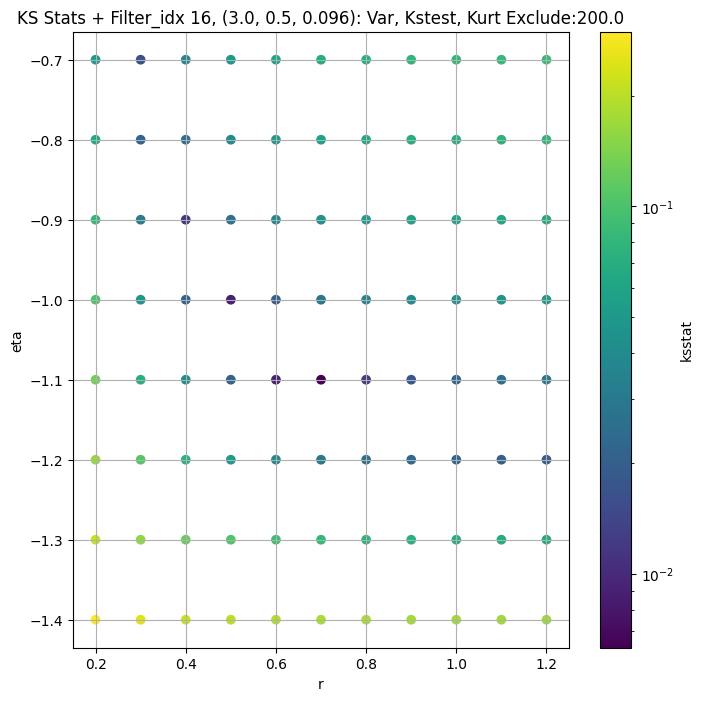

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.005623666491038126 2907.1948


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.006796310224544189 2718.1216


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.008557574721657024 2606.411


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.006351055408774689 2435.5723
Number of samples: 100000, Without approximation : 65536000.0


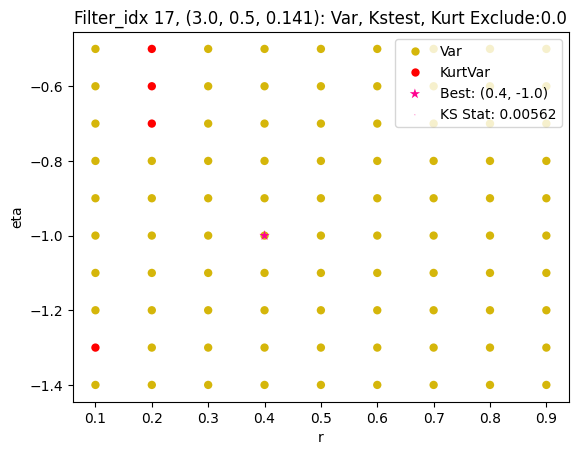

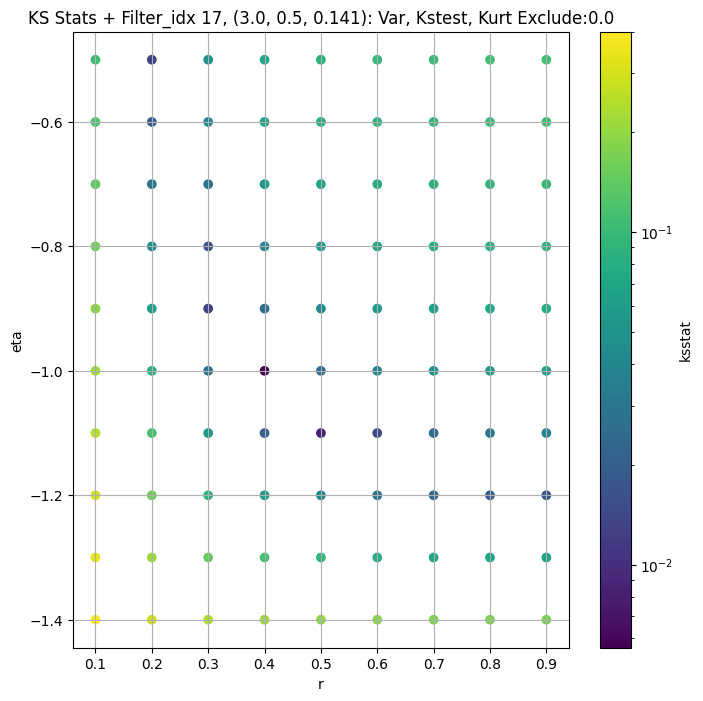

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.0074065554274240775 1239.65


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.004118865777518549 1150.7532


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.005449057656023659 1099.9714


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.007828302595560513 1023.9351
Number of samples: 100000, Without approximation : 65536000.0


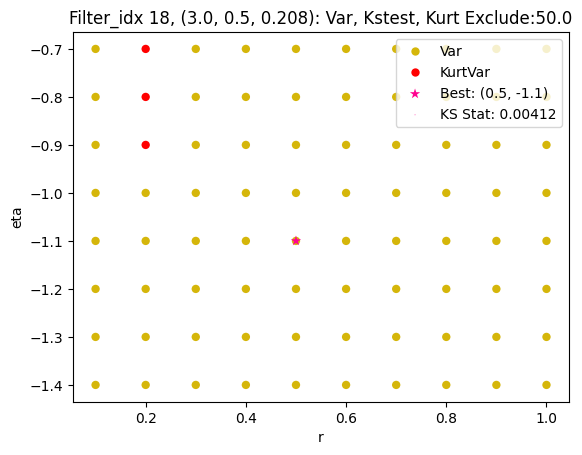

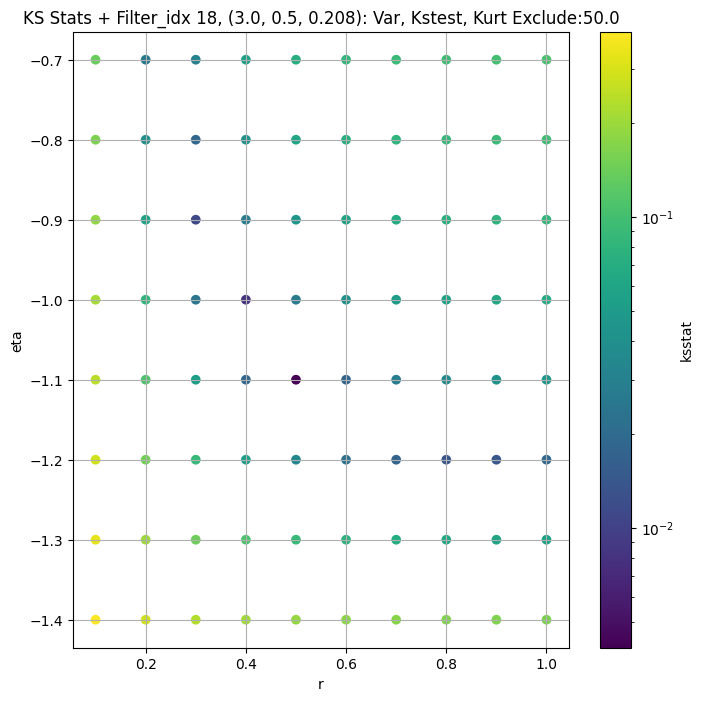

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.005568447903122942 561.3305


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.008919374163786284 520.8402


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.0077308154769648585 496.67957


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.008845931071186308 459.78802
Number of samples: 100000, Without approximation : 65536000.0


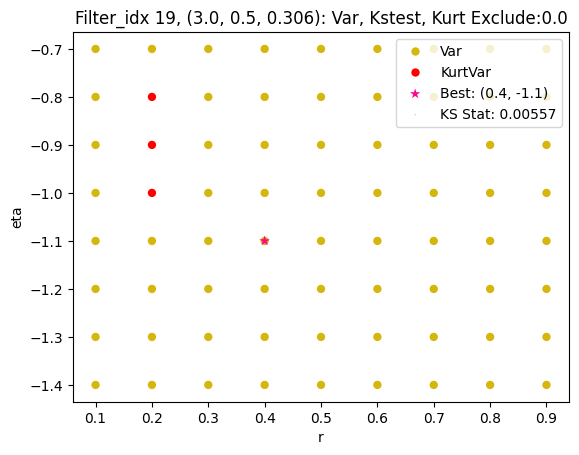

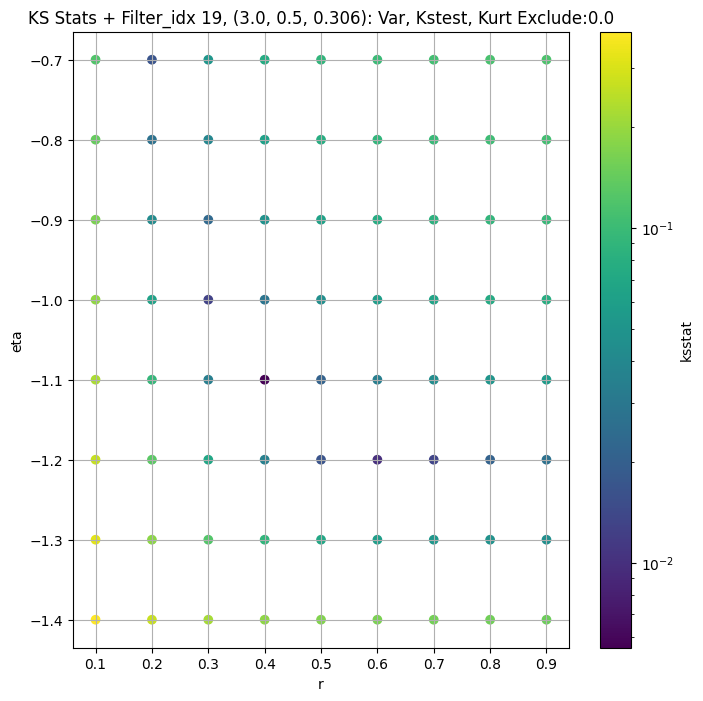

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.008983469058535698 284.76028


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.009523521300052518 264.98746


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.01039404261788257 252.70938


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.013117466048132867 233.27518
Number of samples: 100000, Without approximation : 65536000.0


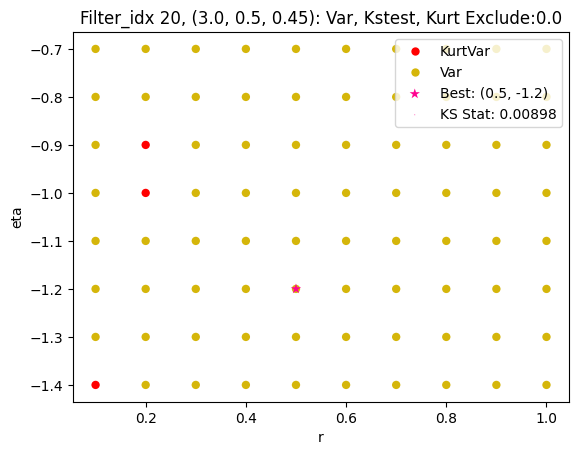

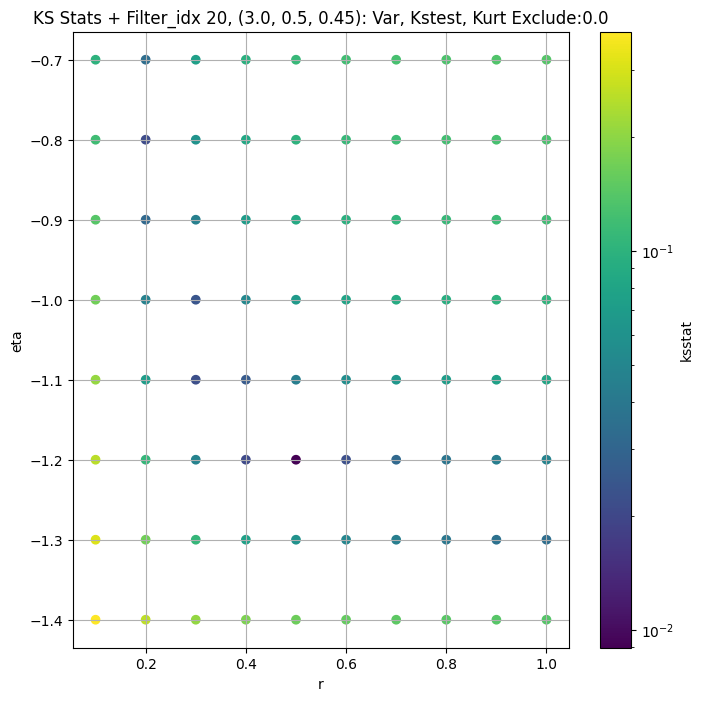

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.007179271162849221 61206.117


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.0035220374327487036 57780.953


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.005519138339882684 55547.105


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.006834647475664868 52089.96
Number of samples: 100000, Without approximation : 65536000.0


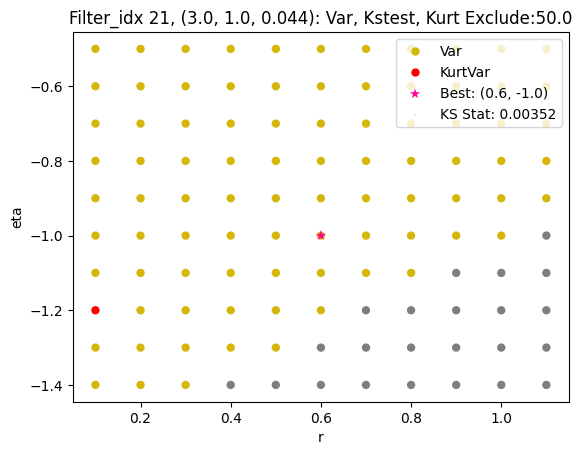

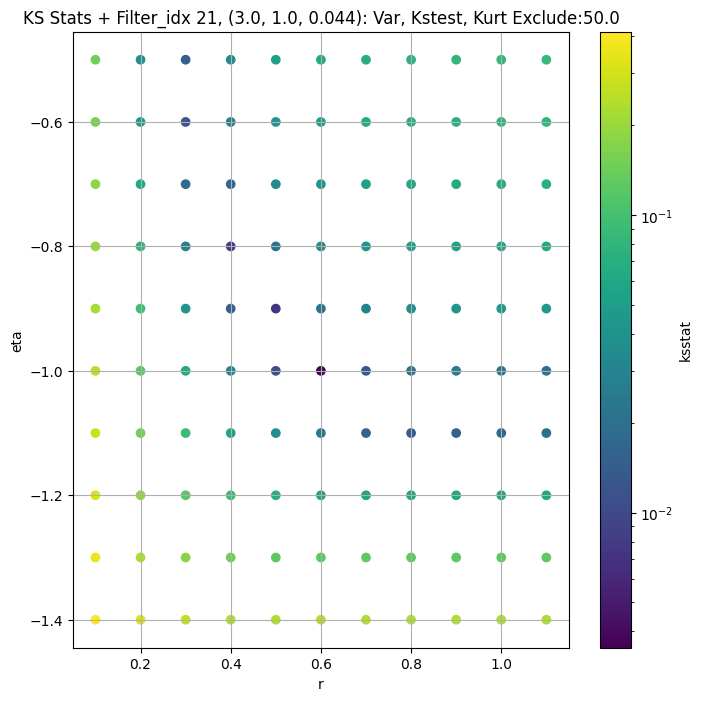

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.00421723267234253 22796.803


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.004789493175584525 21430.018


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.0070811372599624 20518.146


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.007120958146692891 19120.65
Number of samples: 100000, Without approximation : 65536000.0


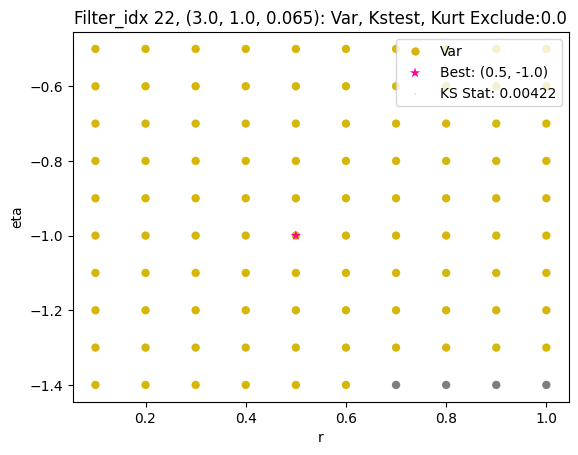

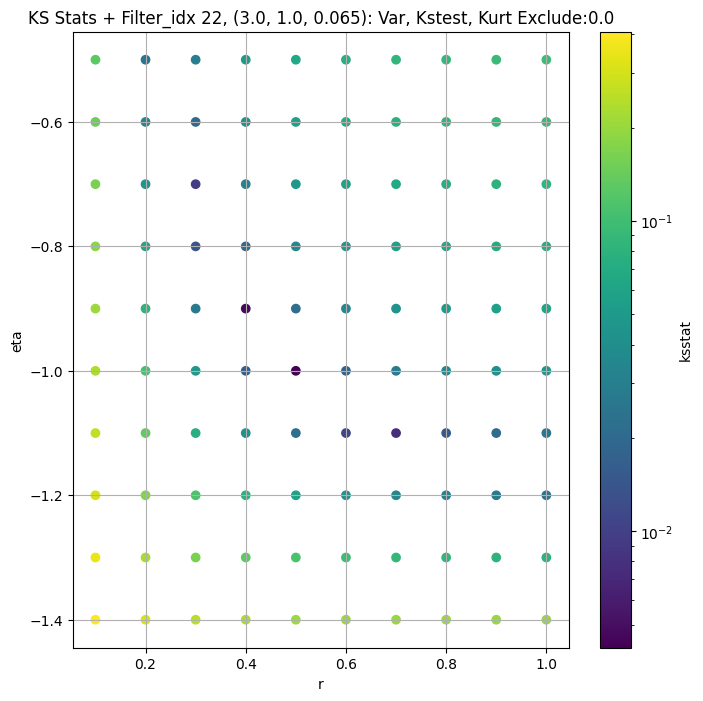

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.0049700280749803705 9137.883


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.006162853708212457 8428.258


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.008136782990864871 7998.495


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.009308663628341929 7354.6978
Number of samples: 100000, Without approximation : 65536000.0


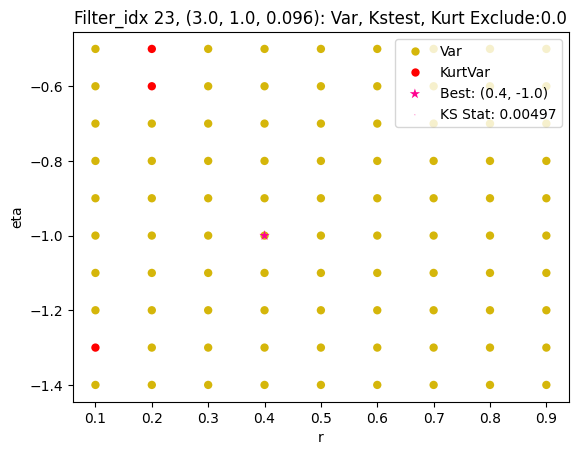

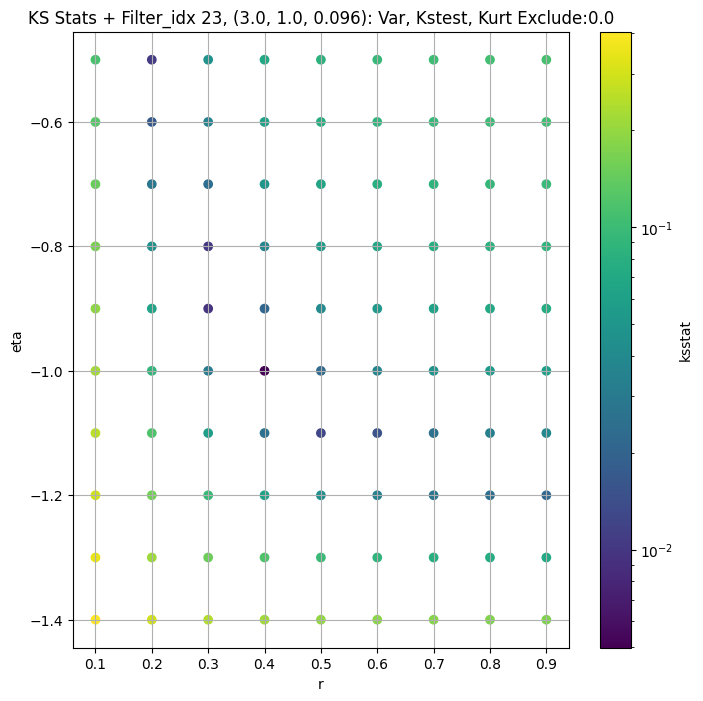

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.004919393509625045 3432.6167


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.00777687933767901 3137.492


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.005594923542571073 2962.6367


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.009348134320583346 2707.017
Number of samples: 100000, Without approximation : 65536000.0


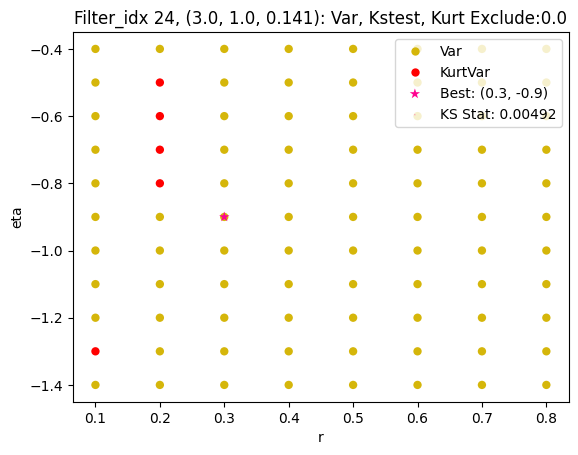

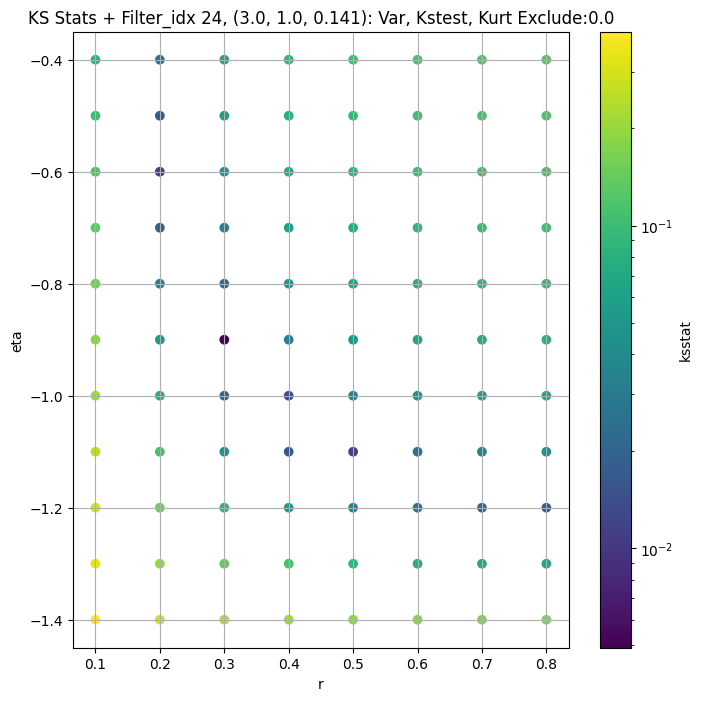

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.009277045294420583 1459.5114


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.00586162764428233 1312.5747


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.007972986113229857 1234.747


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.005607093005432273 1123.7249
Number of samples: 100000, Without approximation : 65536000.0


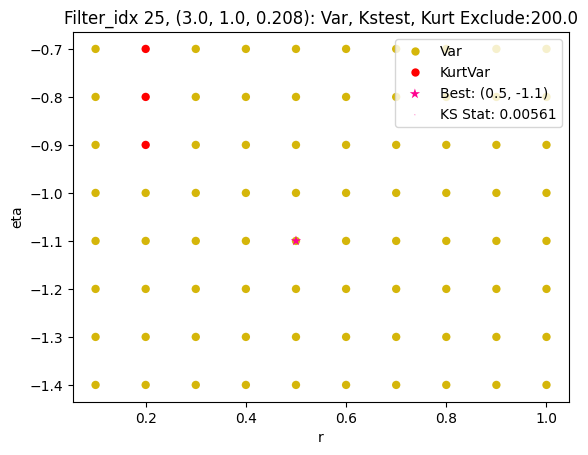

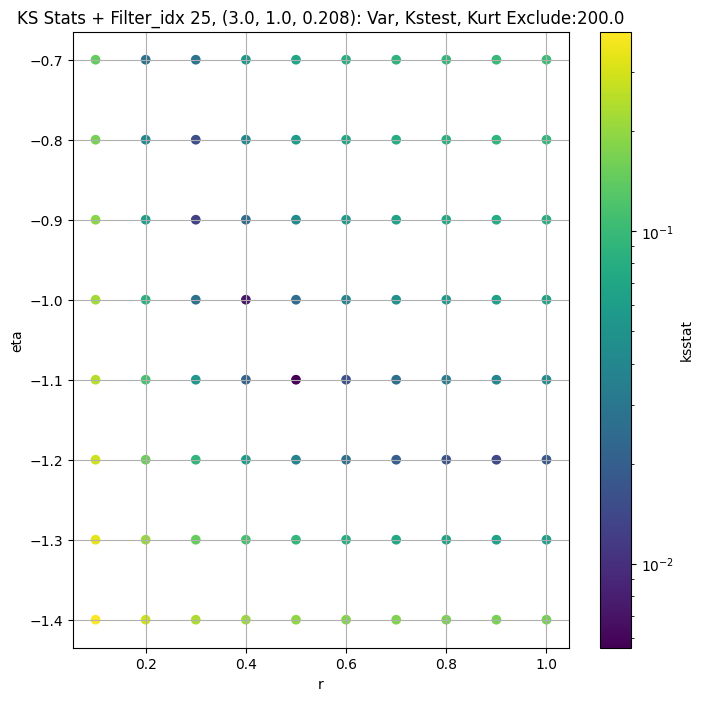

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.004459014985431331 652.549


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.005506551379832483 590.7748


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.00828152227319899 555.4567


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.008955794834407227 505.0183
Number of samples: 100000, Without approximation : 65536000.0


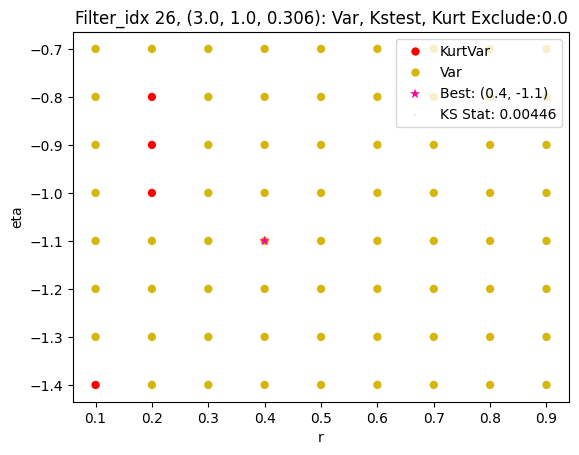

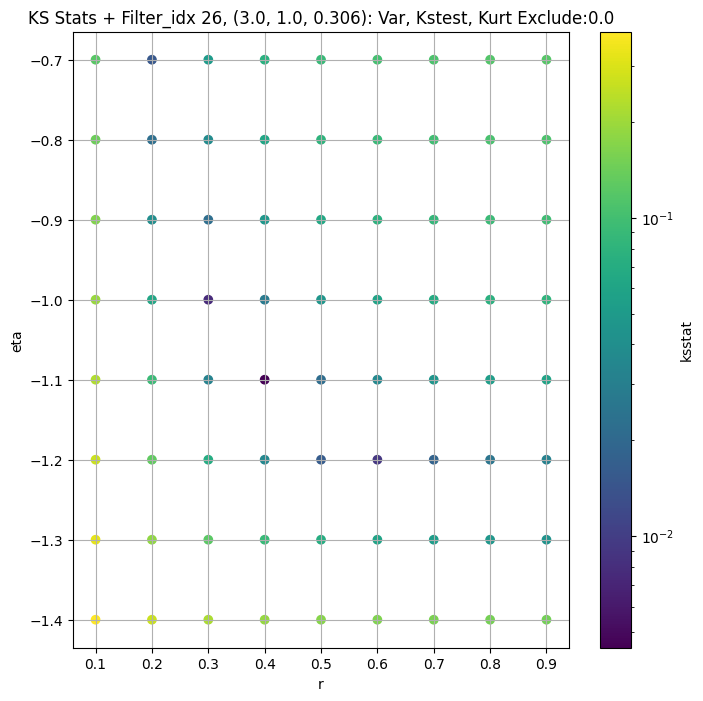

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.012811253643111975 318.5771


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.009562647515941325 285.86374


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.009946693866120015 267.4589


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.011854281316226012 241.91766
Number of samples: 100000, Without approximation : 65536000.0


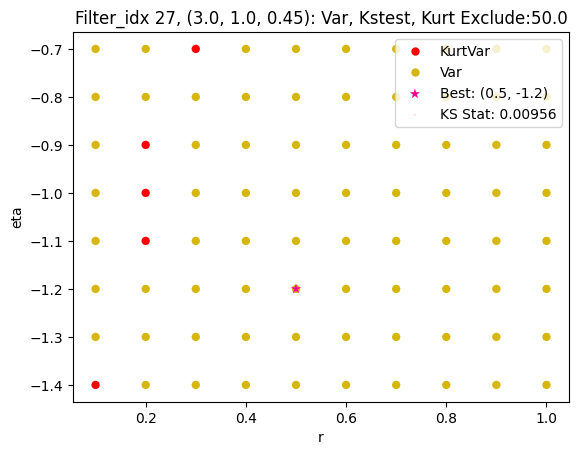

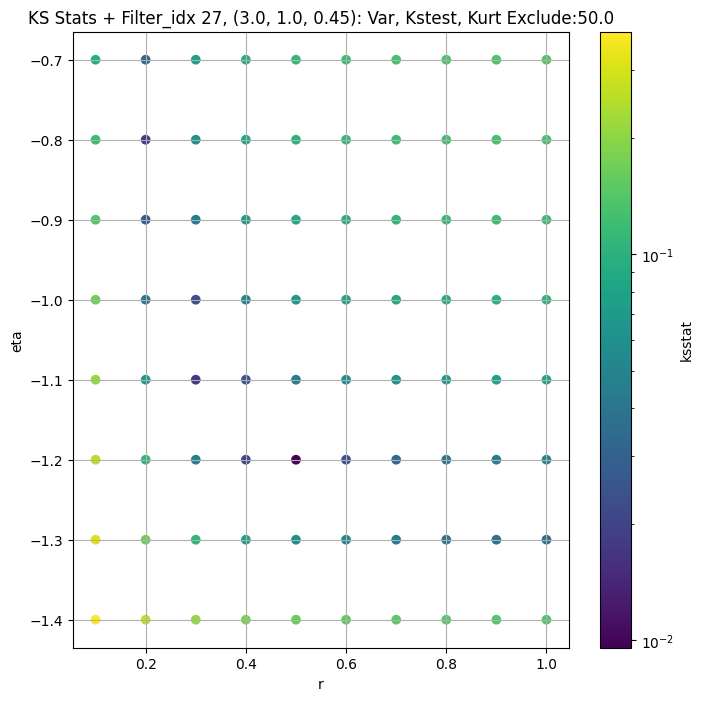

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.003935709652842623 50571.727


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.0041769216654551355 48187.176


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.005979100294554909 46806.68


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.006973230313442991 44626.965
Number of samples: 100000, Without approximation : 65536000.0


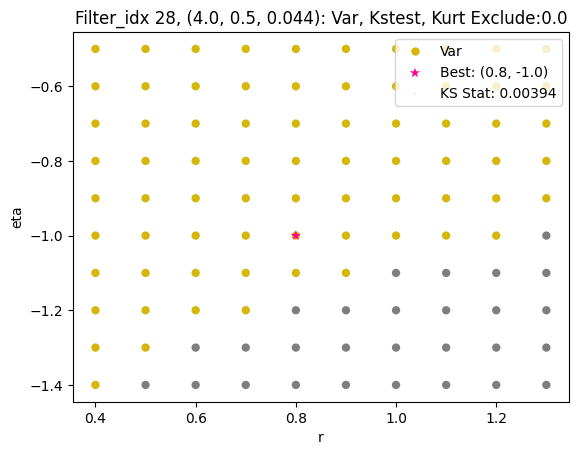

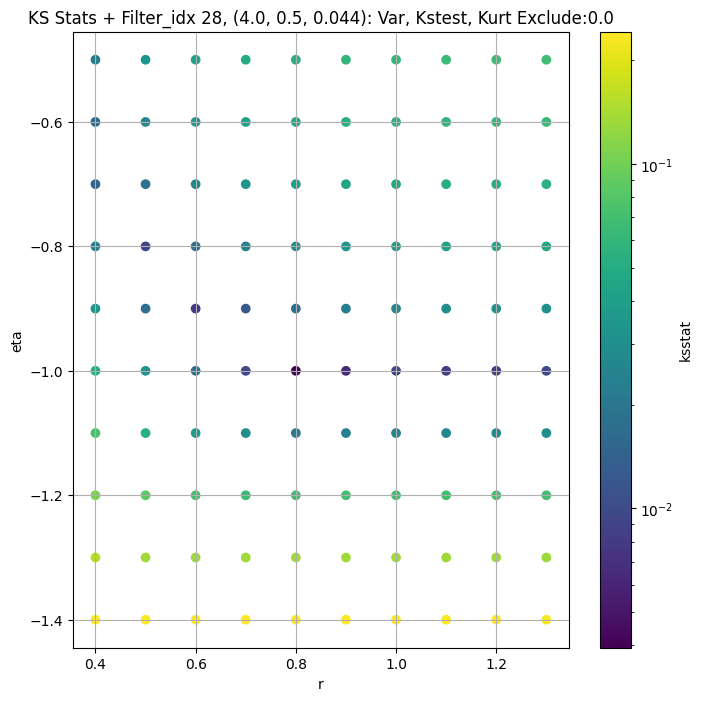

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.0059317817495561365 18909.94


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.005486966729556175 17777.54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.0048881815520838146 17157.998


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.005069045729136579 16211.289
Number of samples: 100000, Without approximation : 65536000.0


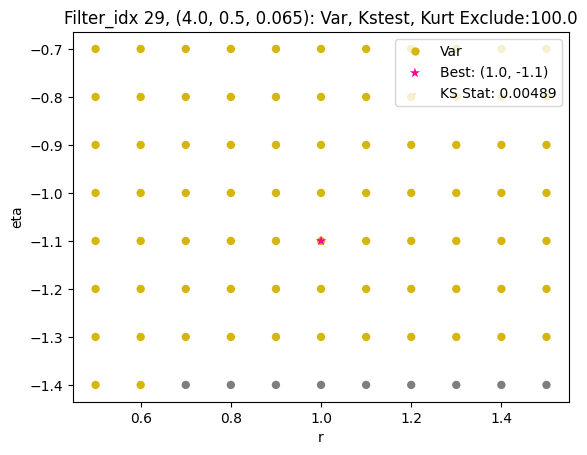

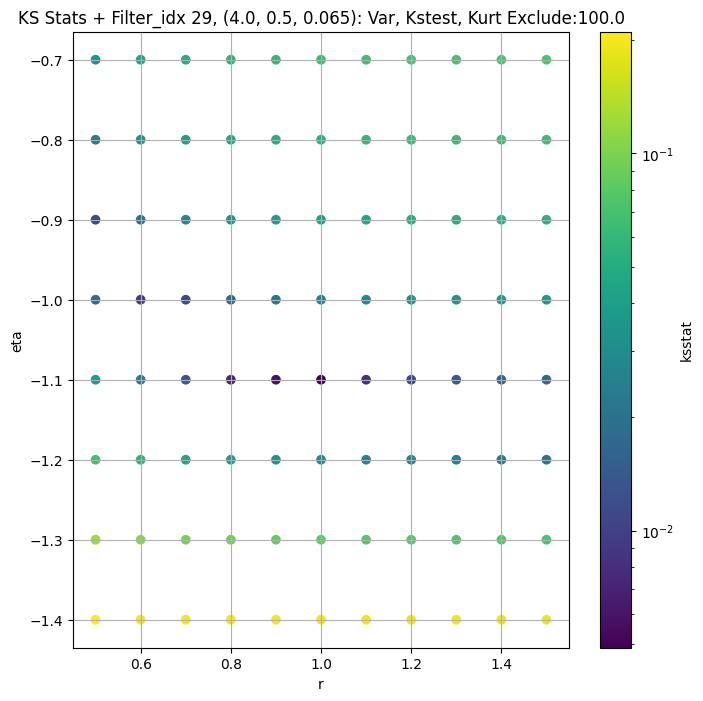

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.007428080563394279 6842.406


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.006384712727331432 6417.031


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.006813849387381055 6174.2354


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.00622169514405746 5802.0435
Number of samples: 100000, Without approximation : 65536000.0


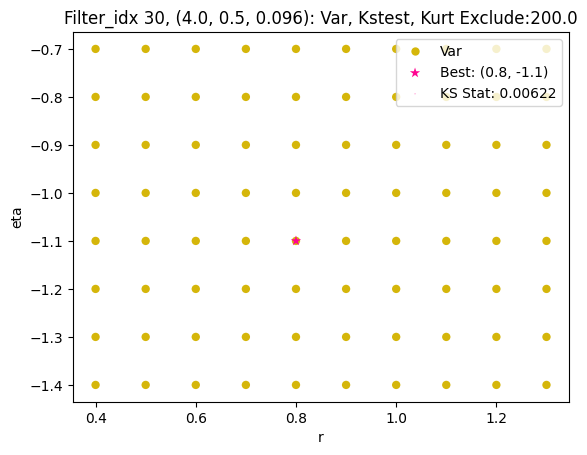

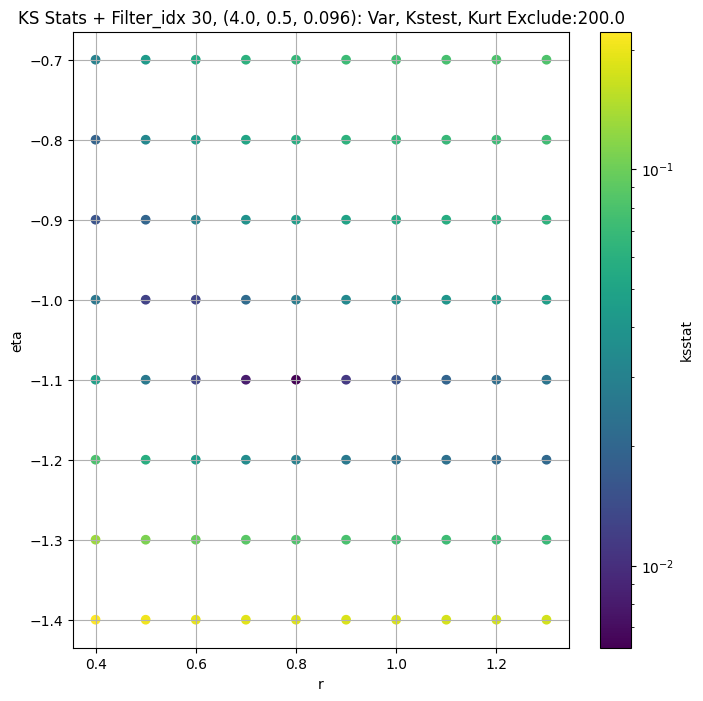

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.007319738232085801 2787.0925


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.008608294416955153 2589.2925


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.006365773208358461 2479.4458


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.00861148970177783 2312.9907
Number of samples: 100000, Without approximation : 65536000.0


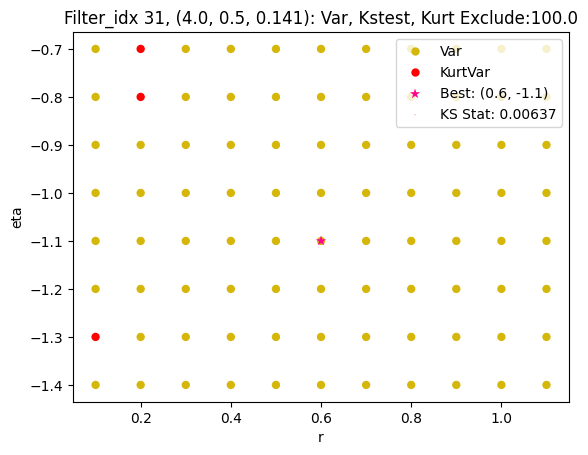

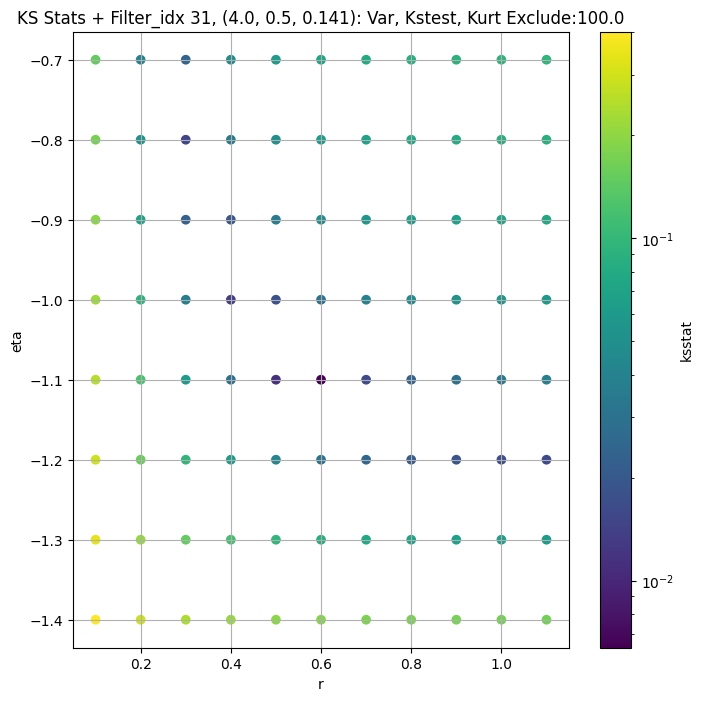

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.007785103470921817 1247.4126


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.00522496482196718 1152.6631


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.007024817215511667 1099.909


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.010052419868367246 1021.7184
Number of samples: 100000, Without approximation : 65536000.0


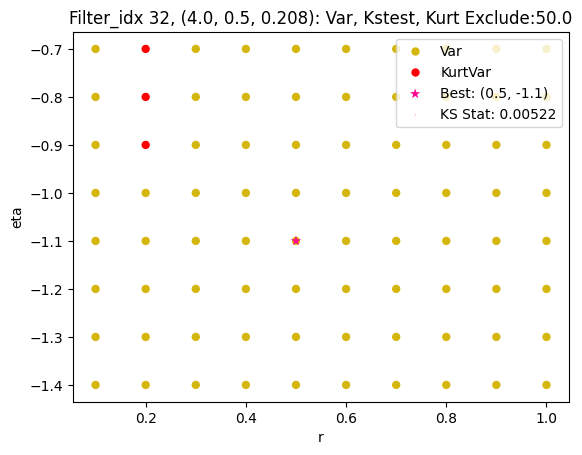

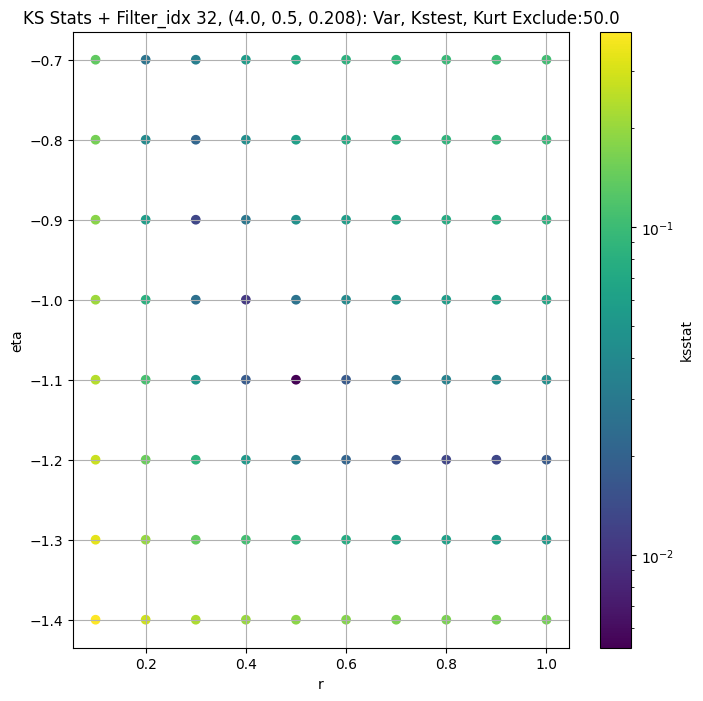

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.00553965714653204 554.5676


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.008909897483714069 508.5315


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.009061375753481093 483.65775


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.00929429455447589 446.91937
Number of samples: 100000, Without approximation : 65536000.0


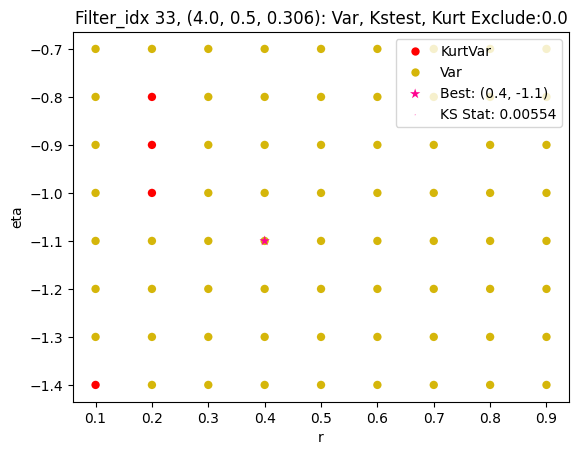

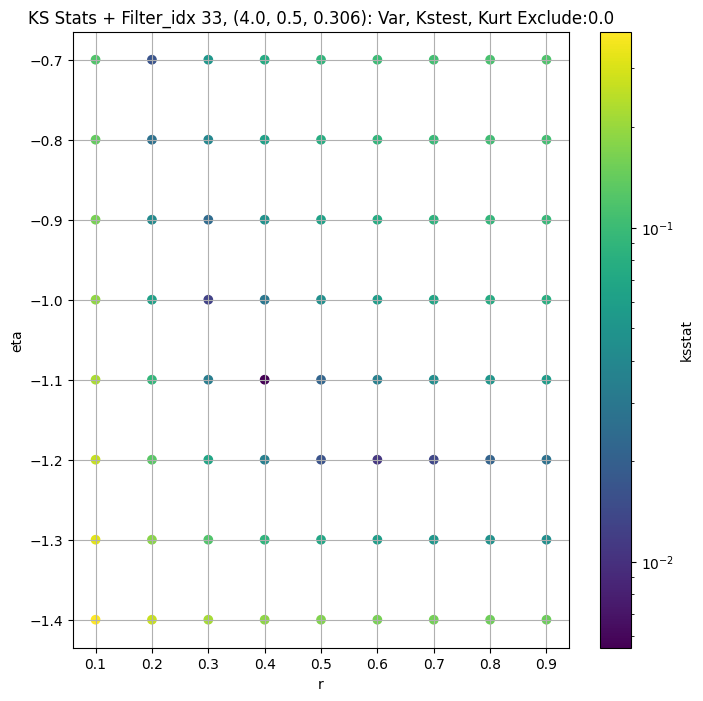

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.01824971332958869 266.8606


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.014963387578043608 246.27649


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.012925921009288188 234.34134


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.013014463773125498 216.5533
Number of samples: 100000, Without approximation : 65536000.0


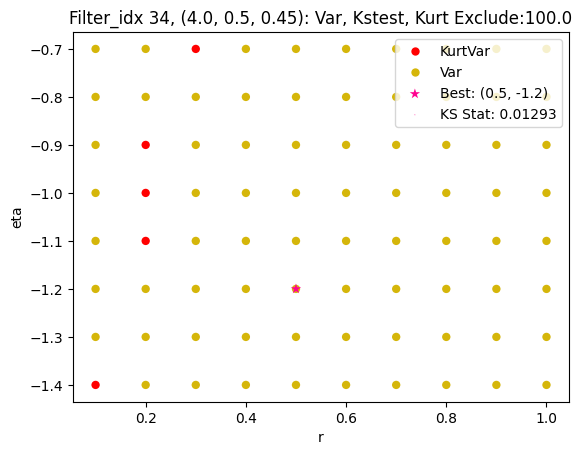

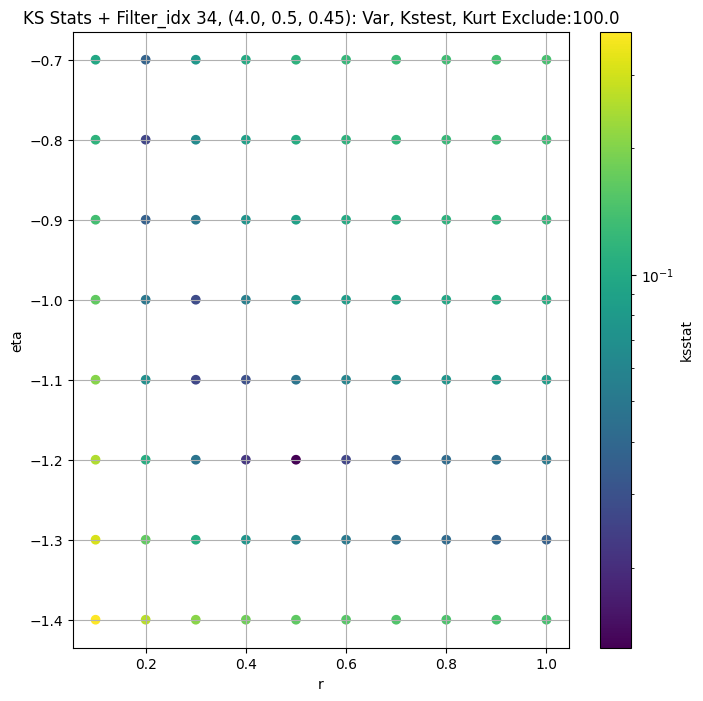

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.003819498969161894 57588.613


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.0026600028464296432 53433.11


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.0030313352258914683 51177.24


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.003843336925517353 47752.13
Number of samples: 100000, Without approximation : 65536000.0


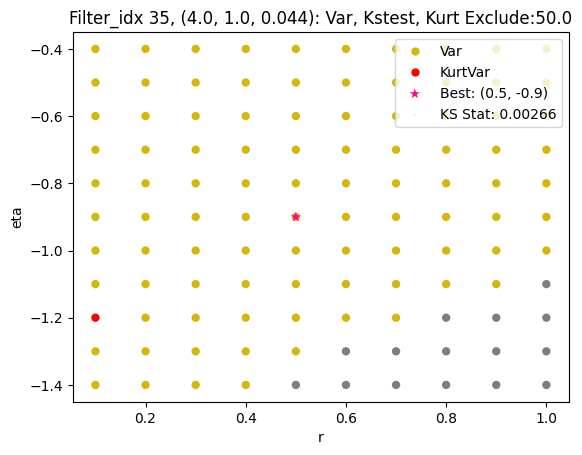

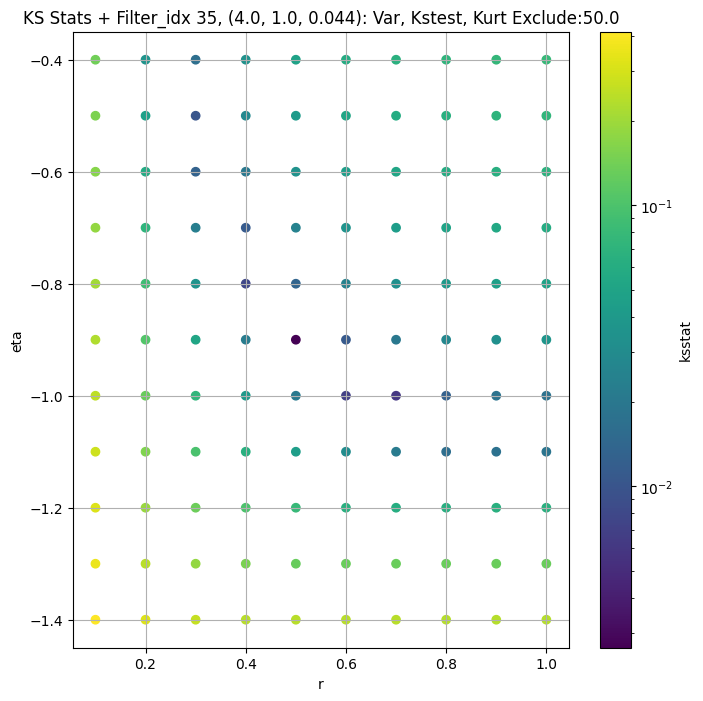

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.007102000112155504 21983.225


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.0042685249618136245 20370.69


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.002849000988340719 19405.35


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.006548689444260181 17954.871
Number of samples: 100000, Without approximation : 65536000.0


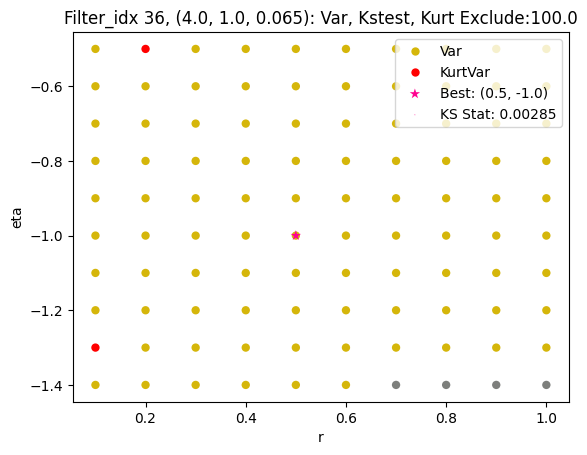

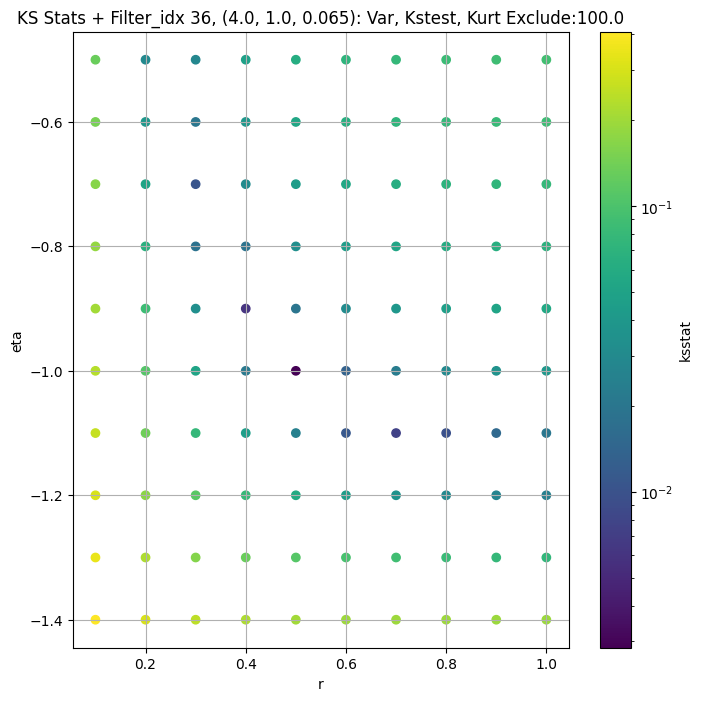

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.004025991213757241 7936.631


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.006223517280665503 7251.352


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.008317366426933481 6850.9966


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.007246165044790254 6264.643
Number of samples: 100000, Without approximation : 65536000.0


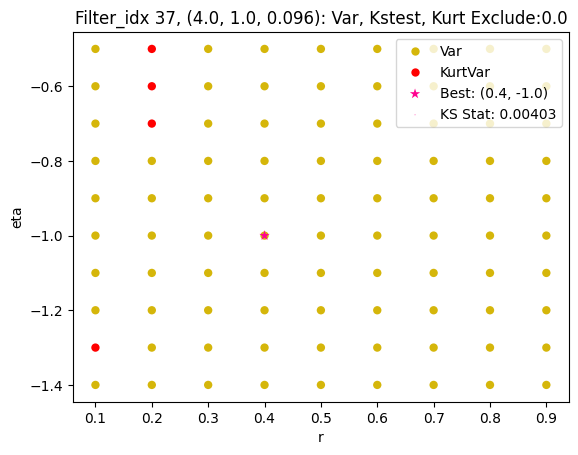

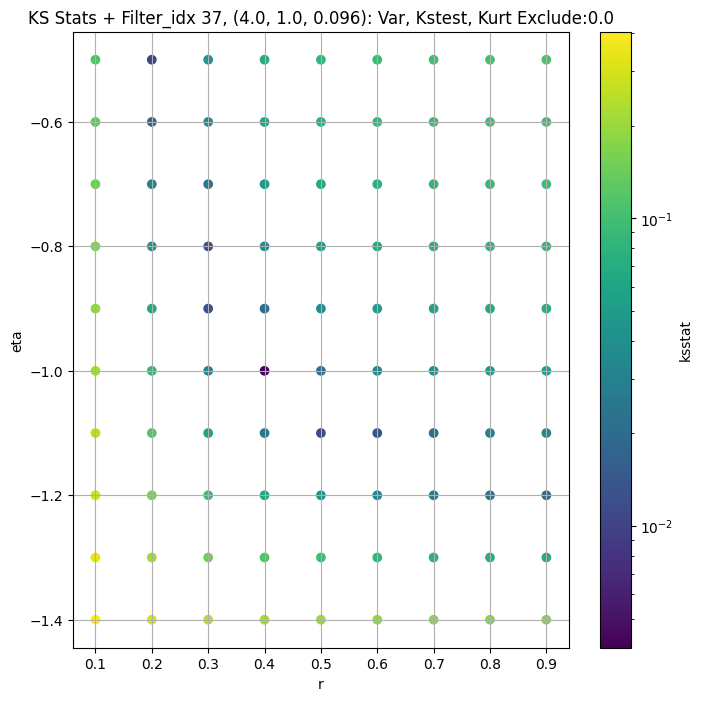

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.0031242642625103345 3282.5146


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.0029800105536333388 2922.5085


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.0030762452699423237 2739.683


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.006656563563972373 2481.825
Number of samples: 100000, Without approximation : 65536000.0


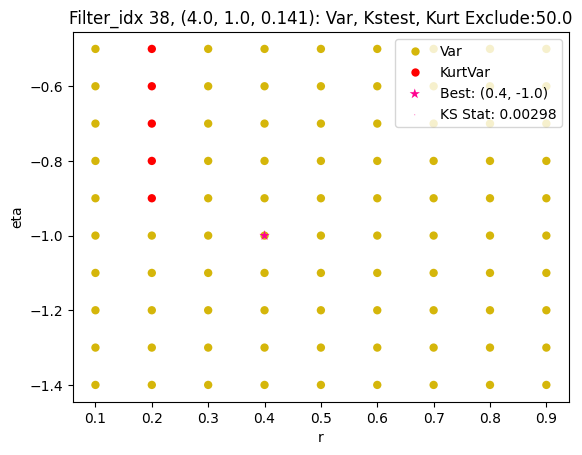

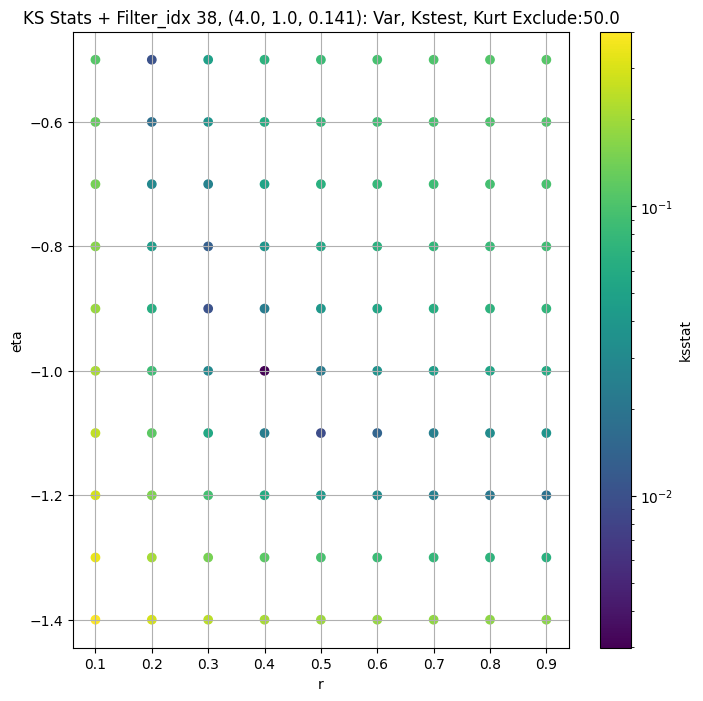

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.0063955227364107525 1444.2435


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.009604478601560107 1271.3444


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.007757396085008805 1189.5784


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.004323724168814106 1075.7335
Number of samples: 100000, Without approximation : 65536000.0


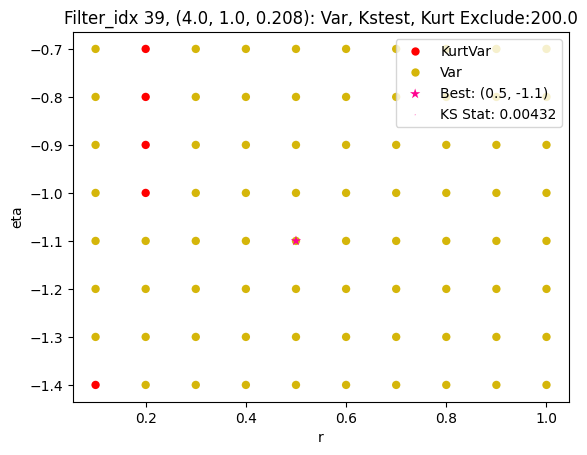

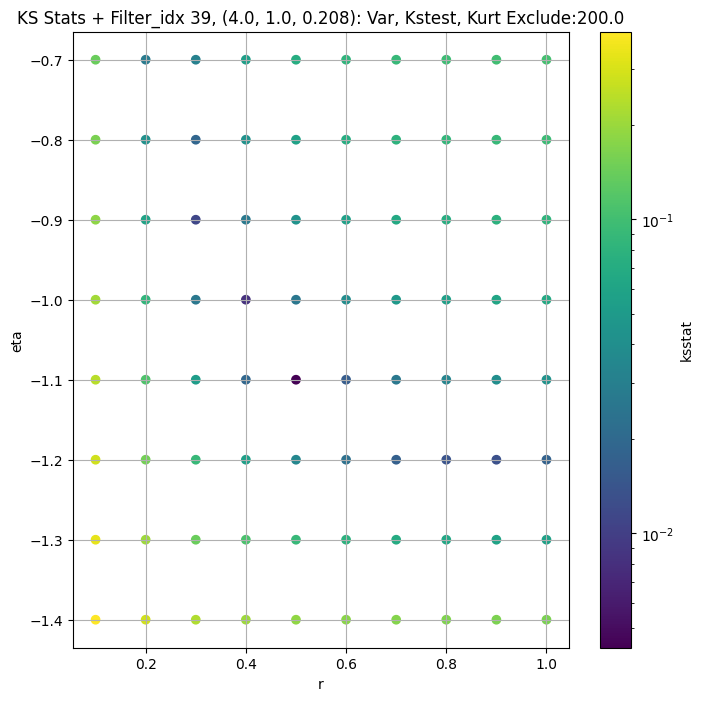

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.006390583906275171 636.5207


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.0038602543138211987 567.8215


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.0073625231036840155 531.1715


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.008949461508897194 480.2163
Number of samples: 100000, Without approximation : 65536000.0


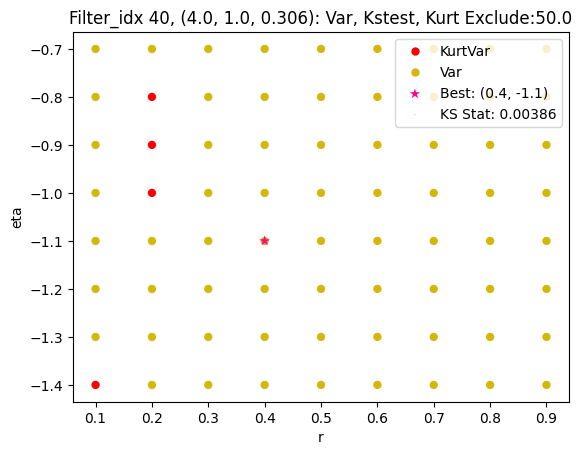

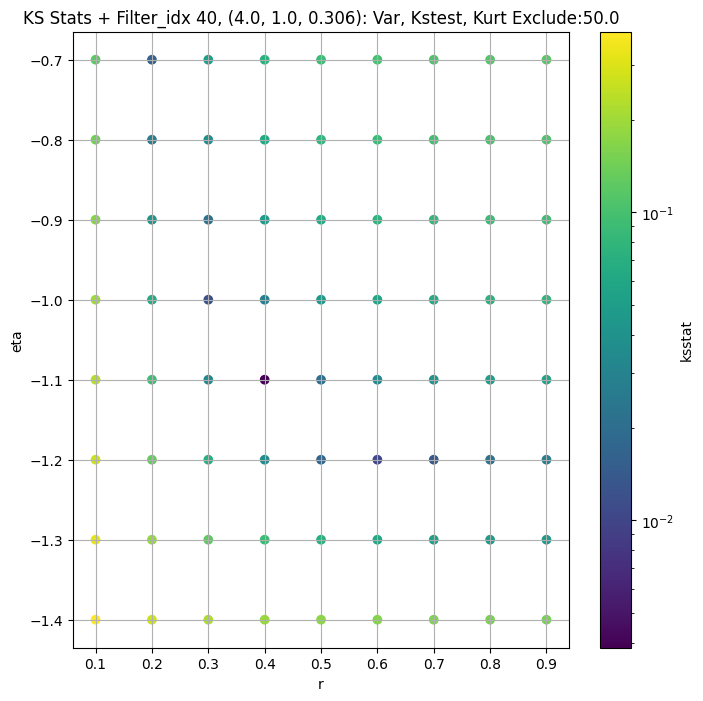

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.010582155418118855 288.79776


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.012415765813157231 255.75136


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.014423087329712828 237.91803


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.0151201864217696 213.88382
Number of samples: 100000, Without approximation : 65536000.0


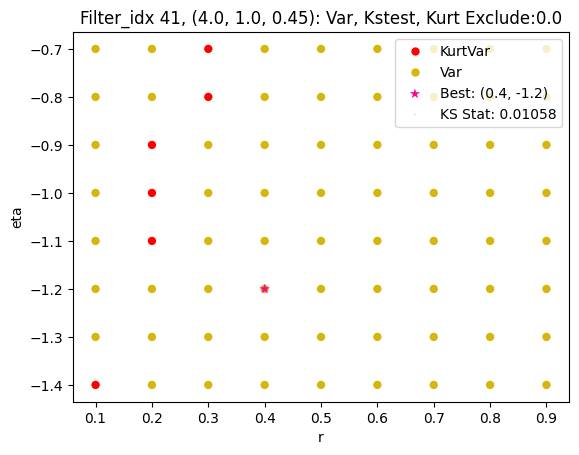

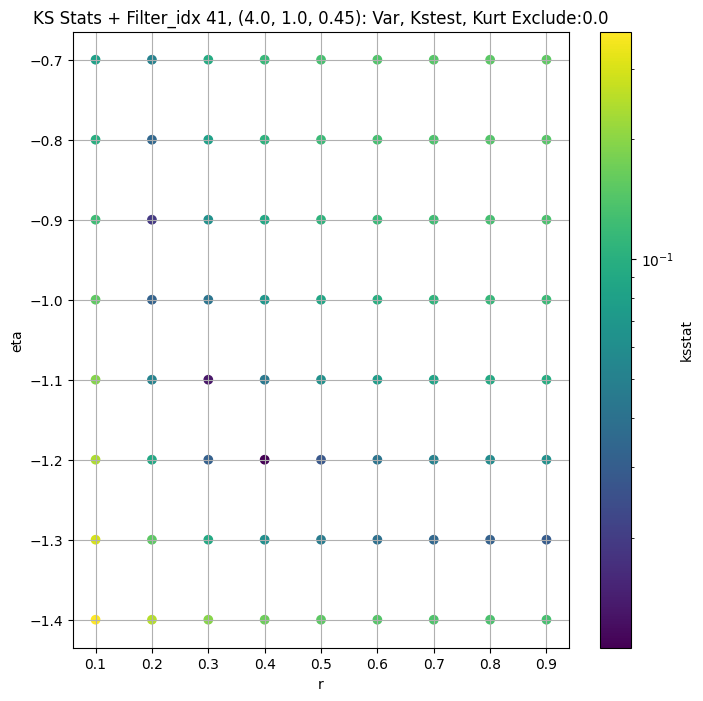

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",53968.47700,42842.63700,65663.23400,4.529419,2.671541,9.929728,65536000.0,"(2.0, 0.5, 0.044)",0.007355,0.8,-1.0,81198.947855,0.0,53968.47700,0.000168
1,"(2.0, 0.5, 0.065)",20821.29500,16402.21900,26296.40400,5.743000,3.342600,14.397355,65536000.0,"(2.0, 0.5, 0.065)",0.003834,0.9,-1.1,46660.567701,0.0,20821.29500,0.000168
2,"(2.0, 0.5, 0.096)",7666.59000,6005.21500,9682.26800,7.084080,3.844694,16.008696,65536000.0,"(2.0, 0.5, 0.096)",0.004428,0.8,-1.1,14162.766920,50.0,7343.75600,0.000168
3,"(2.0, 0.5, 0.141)",3192.91380,2420.70830,4104.83300,8.654820,4.767221,21.822508,65536000.0,"(2.0, 0.5, 0.141)",0.004365,0.6,-1.1,3631.311098,0.0,3192.91380,0.000168
4,"(2.0, 0.5, 0.208)",1371.63120,1016.44110,1742.18730,9.491283,5.425109,24.351202,65536000.0,"(2.0, 0.5, 0.208)",0.005394,0.6,-1.1,1477.715316,50.0,1299.31520,0.000168
5,"(2.0, 0.5, 0.306)",537.38885,396.54030,695.85910,10.527098,5.672311,24.628796,65536000.0,"(2.0, 0.5, 0.306)",0.009254,0.8,-1.2,1420.792471,0.0,537.38885,0.000168
6,"(2.0, 0.5, 0.45)",364.30988,267.56274,482.30508,10.603776,6.072431,26.286480,65536000.0,"(2.0, 0.5, 0.45)",0.011956,0.8,-1.2,821.215763,200.0,310.60990,0.000168
7,"(2.0, 1.0, 0.044)",76423.19500,61806.15600,95057.44500,5.325180,3.042860,11.335867,65536000.0,"(2.0, 1.0, 0.044)",0.006107,0.7,-0.9,70326.058944,50.0,73572.85000,0.000168
8,"(2.0, 1.0, 0.065)",28467.82000,21926.42800,36817.16400,7.597873,3.740597,19.843456,65536000.0,"(2.0, 1.0, 0.065)",0.003486,1.1,-1.1,71116.981263,100.0,26213.78500,0.000168


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.00785389170843838, var: 50966.5390625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.007629772854035766, var: 51539.32421875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.007240577089208555, var: 52171.19921875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.006790796375307995, var: 52906.078125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.005743335931561566, var: 53968.4765625
Number of samples: 100000, Without approximation : 65536000.0


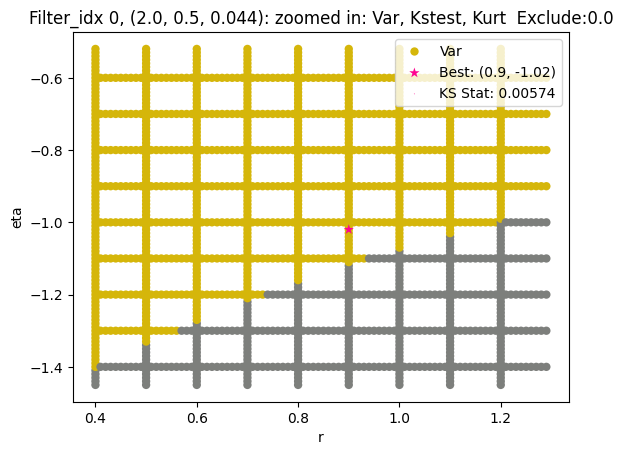

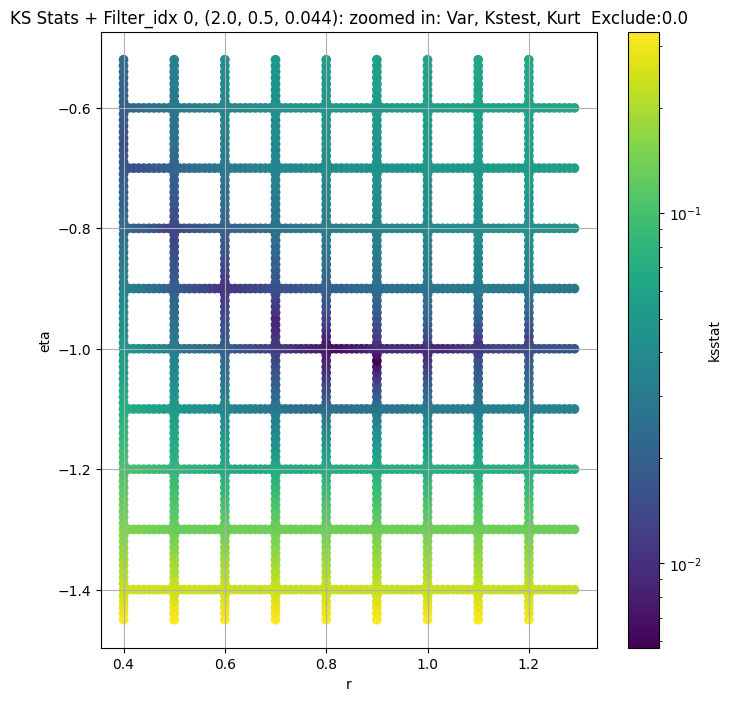

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 100 = 100, ksstat: 0.004447035209690697, var: 19518.396484375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 75 = 75, ksstat: 0.004332989725911451, var: 19767.990234375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 50 = 50, ksstat: 0.004288566250115977, var: 20042.849609375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 25 = 25, ksstat: 0.0038573574127007057, var: 20360.162109375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 0 = 0, ksstat: 0.003259955051662211, var: 20821.294921875
Number of samples: 100000, Without approximation : 65536000.0


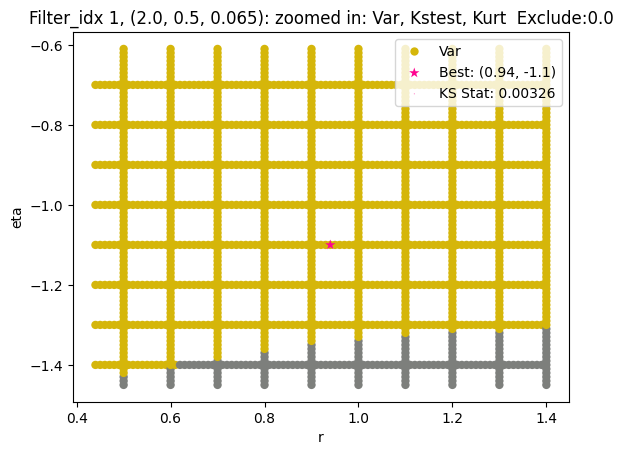

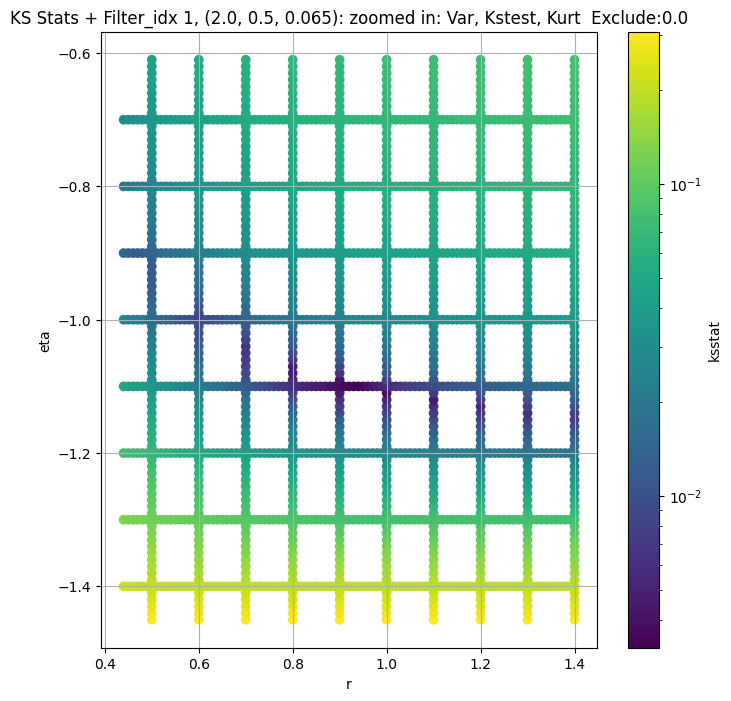

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 100 = 150, ksstat: 0.005631955828120656, var: 6941.279296875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 75 = 125, ksstat: 0.005245799789156125, var: 7031.67333984375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 50 = 100, ksstat: 0.005118195436883646, var: 7127.63525390625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 25 = 75, ksstat: 0.004772144541563855, var: 7230.4501953125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 0 = 50, ksstat: 0.00439372561752982, var: 7343.755859375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + -25 = 25, ksstat: 0.004096791535641131, var: 7474.6728515625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + -50 = 0, ksstat: 0.003934078968447323, var: 7666.58984375
Number of samples: 100000, Without approximation : 65536000.0


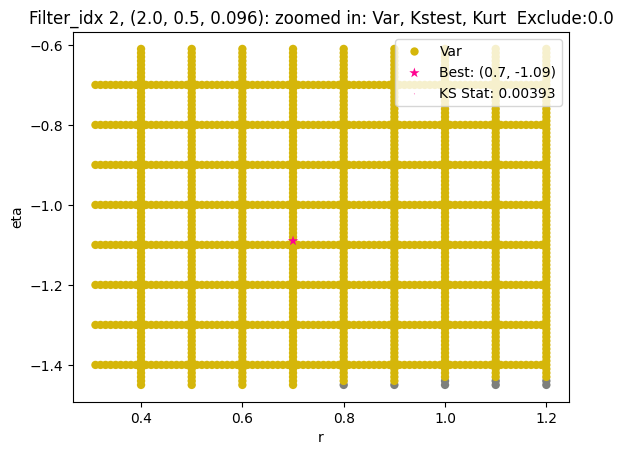

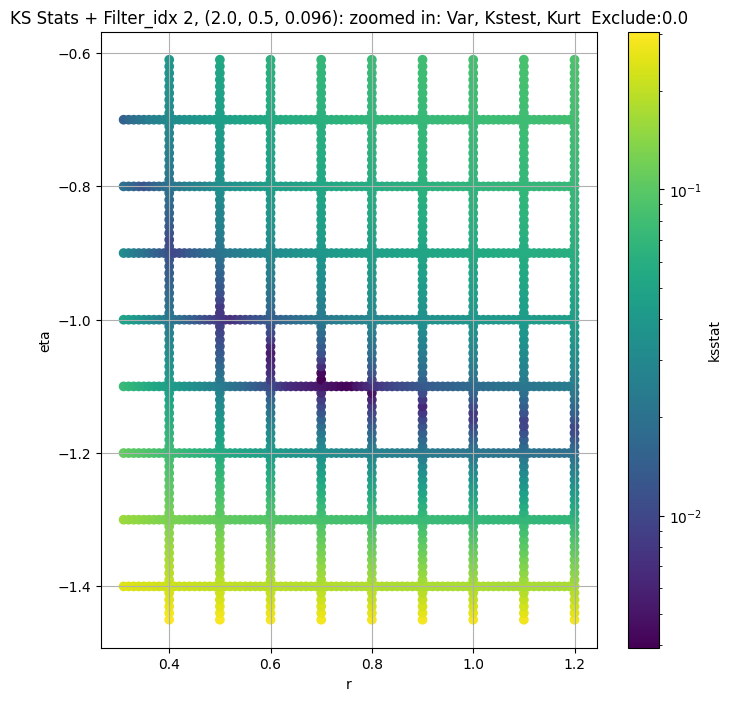

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.004519667158553009, var: 2936.14306640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.004950349208033833, var: 2984.595947265625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.004325883006193076, var: 3037.943603515625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.0042077795851418465, var: 3099.90576171875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.003536461828237747, var: 3192.913818359375
Number of samples: 100000, Without approximation : 65536000.0


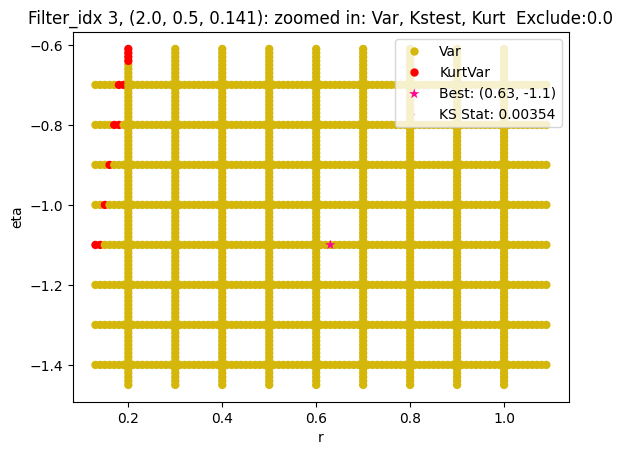

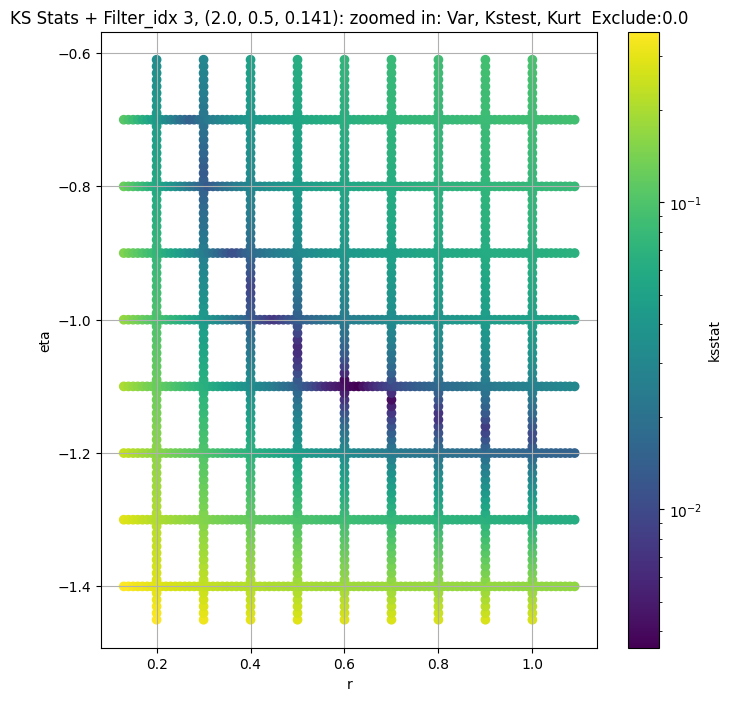

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 100 = 150, ksstat: 0.005337748452825093, var: 1215.4124755859375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 75 = 125, ksstat: 0.005639038017092618, var: 1233.723876953125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 50 = 100, ksstat: 0.005088705221578005, var: 1253.4283447265625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 25 = 75, ksstat: 0.004649135803071247, var: 1275.02880859375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + 0 = 50, ksstat: 0.004323753232976513, var: 1299.315185546875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + -25 = 25, ksstat: 0.004440469819447901, var: 1327.865478515625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 4, 50.0 + -50 = 0, ksstat: 0.00366747642969234, var: 1371.6312255859375
Number of samples: 100000, Without approximation : 65536000.0


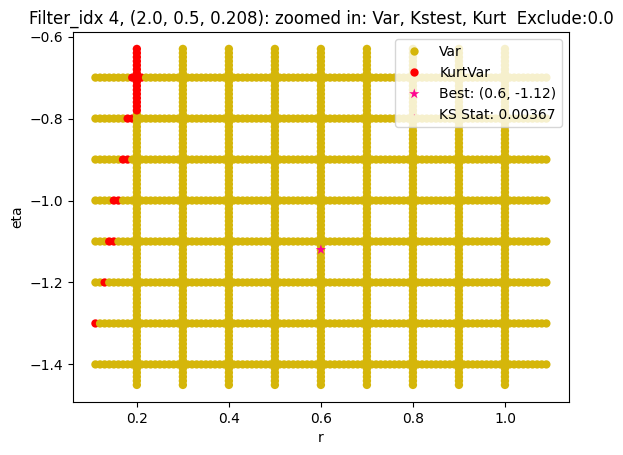

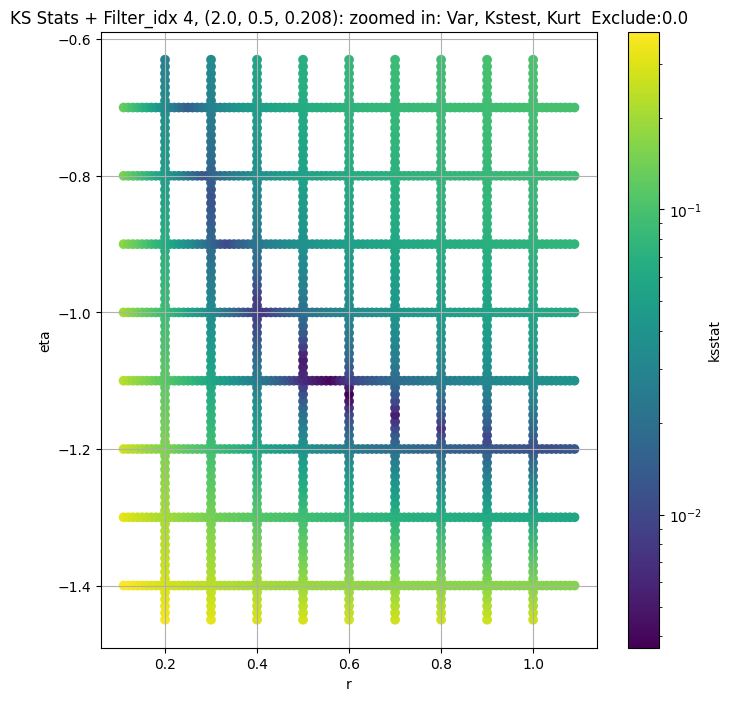

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 5, 0.0 + 100 = 100, ksstat: 0.009254262291186588, var: 489.04437255859375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 5, 0.0 + 75 = 75, ksstat: 0.009254039219542598, var: 498.2504577636719


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 5, 0.0 + 50 = 50, ksstat: 0.00925421168837548, var: 508.3630065917969


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 5, 0.0 + 25 = 25, ksstat: 0.009254033544824458, var: 520.0572509765625


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 5, 0.0 + 0 = 0, ksstat: 0.00925408486860857, var: 537.3888549804688
Number of samples: 100000, Without approximation : 65536000.0


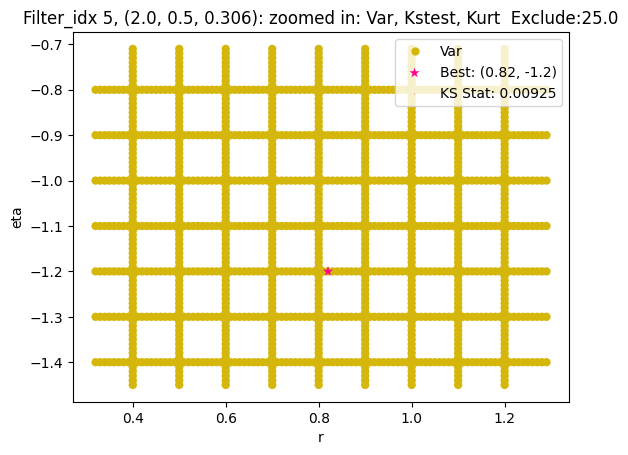

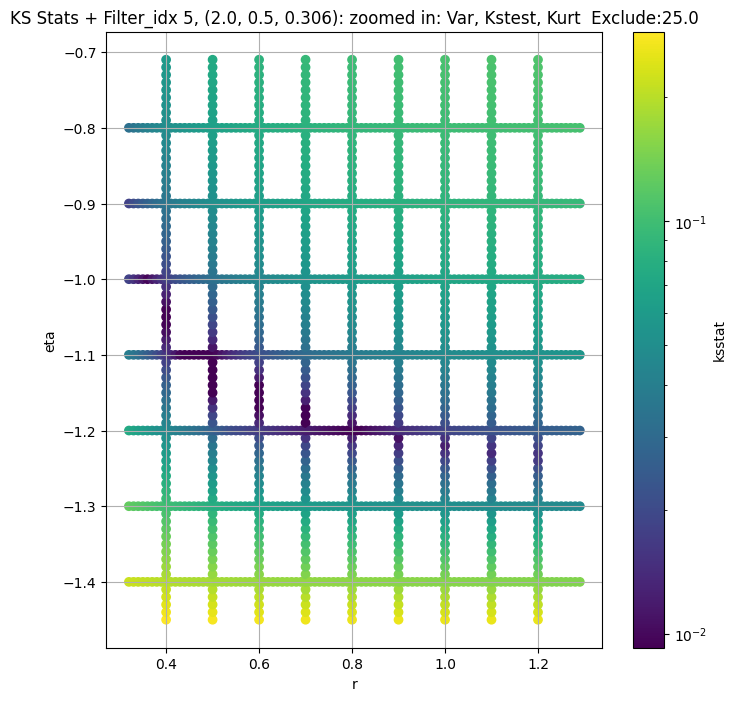

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 6, 200.0 + 100 = 300, ksstat: 0.011952021330339513, var: 293.5897521972656


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 6, 200.0 + 75 = 275, ksstat: 0.011951872407978459, var: 297.5773010253906


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 6, 200.0 + 50 = 250, ksstat: 0.011951715666532192, var: 301.731201171875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 6, 200.0 + 25 = 225, ksstat: 0.01195205910529068, var: 306.0697937011719


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 6, 200.0 + 0 = 200, ksstat: 0.01195190665832907, var: 310.6098937988281


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 6, 200.0 + -25 = 175, ksstat: 0.011952271746917986, var: 315.3800048828125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 6, 200.0 + -50 = 150, ksstat: 0.011952648873282623, var: 320.4237060546875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 6, 200.0 + -75 = 125, ksstat: 0.011951986398020309, var: 325.7955627441406


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 6, 200.0 + -100 = 100, ksstat: 0.011951843985948729, var: 331.54400634765625
Number of samples: 100000, Without approximation : 65536000.0


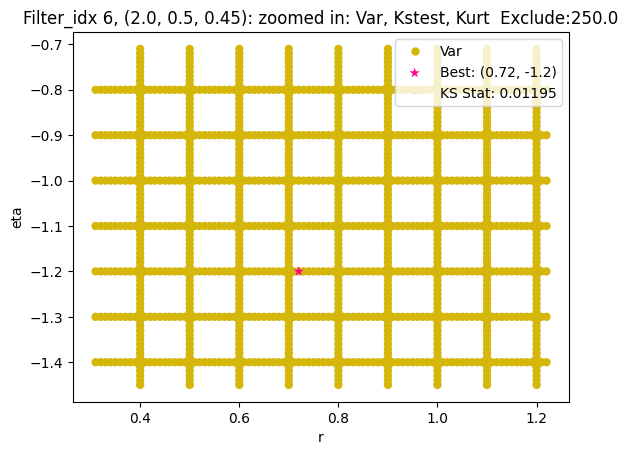

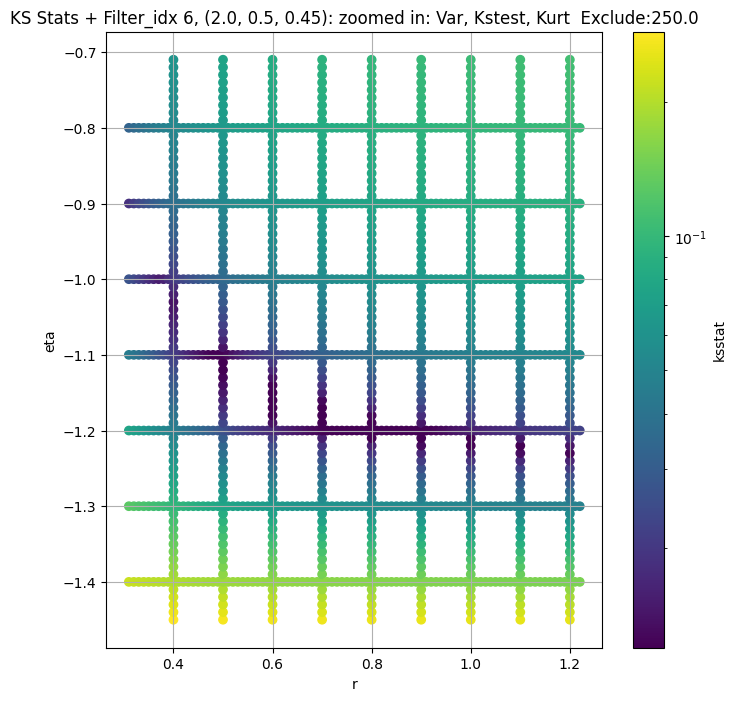

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 50.0 + 100 = 150, ksstat: 0.006134728186685701, var: 69941.078125


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 50.0 + 75 = 125, ksstat: 0.005659026013313584, var: 70748.3515625


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 50.0 + 50 = 100, ksstat: 0.005190260123268224, var: 71612.375


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 50.0 + 25 = 75, ksstat: 0.004690275144508496, var: 72546.765625


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 50.0 + 0 = 50, ksstat: 0.004090123426615966, var: 73572.8515625


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 50.0 + -25 = 25, ksstat: 0.004190216000034219, var: 74741.6640625


  0%|          | 0/1900 [00:00<?, ?it/s]

Finding Minimum after computing 1900 CDFs
filter_idx 7, 50.0 + -50 = 0, ksstat: 0.004115443004095276, var: 76423.1953125
Number of samples: 100000, Without approximation : 65536000.0


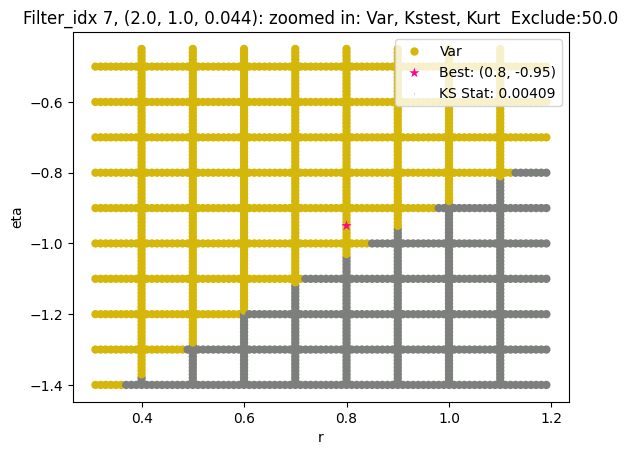

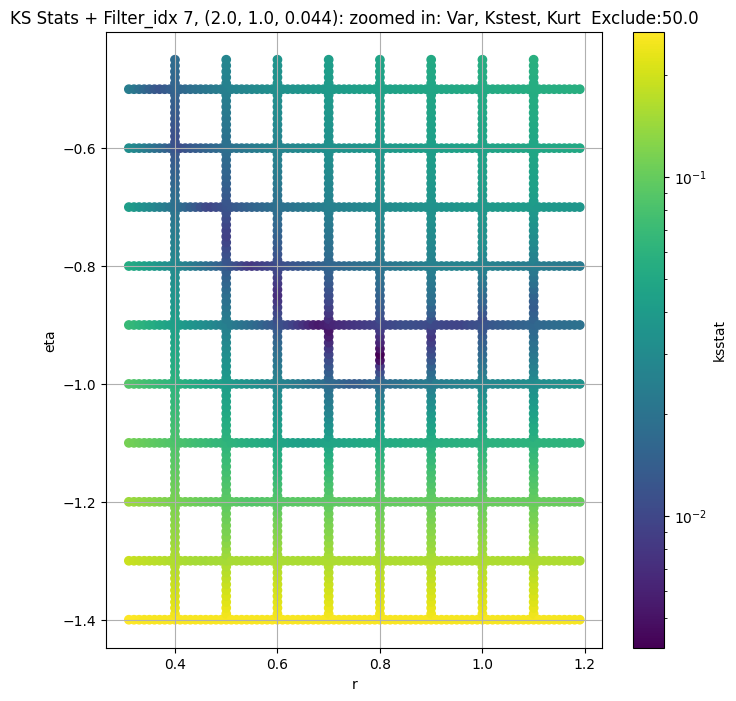

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 100.0 + 100 = 200, ksstat: 0.004641771892899604, var: 24848.791015625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 100.0 + 75 = 175, ksstat: 0.004284211704709415, var: 25156.91015625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 100.0 + 50 = 150, ksstat: 0.003917520822783627, var: 25484.384765625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 100.0 + 25 = 125, ksstat: 0.0036104329909841908, var: 25834.841796875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 100.0 + 0 = 100, ksstat: 0.0032361892883727705, var: 26213.78515625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 100.0 + -25 = 75, ksstat: 0.002925722050547752, var: 26627.873046875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 100.0 + -50 = 50, ksstat: 0.0026451723424471343, var: 27089.26953125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 100.0 + -75 = 25, ksstat: 0.002424188866153032, var: 27625.19140625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 100.0 + -100 = 0, ksstat: 0.0022378758805031707, var: 28467.8203125
Number of samples: 100000, Without approximation : 65536000.0


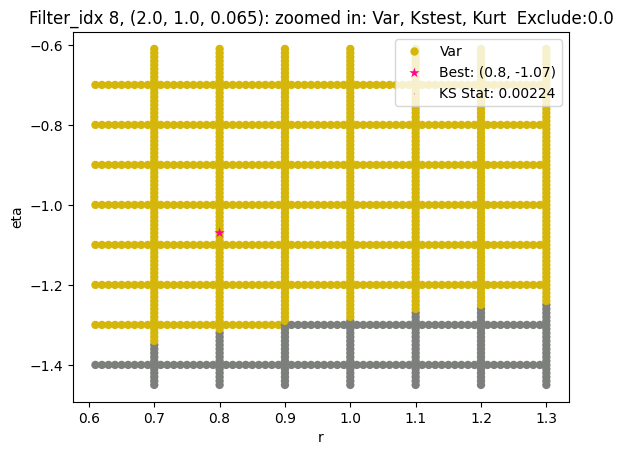

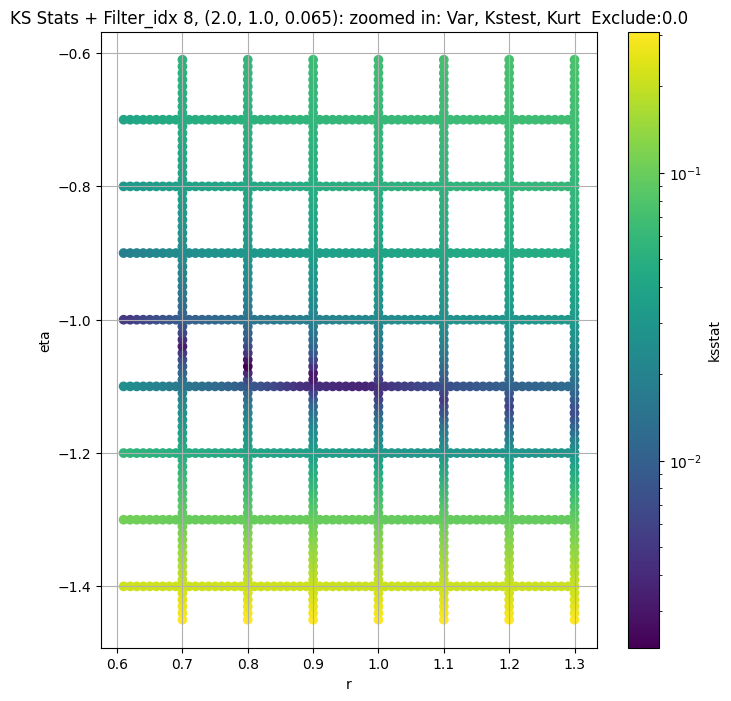

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 100 = 200, ksstat: 0.004699367695720658, var: 9734.00390625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 75 = 175, ksstat: 0.0044171450090612074, var: 9865.005859375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 50 = 150, ksstat: 0.0040665324267881164, var: 10004.1669921875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 25 = 125, ksstat: 0.00377241271498574, var: 10153.044921875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 0 = 100, ksstat: 0.003379431251290633, var: 10313.7861328125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + -25 = 75, ksstat: 0.0031390842712871736, var: 10489.724609375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + -50 = 50, ksstat: 0.0027971004351246, var: 10685.7568359375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + -75 = 25, ksstat: 0.0028159120841129703, var: 10914.8203125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + -100 = 0, ksstat: 0.0027269351328989, var: 11275.83203125
Number of samples: 100000, Without approximation : 65536000.0


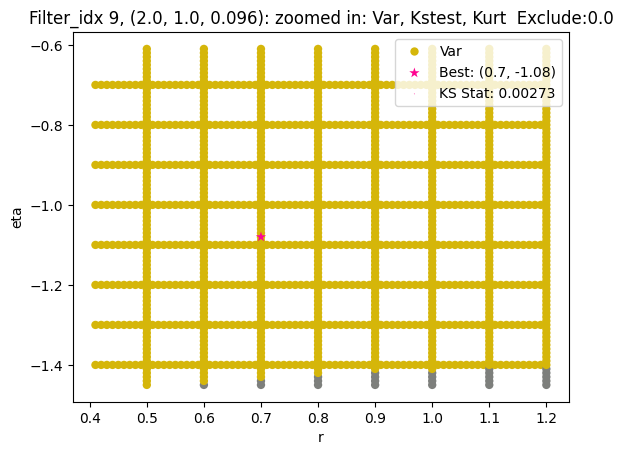

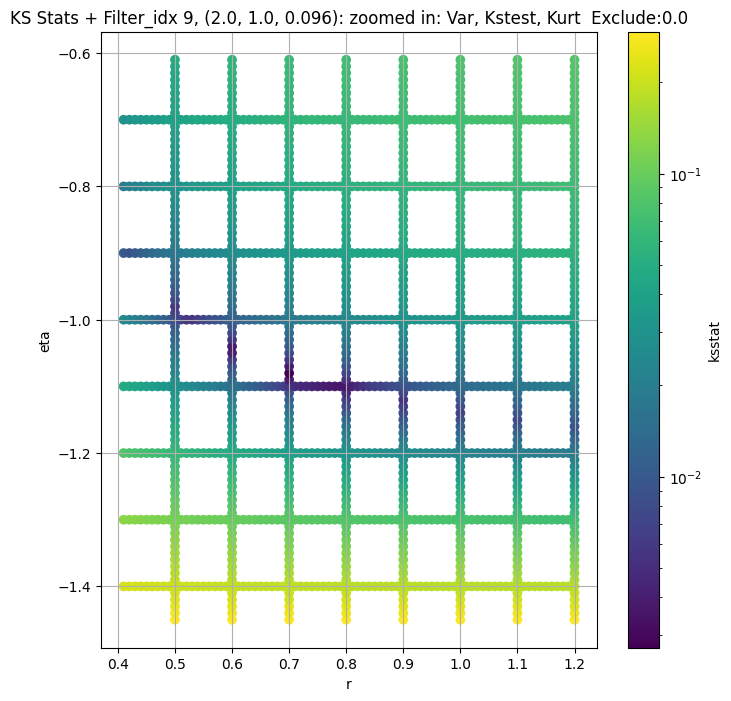

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 10, 0.0 + 100 = 100, ksstat: 0.003796599199290873, var: 3968.927978515625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 10, 0.0 + 75 = 75, ksstat: 0.003614269910806822, var: 4044.4169921875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 10, 0.0 + 50 = 50, ksstat: 0.002972808248040755, var: 4129.7763671875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 10, 0.0 + 25 = 25, ksstat: 0.0031296757278701515, var: 4230.767578125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 10, 0.0 + 0 = 0, ksstat: 0.0027974833206566574, var: 4387.60498046875
Number of samples: 100000, Without approximation : 65536000.0


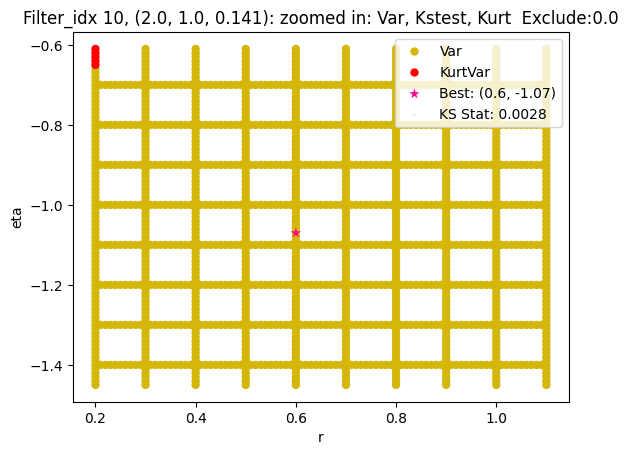

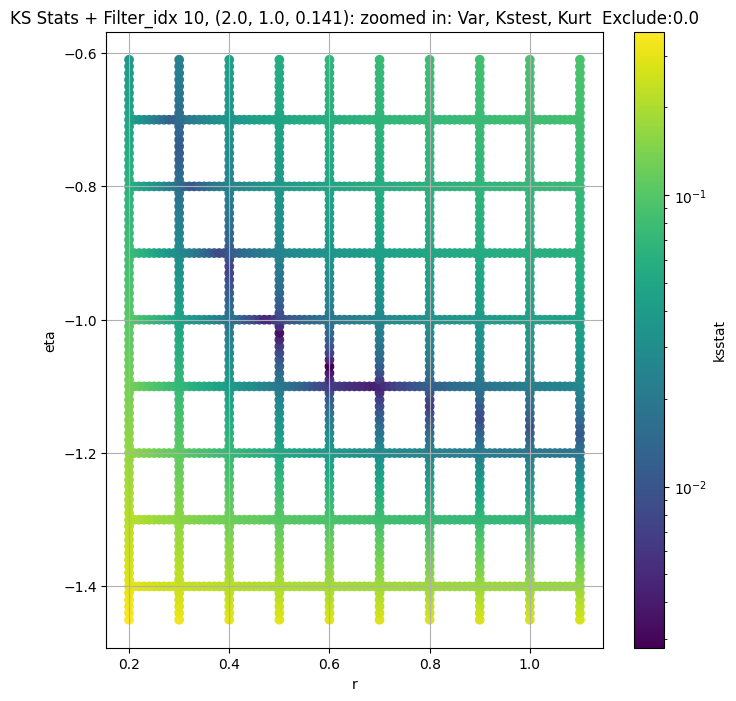

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 100 = 150, ksstat: 0.0040586584215238294, var: 1524.234130859375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 75 = 125, ksstat: 0.003632049943997795, var: 1551.3941650390625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 50 = 100, ksstat: 0.0036044595711932637, var: 1580.8365478515625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 25 = 75, ksstat: 0.003603069505666301, var: 1613.41015625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + 0 = 50, ksstat: 0.0036029055263893106, var: 1650.4351806640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + -25 = 25, ksstat: 0.0036027707216912397, var: 1694.495361328125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 11, 50.0 + -50 = 0, ksstat: 0.0036027948967449763, var: 1762.89892578125
Number of samples: 100000, Without approximation : 65536000.0


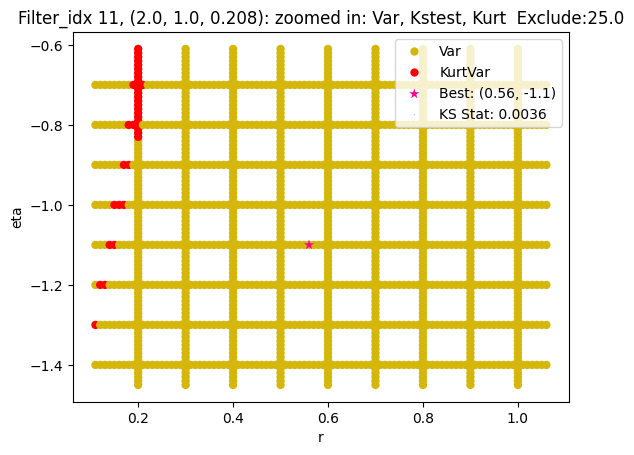

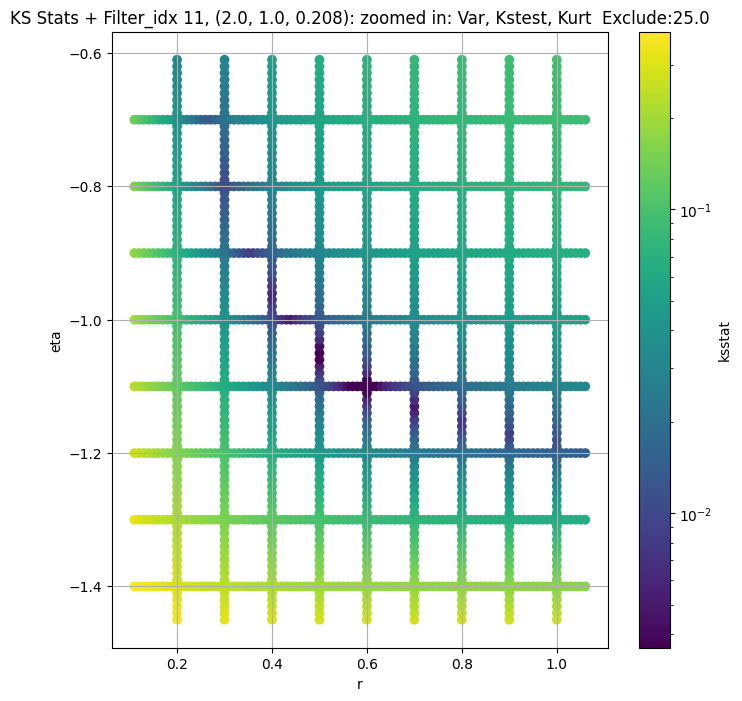

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 50.0 + 100 = 150, ksstat: 0.007320329584608709, var: 637.2401123046875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 50.0 + 75 = 125, ksstat: 0.007301205754028428, var: 649.4261474609375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 50.0 + 50 = 100, ksstat: 0.007301221261696966, var: 662.738525390625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 50.0 + 25 = 75, ksstat: 0.007301253931956797, var: 677.5236206054688


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 50.0 + 0 = 50, ksstat: 0.007319586151046997, var: 694.4182739257812


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 50.0 + -25 = 25, ksstat: 0.007320019808640277, var: 714.65283203125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 12, 50.0 + -50 = 0, ksstat: 0.007319456549496284, var: 745.6644897460938
Number of samples: 100000, Without approximation : 65536000.0


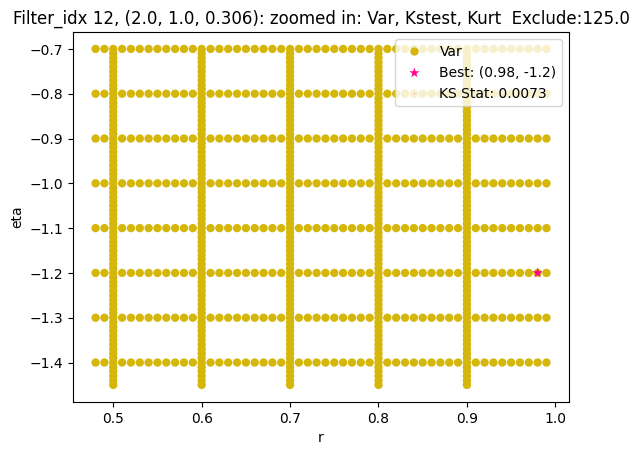

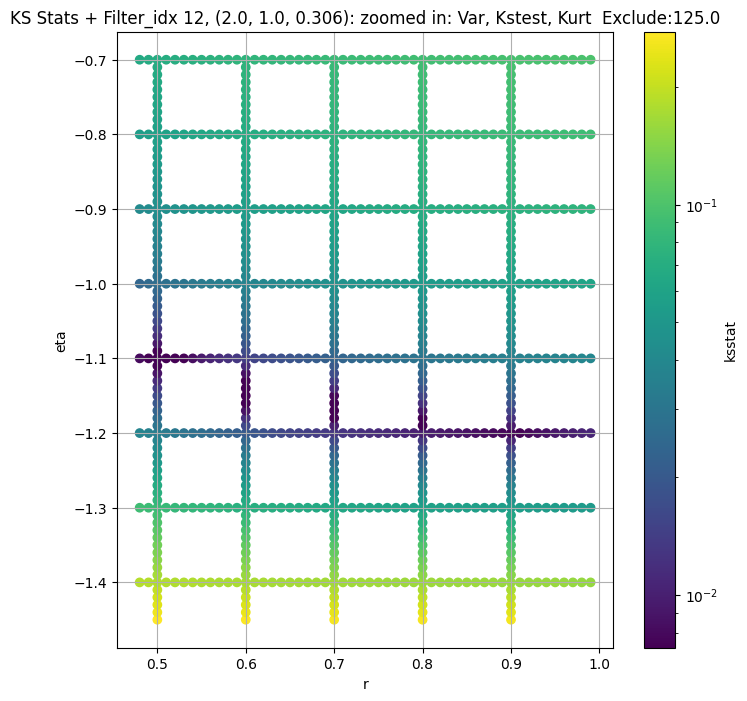

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 100 = 300, ksstat: 0.009809594247424225, var: 294.5275573730469


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 75 = 275, ksstat: 0.009809434526310612, var: 299.194091796875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 50 = 250, ksstat: 0.009809266386551552, var: 304.0792541503906


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 25 = 225, ksstat: 0.009809938661563322, var: 309.2074890136719


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + 0 = 200, ksstat: 0.009809788880450254, var: 314.61468505859375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + -25 = 175, ksstat: 0.009810509110718624, var: 320.3417663574219


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + -50 = 150, ksstat: 0.009809486462252826, var: 326.43658447265625


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + -75 = 125, ksstat: 0.00980933778914489, var: 332.9391784667969


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 13, 200.0 + -100 = 100, ksstat: 0.009809208893872101, var: 340.03167724609375
Number of samples: 100000, Without approximation : 65536000.0


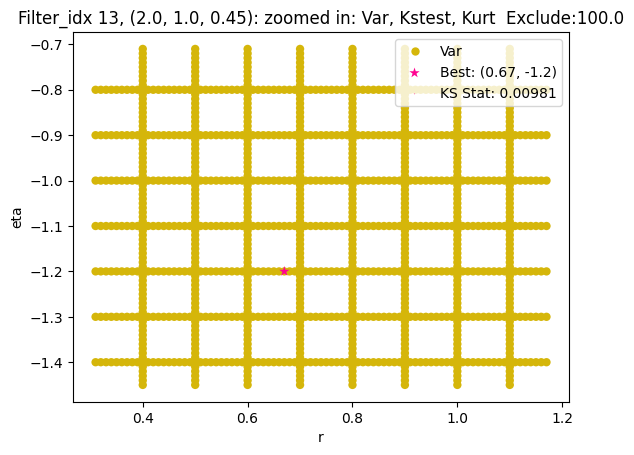

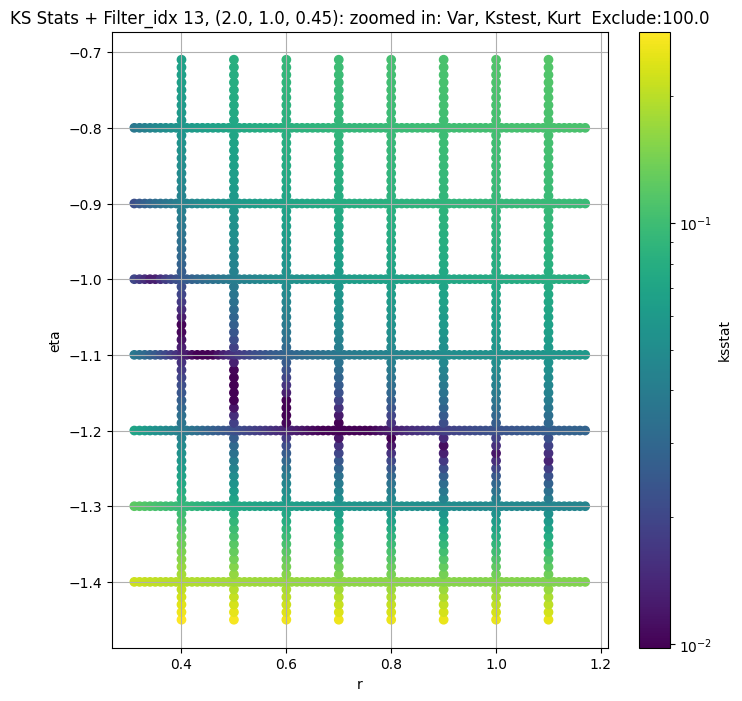

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.005790762863274401, var: 48530.45703125


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.0052148242410668955, var: 49162.06640625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.004711265543121956, var: 49859.12890625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.004164344078663507, var: 50667.59765625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.003902445709347946, var: 51914.19921875
Number of samples: 100000, Without approximation : 65536000.0


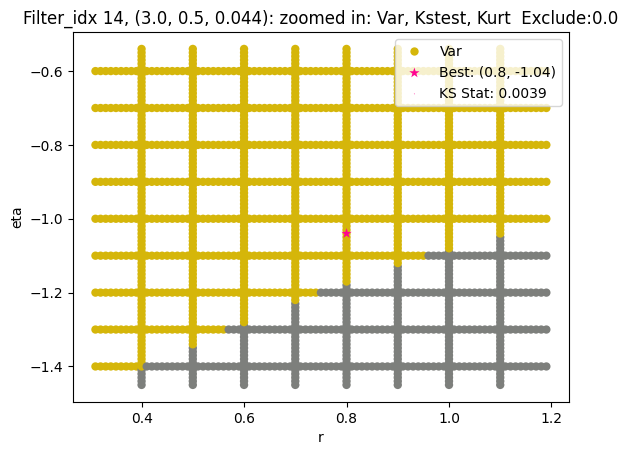

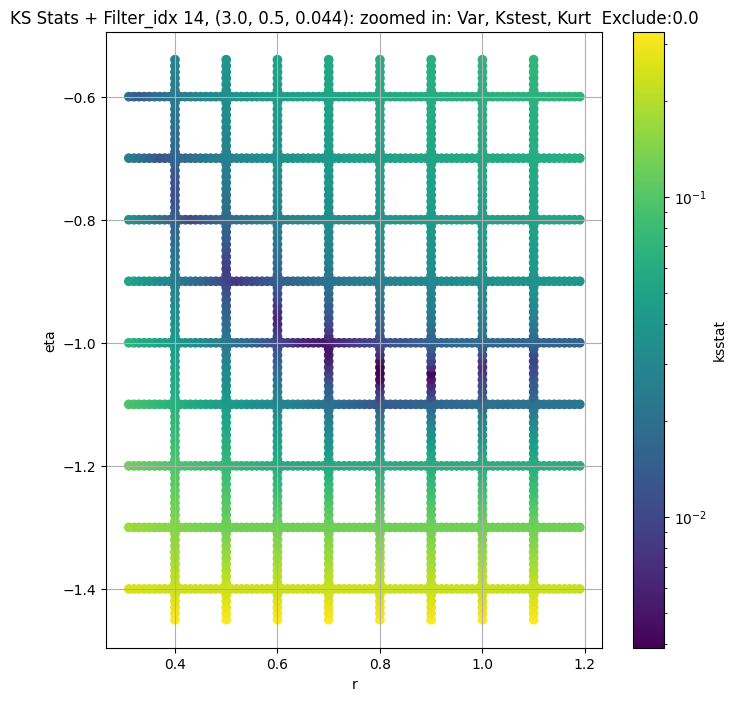

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 100 = 100, ksstat: 0.004878097015262595, var: 18563.4453125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 75 = 75, ksstat: 0.004524245826040607, var: 18848.037109375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 50 = 50, ksstat: 0.004374834810837003, var: 19166.19921875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 25 = 25, ksstat: 0.004344965952577606, var: 19539.763671875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 0 = 0, ksstat: 0.003705790928795527, var: 20121.013671875
Number of samples: 100000, Without approximation : 65536000.0


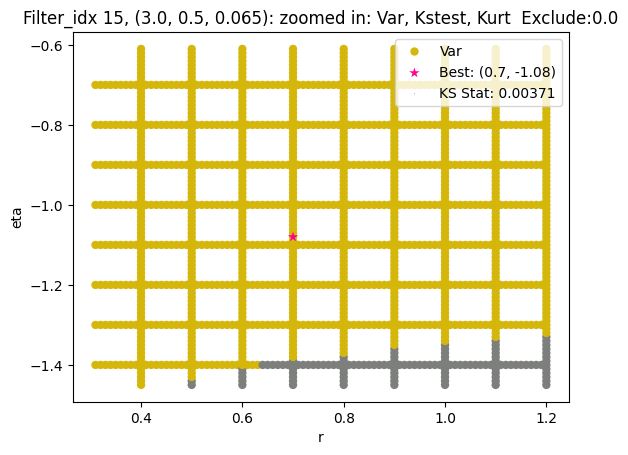

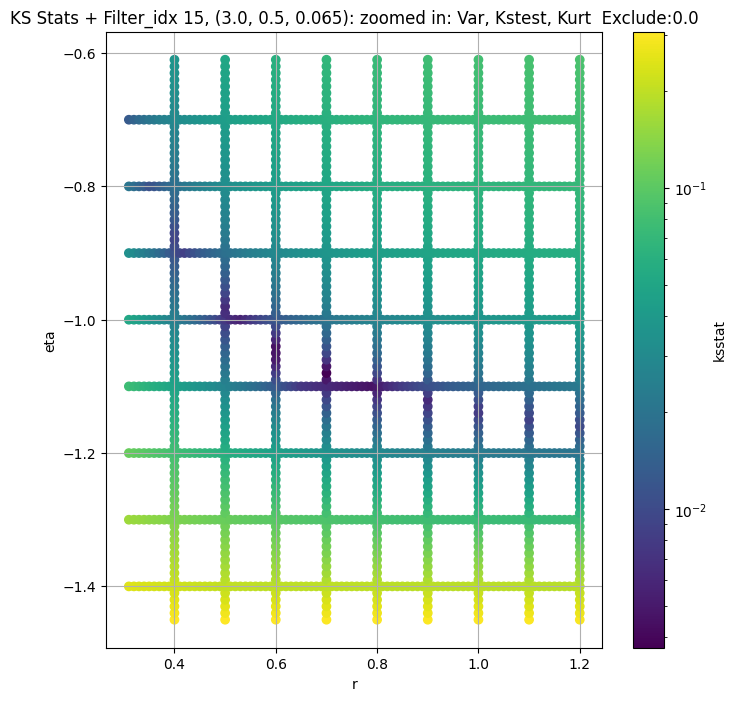

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 16, 200.0 + 100 = 300, ksstat: 0.007162066154419167, var: 6162.609375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 16, 200.0 + 75 = 275, ksstat: 0.006904485861470303, var: 6238.77587890625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 16, 200.0 + 50 = 250, ksstat: 0.0067584392894728396, var: 6318.08837890625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 16, 200.0 + 25 = 225, ksstat: 0.006549906320654331, var: 6400.90771484375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 16, 200.0 + 0 = 200, ksstat: 0.0061972178049989335, var: 6487.4814453125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 16, 200.0 + -25 = 175, ksstat: 0.005939099163068229, var: 6578.53662109375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 16, 200.0 + -50 = 150, ksstat: 0.005592622185798202, var: 6675.009765625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 16, 200.0 + -75 = 125, ksstat: 0.005668851904510108, var: 6777.76171875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 16, 200.0 + -100 = 100, ksstat: 0.005417670238451966, var: 6888.43408203125
Number of samples: 100000, Without approximation : 65536000.0


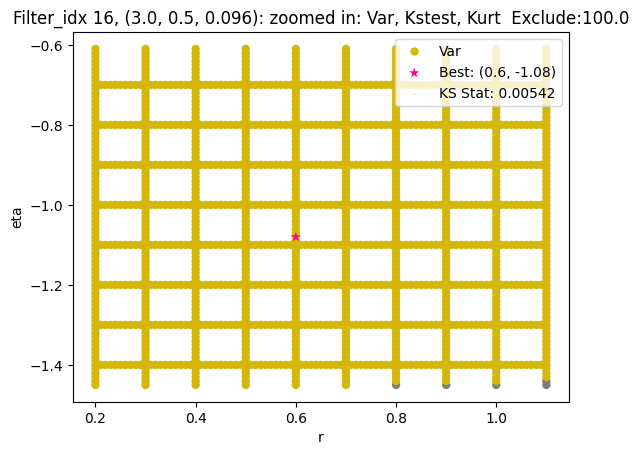

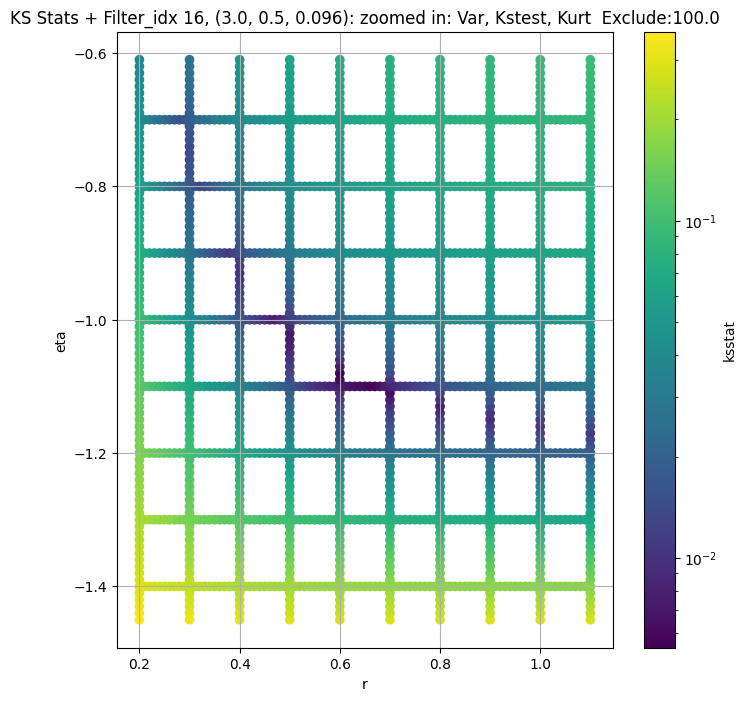

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.0055088279137994745, var: 2606.410888671875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.005029566520117344, var: 2658.83251953125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.004770599022925426, var: 2718.12158203125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.005388964628995574, var: 2789.531005859375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.004326745741750959, var: 2907.19482421875
Number of samples: 100000, Without approximation : 65536000.0


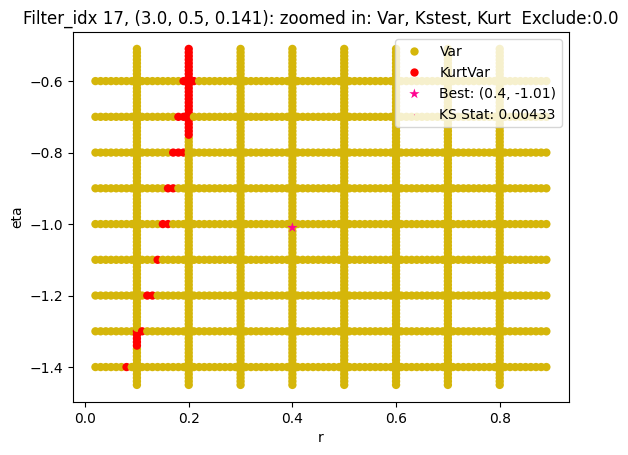

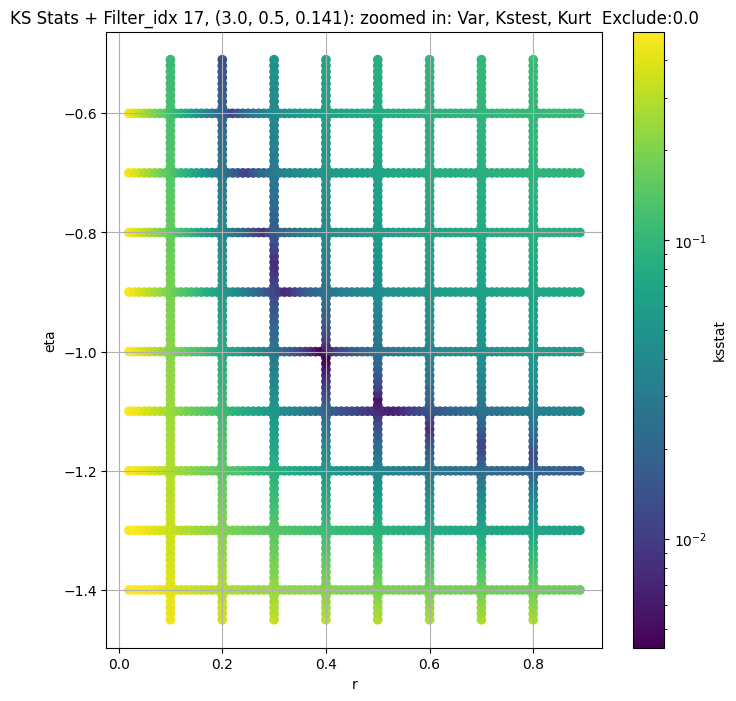

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.005290666422405194, var: 1059.0


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.005417391460259581, var: 1078.566162109375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.005027568208329086, var: 1099.971435546875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.004601467258676273, var: 1123.7159423828125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.004118865777518549, var: 1150.753173828125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.003750302927247484, var: 1183.05126953125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.0036729332250401425, var: 1239.6500244140625
Number of samples: 100000, Without approximation : 65536000.0


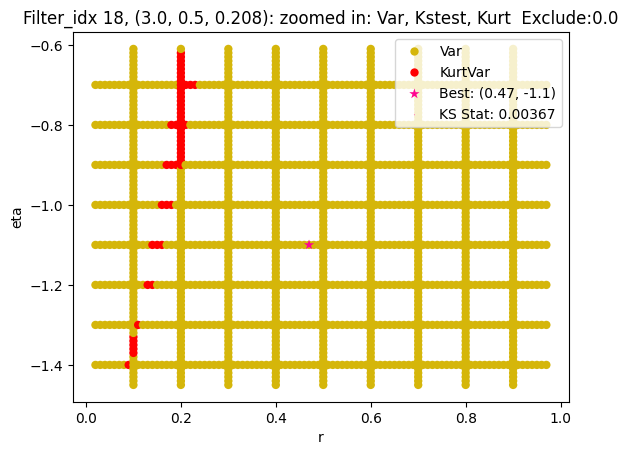

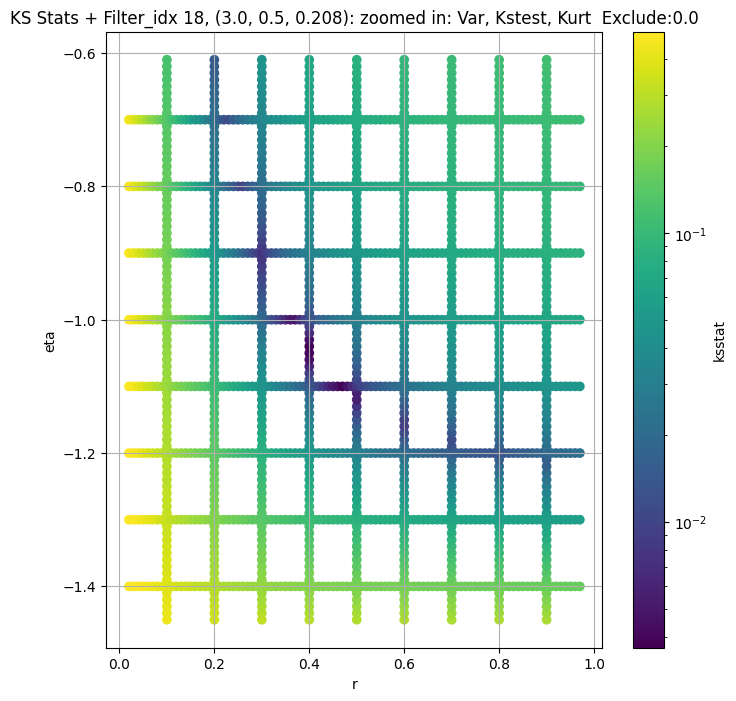

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 19, 0.0 + 100 = 100, ksstat: 0.005493901621335451, var: 496.6795654296875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 19, 0.0 + 75 = 75, ksstat: 0.005455940353724653, var: 508.02001953125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 19, 0.0 + 50 = 50, ksstat: 0.005462303944126723, var: 520.8402099609375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 19, 0.0 + 25 = 25, ksstat: 0.005423140448603647, var: 536.079833984375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 19, 0.0 + 0 = 0, ksstat: 0.005435349907631171, var: 561.3305053710938
Number of samples: 100000, Without approximation : 65536000.0


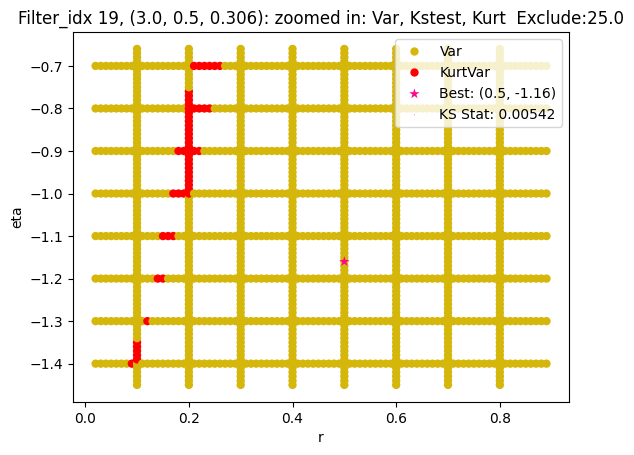

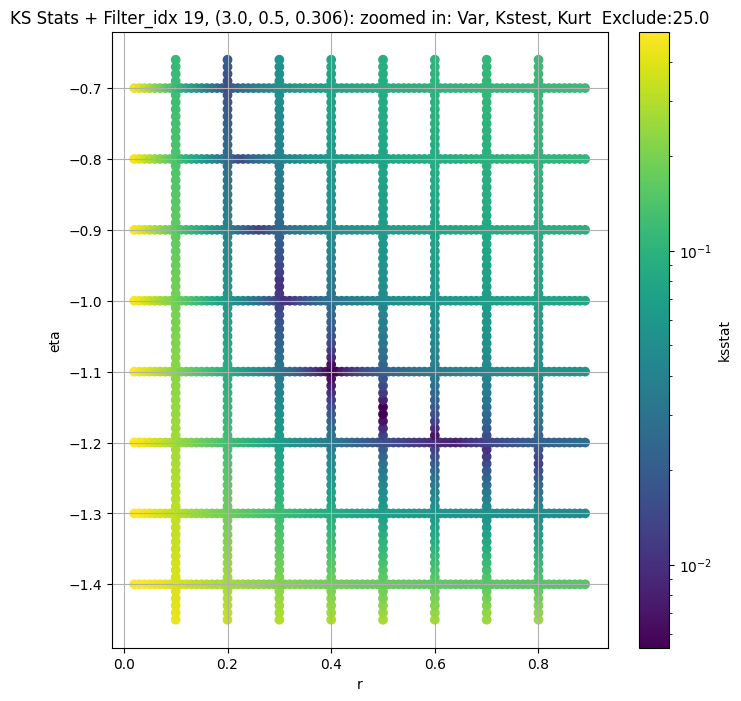

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.008282430540378749, var: 252.70938110351562


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.00868738028606375, var: 258.5369567871094


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.008937726374254495, var: 264.9874572753906


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.00871847270999726, var: 272.5337829589844


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.008983469058535698, var: 284.7602844238281
Number of samples: 100000, Without approximation : 65536000.0


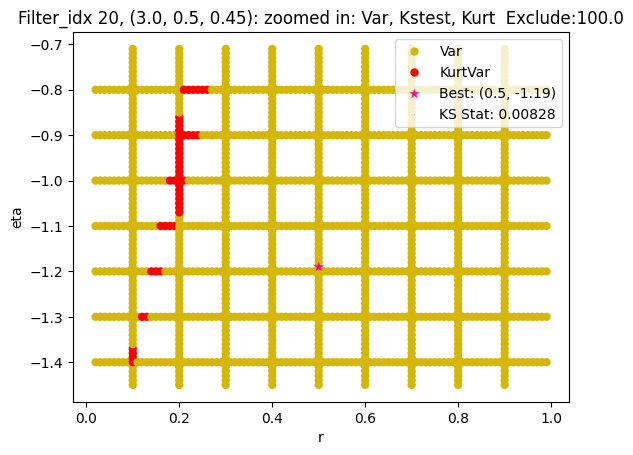

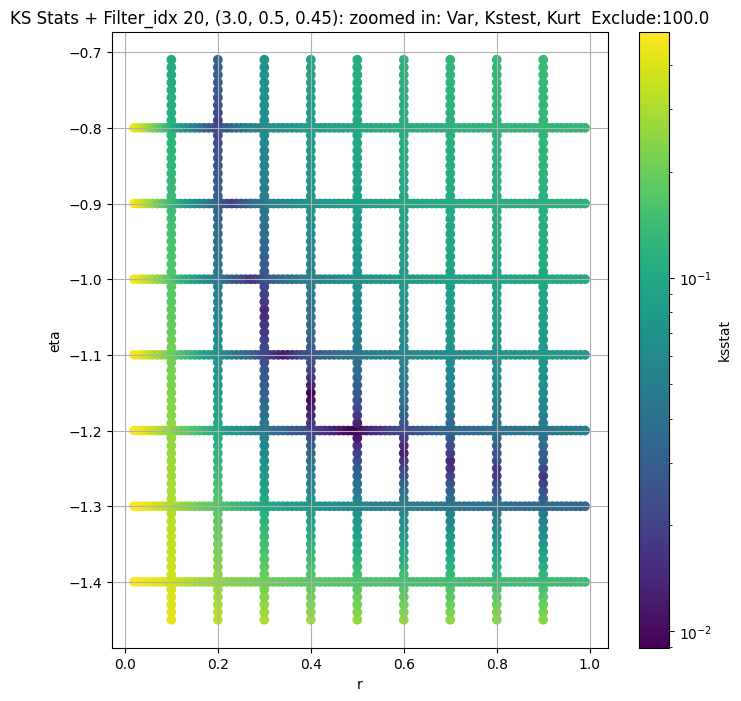

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 100 = 150, ksstat: 0.004830220984473499, var: 53698.1171875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 75 = 125, ksstat: 0.004326155780634777, var: 54585.44140625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 50 = 100, ksstat: 0.004301475076797567, var: 55547.10546875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 25 = 75, ksstat: 0.004033229895256243, var: 56602.546875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 0 = 50, ksstat: 0.0035220374327487036, var: 57780.953125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + -25 = 25, ksstat: 0.00364669054516209, var: 59149.19140625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + -50 = 0, ksstat: 0.003512138446781554, var: 61206.1171875
Number of samples: 100000, Without approximation : 65536000.0


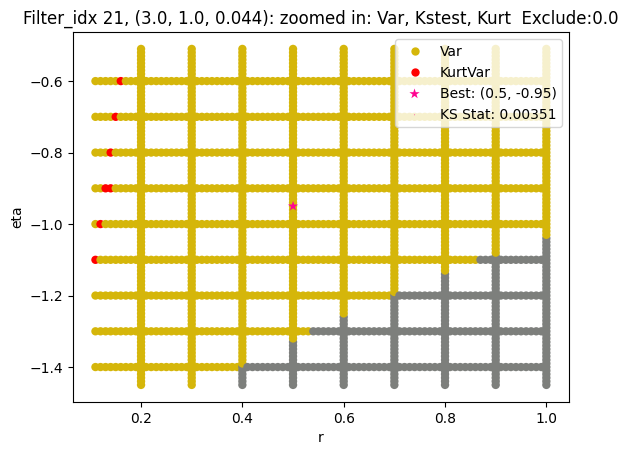

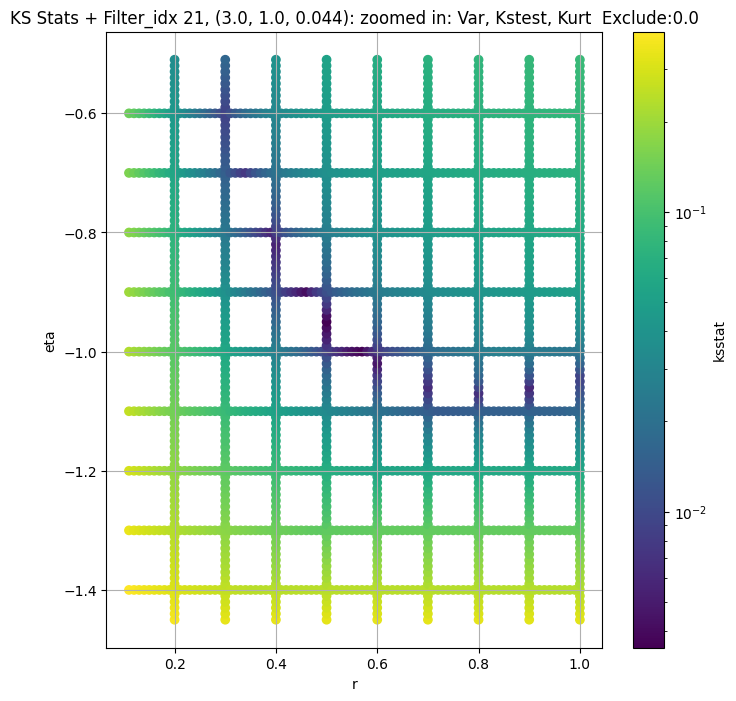

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.003909893330933993, var: 20518.146484375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.0042897253343505, var: 20949.330078125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.003681104690170023, var: 21430.017578125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.0034919153177983553, var: 21990.3203125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.002575758762446617, var: 22796.802734375
Number of samples: 100000, Without approximation : 65536000.0


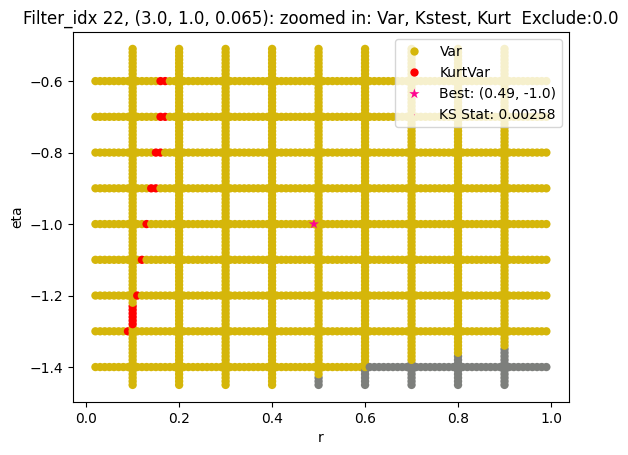

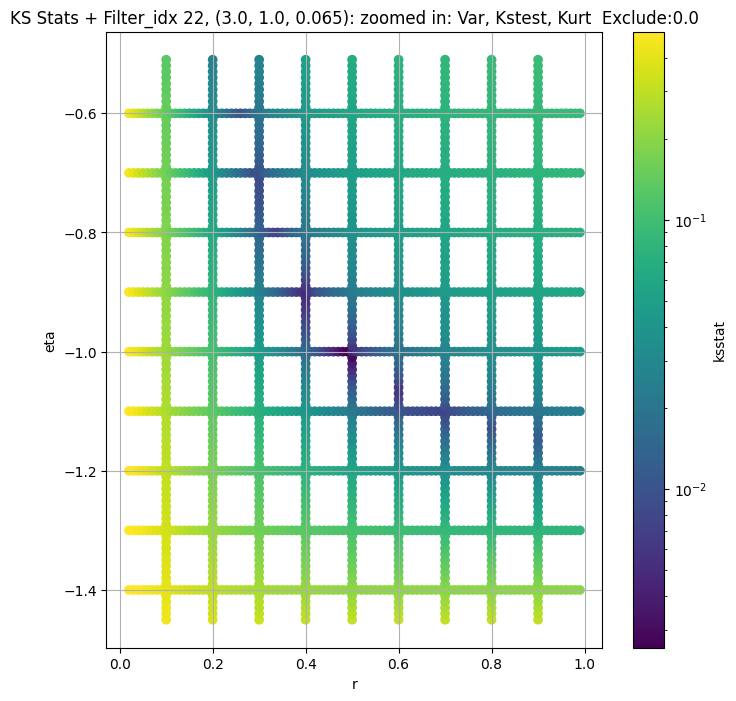

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 100 = 100, ksstat: 0.005010155573314835, var: 7998.4951171875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 75 = 75, ksstat: 0.004540787376228164, var: 8200.064453125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 50 = 50, ksstat: 0.004245686857030417, var: 8428.2578125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 25 = 25, ksstat: 0.0034096336193906174, var: 8698.76953125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 23, 0.0 + 0 = 0, ksstat: 0.004255819475214806, var: 9137.8828125
Number of samples: 100000, Without approximation : 65536000.0


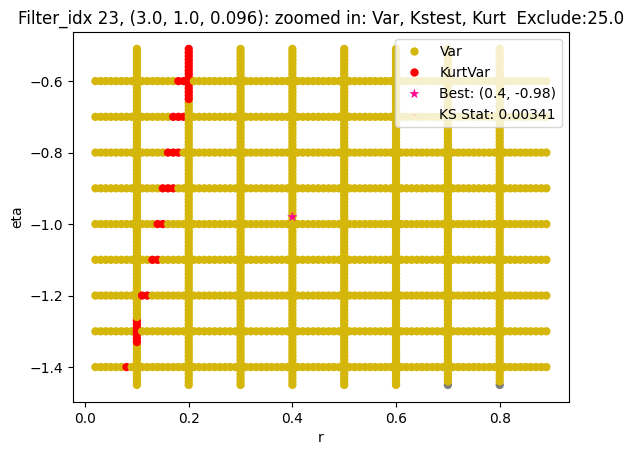

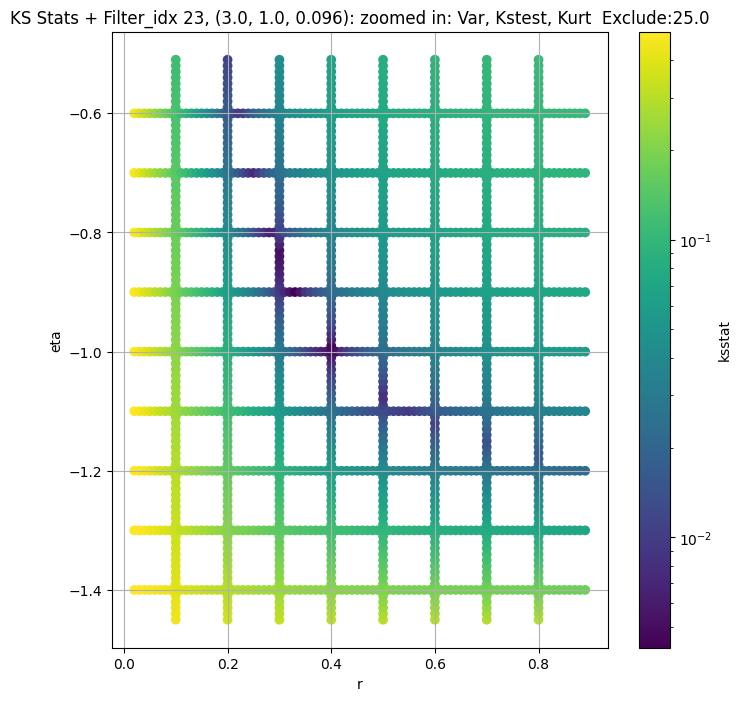

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.005594923542571073, var: 2962.63671875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.004878569333606642, var: 3044.178955078125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.00406029074260239, var: 3137.491943359375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.0038360811688512575, var: 3248.9345703125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.0030697972127188833, var: 3432.61669921875
Number of samples: 100000, Without approximation : 65536000.0


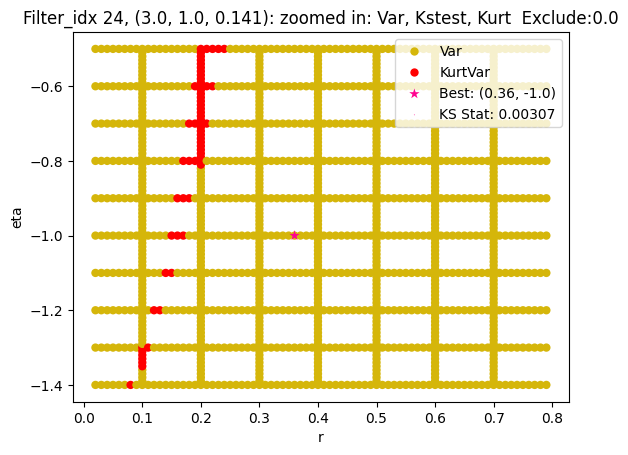

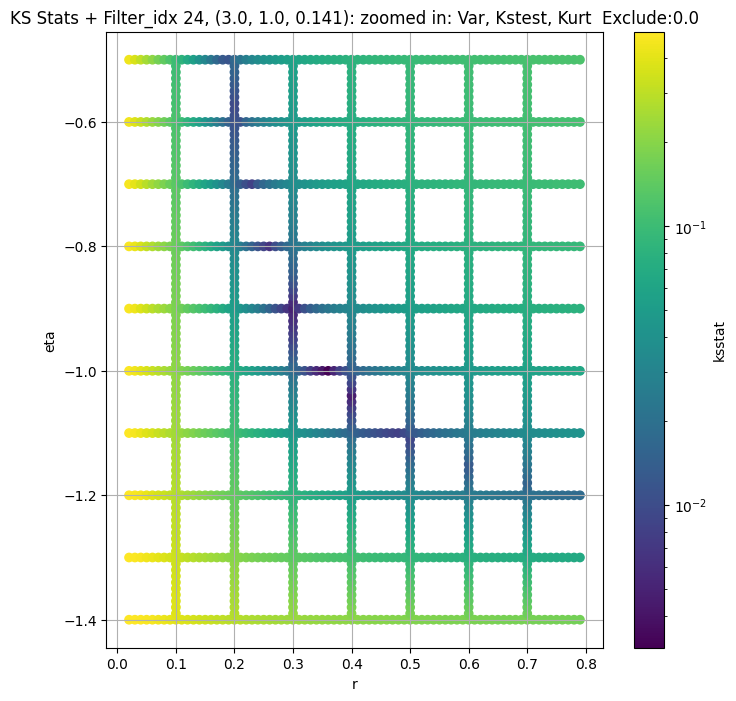

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 25, 200.0 + 100 = 300, ksstat: 0.00655311657205504, var: 1040.7374267578125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 25, 200.0 + 75 = 275, ksstat: 0.006322402462766941, var: 1059.6441650390625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 25, 200.0 + 50 = 250, ksstat: 0.0059325803028649204, var: 1079.6715087890625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 25, 200.0 + 25 = 225, ksstat: 0.005575287392691197, var: 1100.976806640625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 25, 200.0 + 0 = 200, ksstat: 0.005334022362888546, var: 1123.724853515625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 25, 200.0 + -25 = 175, ksstat: 0.004912161817744197, var: 1148.10546875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 25, 200.0 + -50 = 150, ksstat: 0.004963256596496046, var: 1174.416748046875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 25, 200.0 + -75 = 125, ksstat: 0.004816059240836723, var: 1203.0994873046875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 25, 200.0 + -100 = 100, ksstat: 0.004581129366179146, var: 1234.7469482421875
Number of samples: 100000, Without approximation : 65536000.0


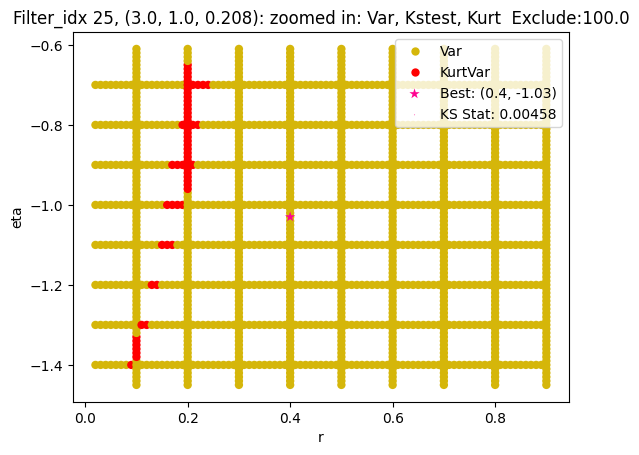

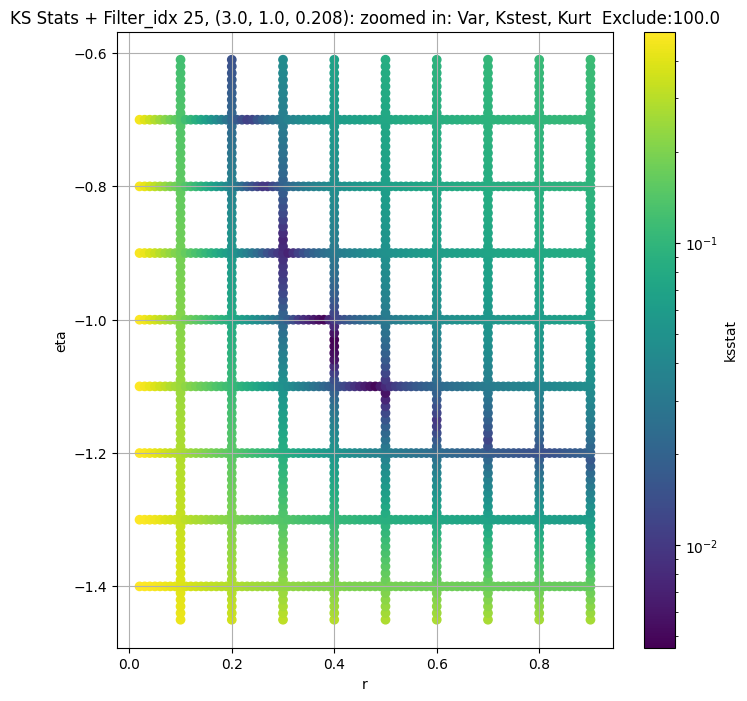

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 26, 0.0 + 100 = 100, ksstat: 0.0040246436464300706, var: 555.4567260742188


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 26, 0.0 + 75 = 75, ksstat: 0.003907121687062198, var: 571.8408203125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 26, 0.0 + 50 = 50, ksstat: 0.003908137491677066, var: 590.7747802734375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 26, 0.0 + 25 = 25, ksstat: 0.004150828597422995, var: 613.7415161132812


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 26, 0.0 + 0 = 0, ksstat: 0.003913173358412236, var: 652.5490112304688
Number of samples: 100000, Without approximation : 65536000.0


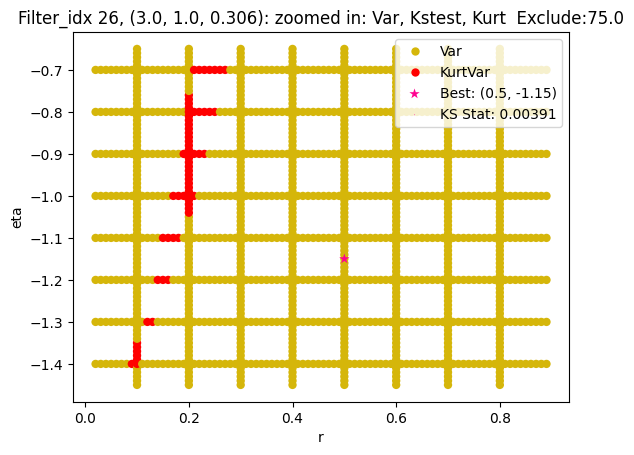

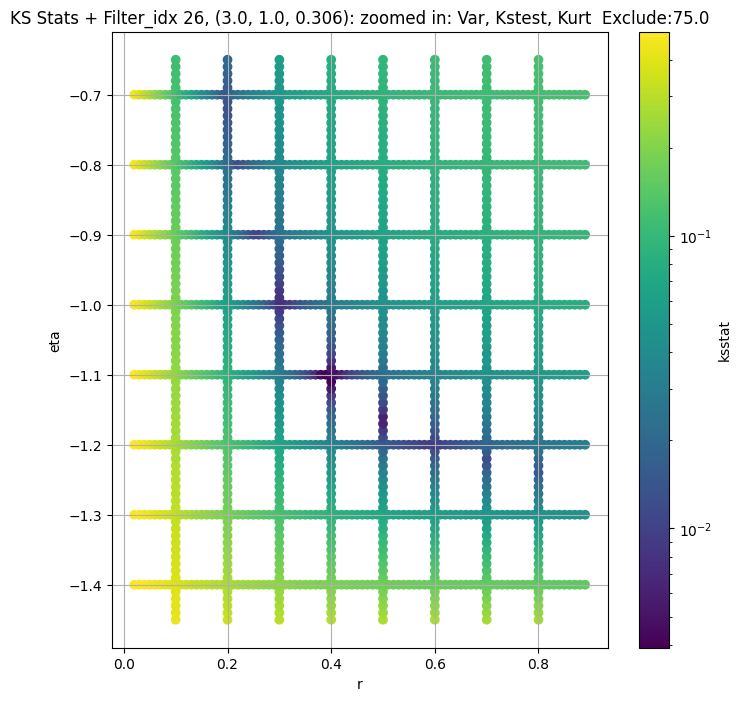

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 27, 50.0 + 100 = 150, ksstat: 0.00814161044101902, var: 253.45175170898438


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 27, 50.0 + 75 = 125, ksstat: 0.008829825091811627, var: 260.0625915527344


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 27, 50.0 + 50 = 100, ksstat: 0.008955424315270133, var: 267.4588928222656


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 27, 50.0 + 25 = 75, ksstat: 0.007651259359405124, var: 275.92010498046875


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 27, 50.0 + 0 = 50, ksstat: 0.007149686803218813, var: 285.8637390136719


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 27, 50.0 + -25 = 25, ksstat: 0.006490851689847421, var: 298.1046447753906


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 27, 50.0 + -50 = 0, ksstat: 0.007757264084883531, var: 318.57708740234375
Number of samples: 100000, Without approximation : 65536000.0


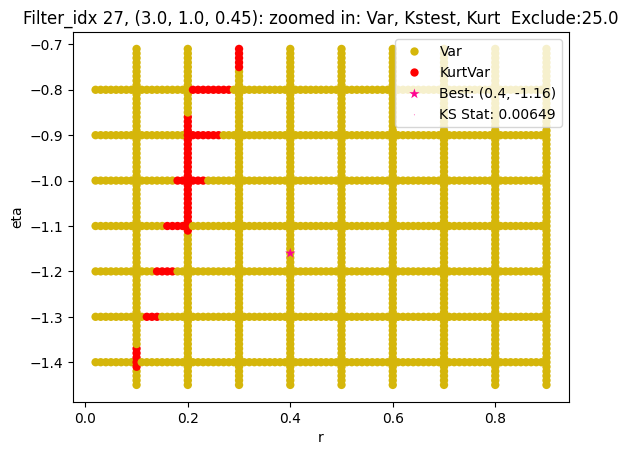

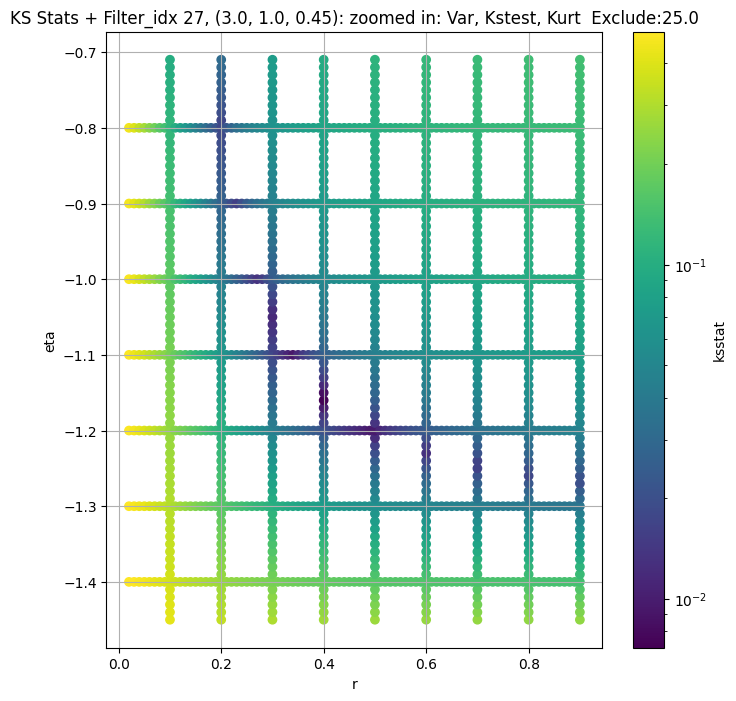

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.004497614870425548, var: 46806.6796875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.003966614661713774, var: 47458.2734375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.0036606407069854074, var: 48187.17578125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.003494154783644232, var: 49057.29296875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.0022899127686041854, var: 50571.7265625
Number of samples: 100000, Without approximation : 65536000.0


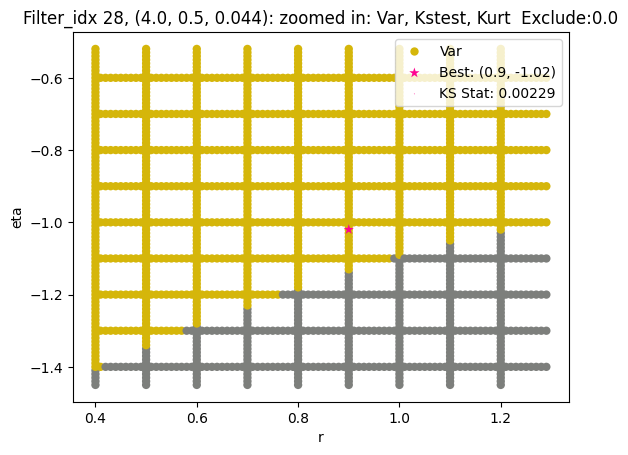

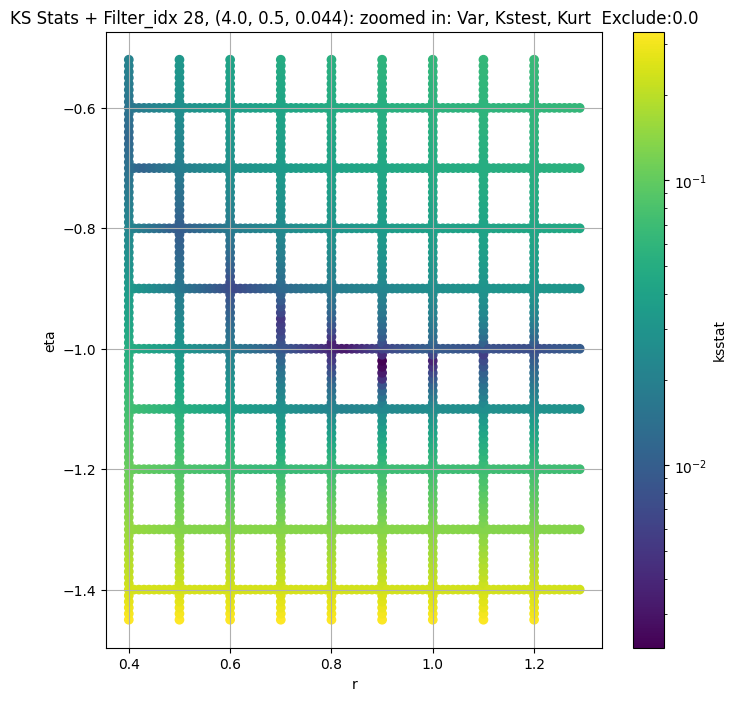

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 100 = 200, ksstat: 0.005069045729136579, var: 16211.2890625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 75 = 175, ksstat: 0.004757738704542103, var: 16424.541015625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 50 = 150, ksstat: 0.004776650187343967, var: 16651.47265625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 25 = 125, ksstat: 0.004483460998204847, var: 16894.28515625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 0 = 100, ksstat: 0.004603224989561339, var: 17157.998046875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + -25 = 75, ksstat: 0.004314052097097787, var: 17448.220703125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + -50 = 50, ksstat: 0.003903222716026833, var: 17777.5390625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + -75 = 25, ksstat: 0.004142632726655715, var: 18177.63671875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + -100 = 0, ksstat: 0.003257518215567523, var: 18909.939453125
Number of samples: 100000, Without approximation : 65536000.0


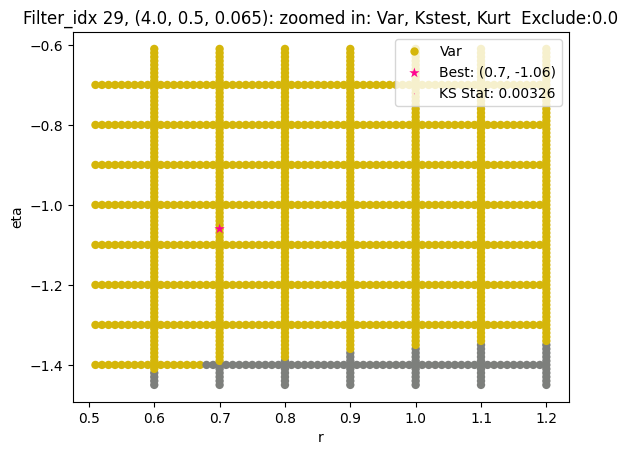

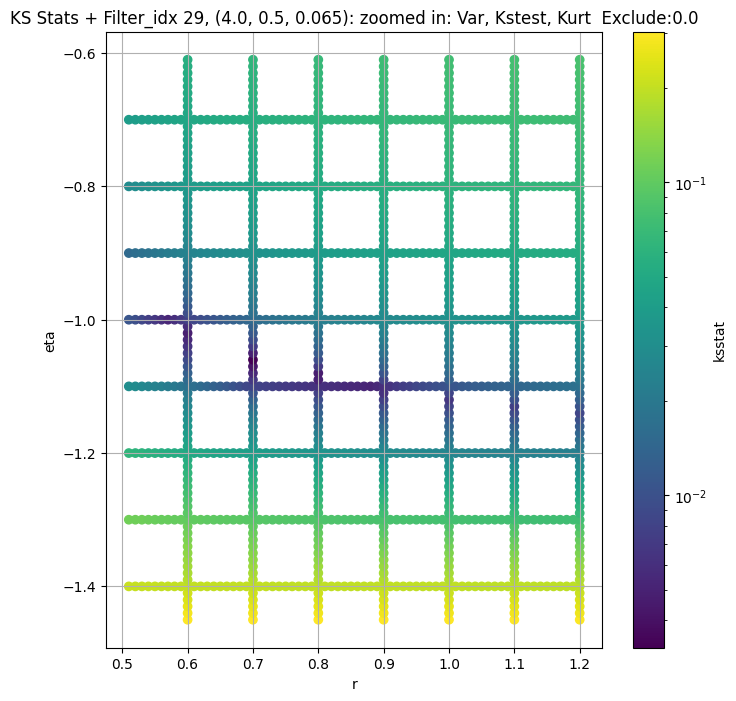

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 30, 200.0 + 100 = 300, ksstat: 0.007424151361894733, var: 5508.33203125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 30, 200.0 + 75 = 275, ksstat: 0.006949204600606149, var: 5576.5390625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 30, 200.0 + 50 = 250, ksstat: 0.006859133972886351, var: 5647.9384765625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 30, 200.0 + 25 = 225, ksstat: 0.006541775094497493, var: 5722.9443359375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 30, 200.0 + 0 = 200, ksstat: 0.006194312482708797, var: 5802.04345703125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 30, 200.0 + -25 = 175, ksstat: 0.005773064584522057, var: 5885.79345703125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 30, 200.0 + -50 = 150, ksstat: 0.005771410215980044, var: 5974.935546875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 30, 200.0 + -75 = 125, ksstat: 0.005727454273567571, var: 6070.62255859375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 30, 200.0 + -100 = 100, ksstat: 0.00543428029669224, var: 6174.2353515625
Number of samples: 100000, Without approximation : 65536000.0


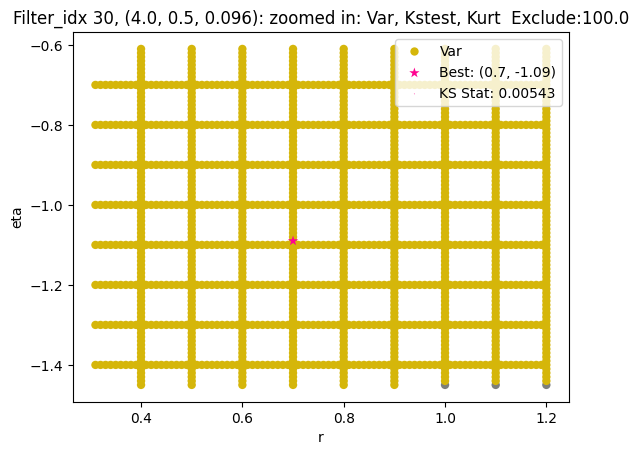

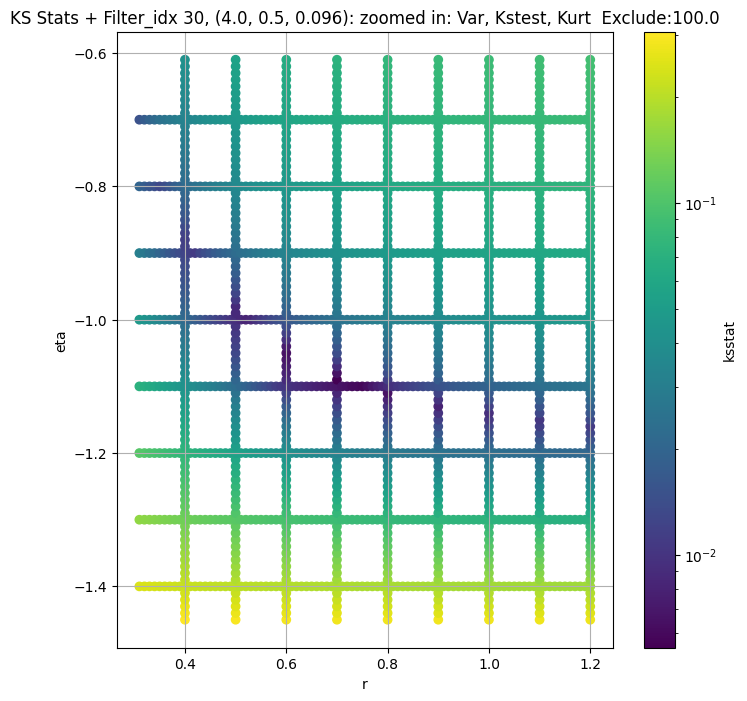

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 31, 100.0 + 100 = 200, ksstat: 0.007048228541747414, var: 2312.99072265625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 31, 100.0 + 75 = 175, ksstat: 0.006964899143993675, var: 2350.173095703125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 31, 100.0 + 50 = 150, ksstat: 0.006707882897239004, var: 2389.971435546875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 31, 100.0 + 25 = 125, ksstat: 0.006406424978810832, var: 2432.846923828125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 31, 100.0 + 0 = 100, ksstat: 0.005935614348445674, var: 2479.44580078125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 31, 100.0 + -25 = 75, ksstat: 0.005413127087437429, var: 2530.972412109375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 31, 100.0 + -50 = 50, ksstat: 0.005449137446778773, var: 2589.29248046875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 31, 100.0 + -75 = 25, ksstat: 0.005523367077313712, var: 2658.803466796875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 31, 100.0 + -100 = 0, ksstat: 0.004699298389882478, var: 2787.092529296875
Number of samples: 100000, Without approximation : 65536000.0


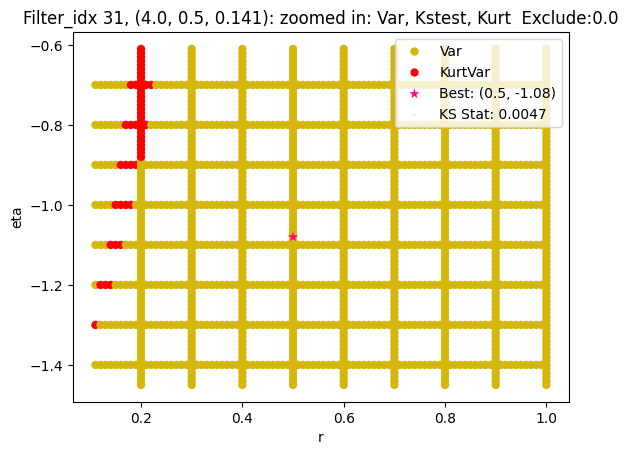

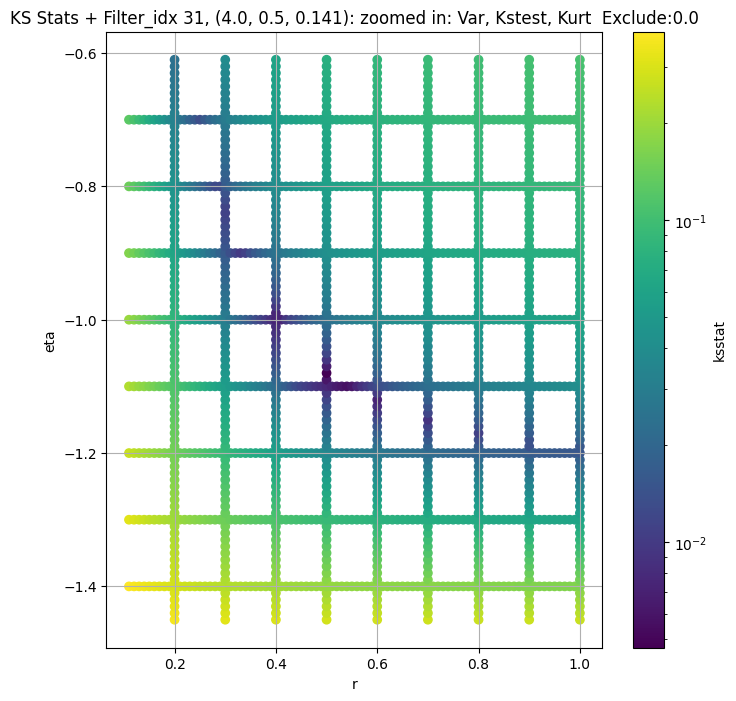

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 50.0 + 100 = 150, ksstat: 0.0061685335100615316, var: 1057.717529296875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 50.0 + 75 = 125, ksstat: 0.0055694436958776405, var: 1077.8409423828125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 50.0 + 50 = 100, ksstat: 0.005134848513758339, var: 1099.9090576171875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 50.0 + 25 = 75, ksstat: 0.005320603799647605, var: 1124.5213623046875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 50.0 + 0 = 50, ksstat: 0.004938441218829859, var: 1152.6630859375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 50.0 + -25 = 25, ksstat: 0.004490410999199224, var: 1186.516357421875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 32, 50.0 + -50 = 0, ksstat: 0.0035870312536179227, var: 1247.41259765625
Number of samples: 100000, Without approximation : 65536000.0


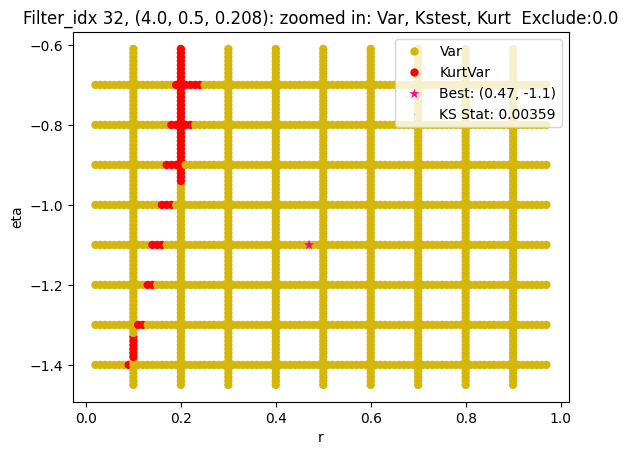

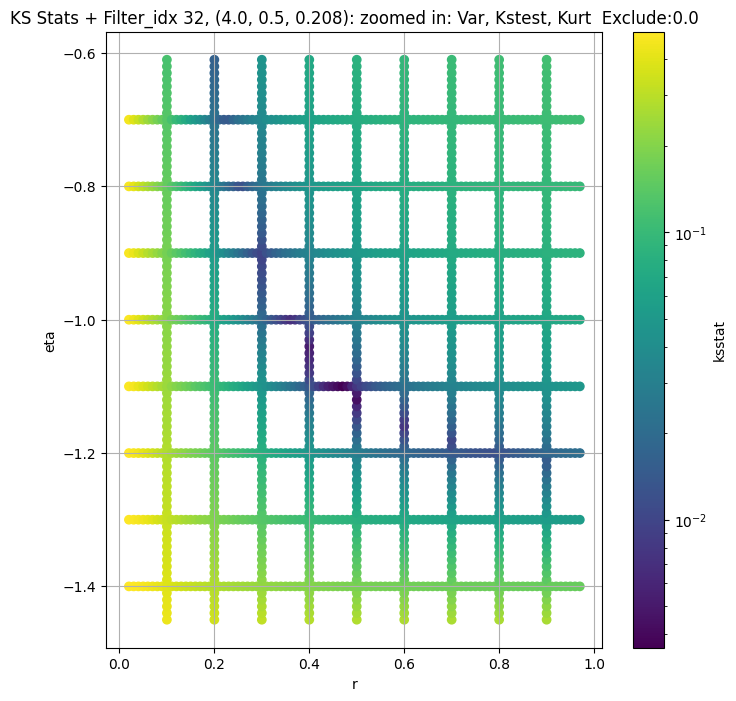

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 33, 0.0 + 100 = 100, ksstat: 0.00595677261167693, var: 483.6577453613281


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 33, 0.0 + 75 = 75, ksstat: 0.00565664978401359, var: 495.2498779296875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 33, 0.0 + 50 = 50, ksstat: 0.005116611438344215, var: 508.531494140625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 33, 0.0 + 25 = 25, ksstat: 0.004121342826750918, var: 524.513671875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 33, 0.0 + 0 = 0, ksstat: 0.00553965714653204, var: 554.567626953125
Number of samples: 100000, Without approximation : 65536000.0


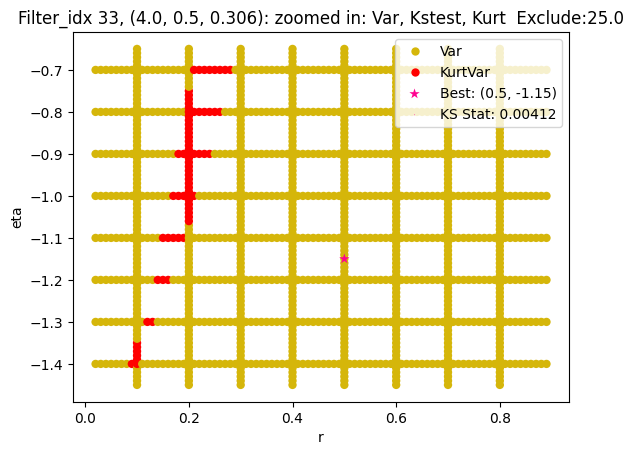

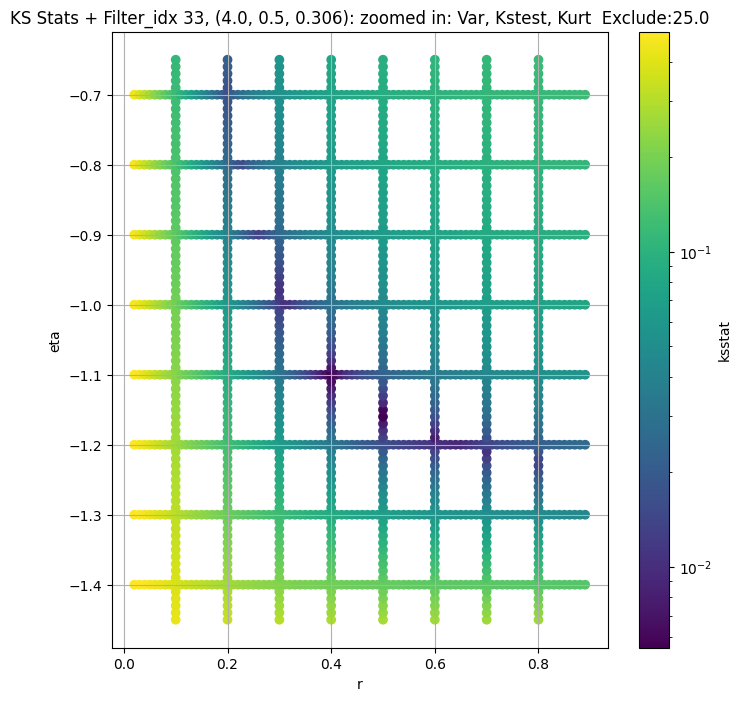

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 100 = 200, ksstat: 0.0122559280562341, var: 216.5532989501953


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 75 = 175, ksstat: 0.01199797792861279, var: 220.5303497314453


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 50 = 150, ksstat: 0.011423719385285566, var: 224.76397705078125


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 25 = 125, ksstat: 0.011411395448401307, var: 229.33848571777344


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + 0 = 100, ksstat: 0.011311428333508011, var: 234.34133911132812


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + -25 = 75, ksstat: 0.011487668151279218, var: 239.9146270751953


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + -50 = 50, ksstat: 0.011651952906884477, var: 246.2764892578125


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + -75 = 25, ksstat: 0.011397117088676523, var: 253.8977813720703


  0%|          | 0/1298 [00:00<?, ?it/s]

Finding Minimum after computing 1298 CDFs
filter_idx 34, 100.0 + -100 = 0, ksstat: 0.010863240964447796, var: 266.860595703125
Number of samples: 100000, Without approximation : 65536000.0


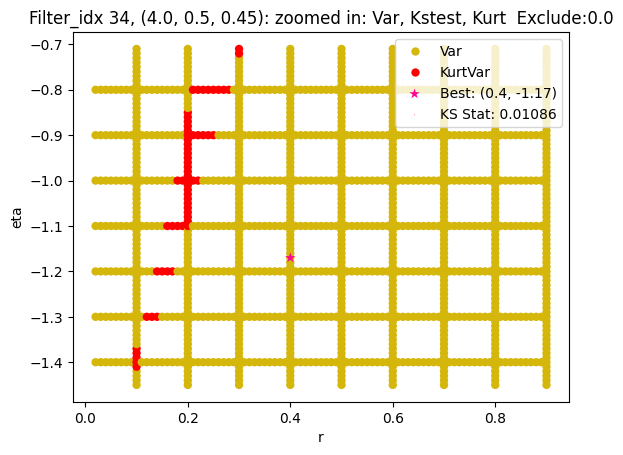

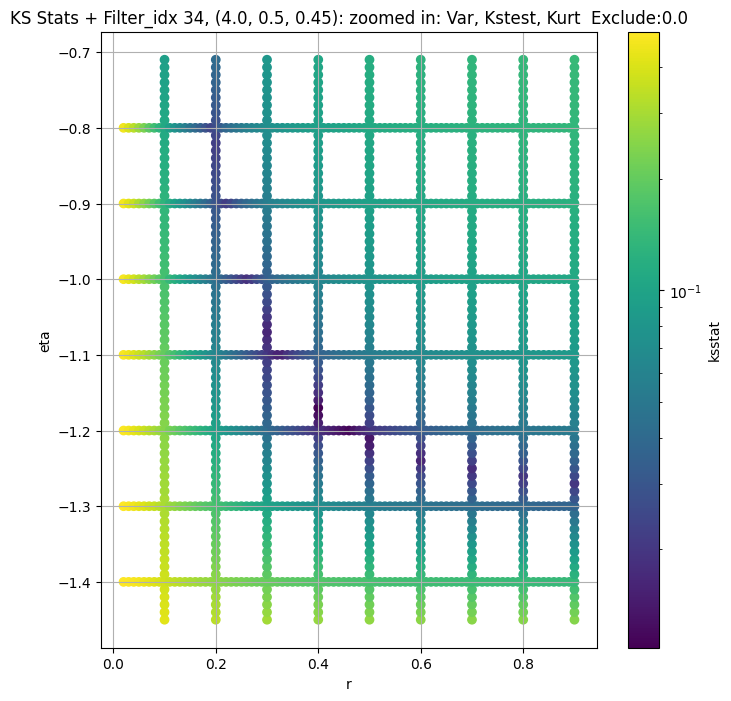

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 50.0 + 100 = 150, ksstat: 0.003038493715911028, var: 49337.21484375


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 50.0 + 75 = 125, ksstat: 0.0026678407656881564, var: 50217.8828125


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 50.0 + 50 = 100, ksstat: 0.0023501868624366297, var: 51177.23828125


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 50.0 + 25 = 75, ksstat: 0.0019072586149398007, var: 52238.46875


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 50.0 + 0 = 50, ksstat: 0.0021268106129038733, var: 53433.109375


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 50.0 + -25 = 25, ksstat: 0.0020562549724612023, var: 54864.76171875


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 35, 50.0 + -50 = 0, ksstat: 0.0022513044381209796, var: 57588.61328125
Number of samples: 100000, Without approximation : 65536000.0


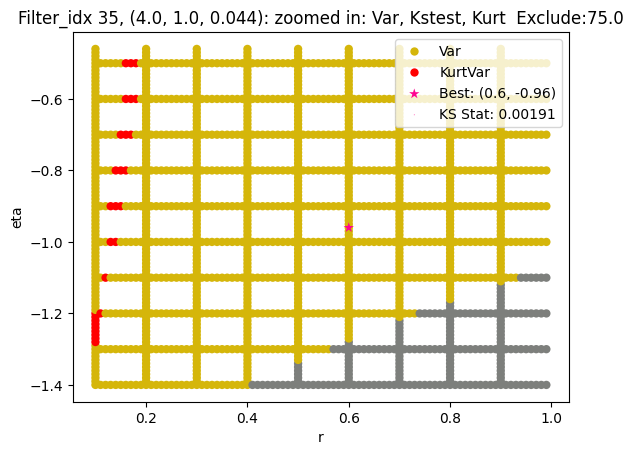

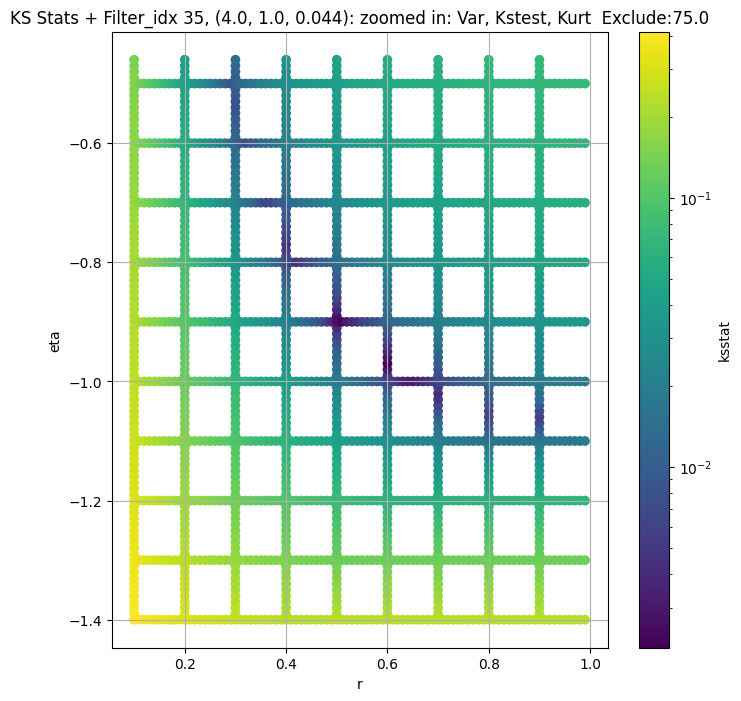

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 36, 100.0 + 100 = 200, ksstat: 0.00421090660833599, var: 17954.87109375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 36, 100.0 + 75 = 175, ksstat: 0.003773660370215093, var: 18277.44140625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 36, 100.0 + 50 = 150, ksstat: 0.0034466270723948478, var: 18623.3984375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 36, 100.0 + 25 = 125, ksstat: 0.003326605754310718, var: 18997.28125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 36, 100.0 + 0 = 100, ksstat: 0.002849000988340719, var: 19405.349609375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 36, 100.0 + -25 = 75, ksstat: 0.002702027042403965, var: 19857.39453125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 36, 100.0 + -50 = 50, ksstat: 0.0028317107214139714, var: 20370.689453125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 36, 100.0 + -75 = 25, ksstat: 0.0028105434991472222, var: 20975.3828125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 36, 100.0 + -100 = 0, ksstat: 0.0029646630157064147, var: 21983.224609375
Number of samples: 100000, Without approximation : 65536000.0


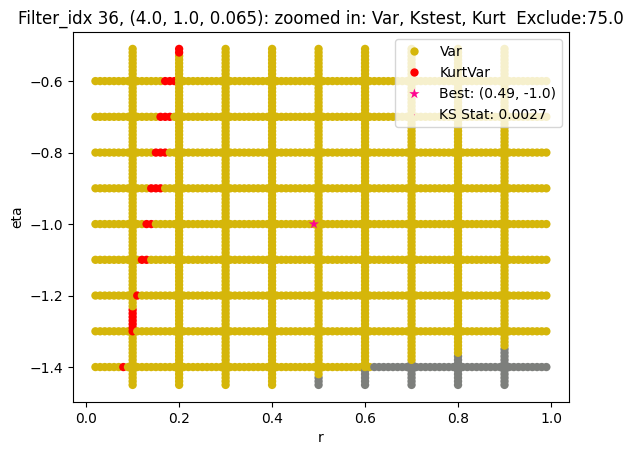

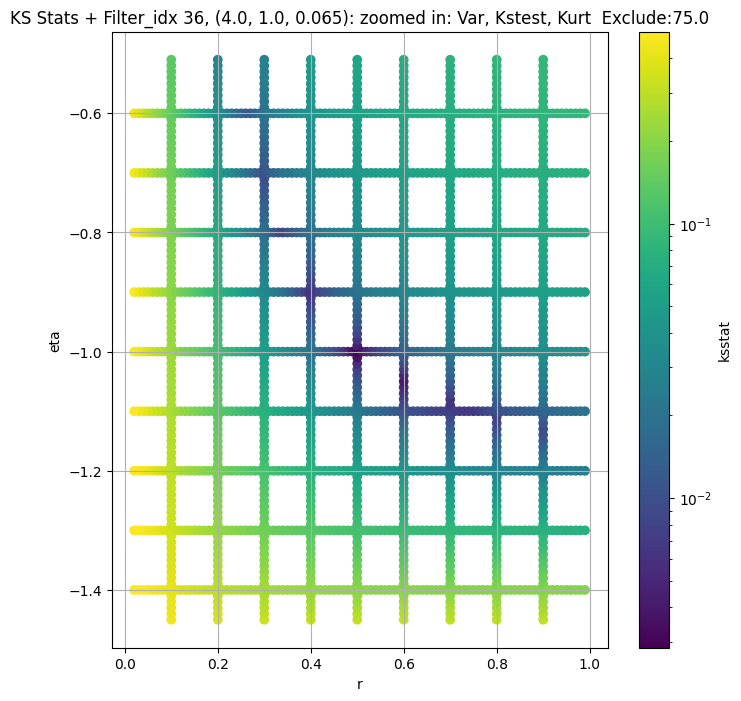

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 37, 0.0 + 100 = 100, ksstat: 0.003143385311302649, var: 6850.99658203125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 37, 0.0 + 75 = 75, ksstat: 0.00341828791374188, var: 7037.736328125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 37, 0.0 + 50 = 50, ksstat: 0.0030592043681328396, var: 7251.35205078125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 37, 0.0 + 25 = 25, ksstat: 0.0032378619500808004, var: 7507.53857421875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 37, 0.0 + 0 = 0, ksstat: 0.0033336666651988534, var: 7936.630859375
Number of samples: 100000, Without approximation : 65536000.0


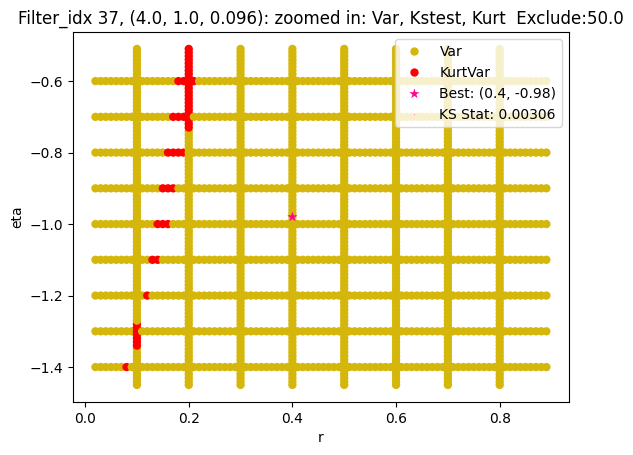

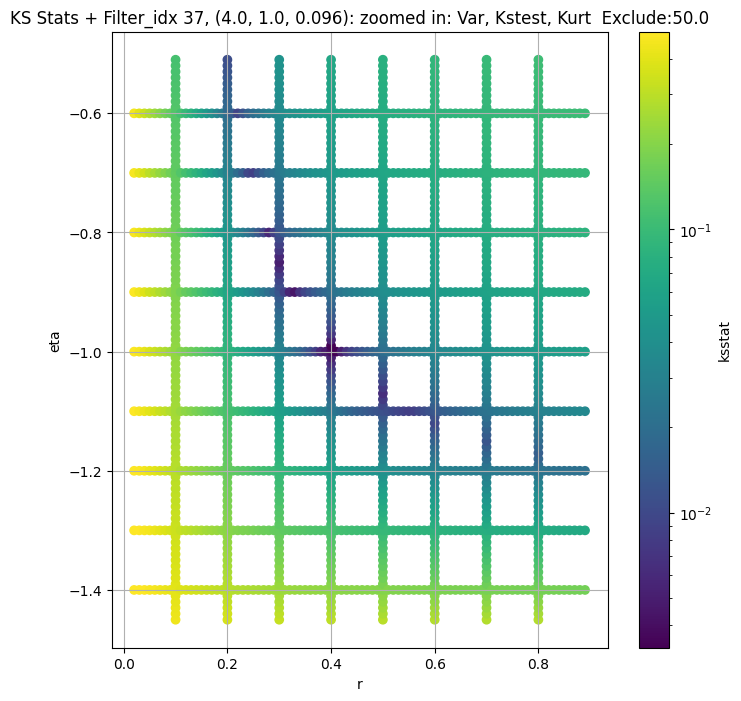

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 100 = 150, ksstat: 0.0038656697474895862, var: 2598.2021484375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 75 = 125, ksstat: 0.0032547475142981064, var: 2665.064453125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 50 = 100, ksstat: 0.0027798823291680375, var: 2739.68310546875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 25 = 75, ksstat: 0.002615755636098449, var: 2824.2001953125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + 0 = 50, ksstat: 0.002944607750760886, var: 2922.508544921875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + -25 = 25, ksstat: 0.002537558105665083, var: 3042.198974609375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 38, 50.0 + -50 = 0, ksstat: 0.0029225649131643383, var: 3282.5146484375
Number of samples: 100000, Without approximation : 65536000.0


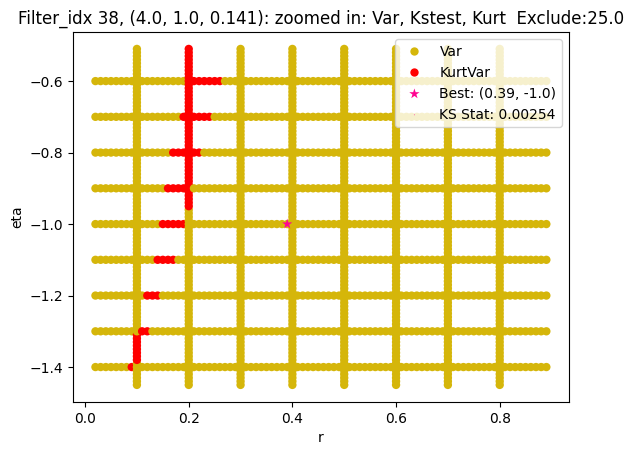

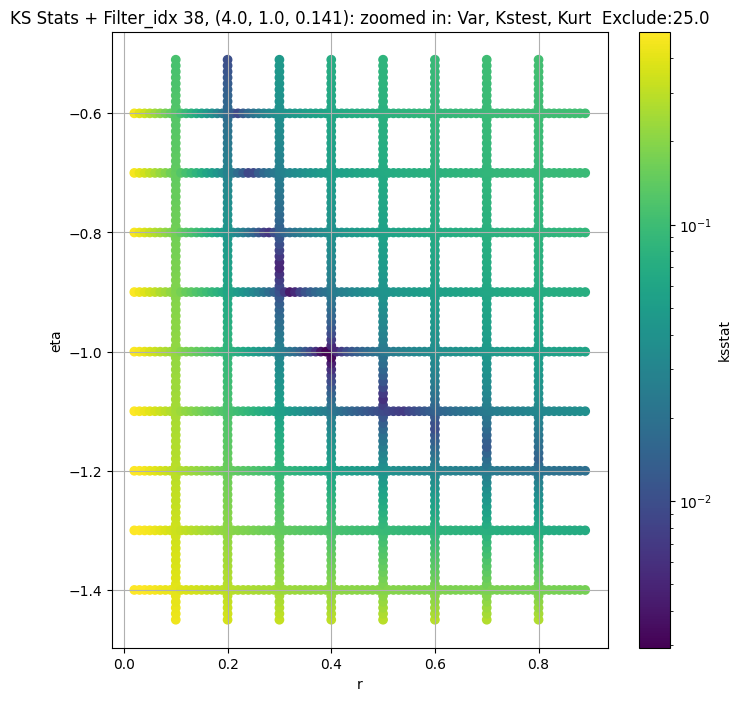

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 39, 200.0 + 100 = 300, ksstat: 0.005505396947317033, var: 991.7989501953125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 39, 200.0 + 75 = 275, ksstat: 0.005098842947275584, var: 1010.90478515625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 39, 200.0 + 50 = 250, ksstat: 0.005014305336878078, var: 1031.165771484375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 39, 200.0 + 25 = 225, ksstat: 0.004630667611094319, var: 1052.7188720703125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 39, 200.0 + 0 = 200, ksstat: 0.0042364872740581865, var: 1075.7335205078125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 39, 200.0 + -25 = 175, ksstat: 0.0038377730001123225, var: 1100.523193359375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 39, 200.0 + -50 = 150, ksstat: 0.003423909754388277, var: 1127.424072265625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 39, 200.0 + -75 = 125, ksstat: 0.003078603546349812, var: 1156.8758544921875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 39, 200.0 + -100 = 100, ksstat: 0.003060030271570025, var: 1189.578369140625
Number of samples: 100000, Without approximation : 65536000.0


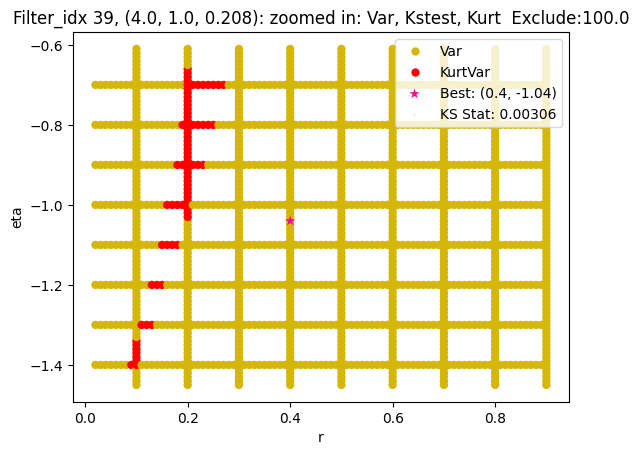

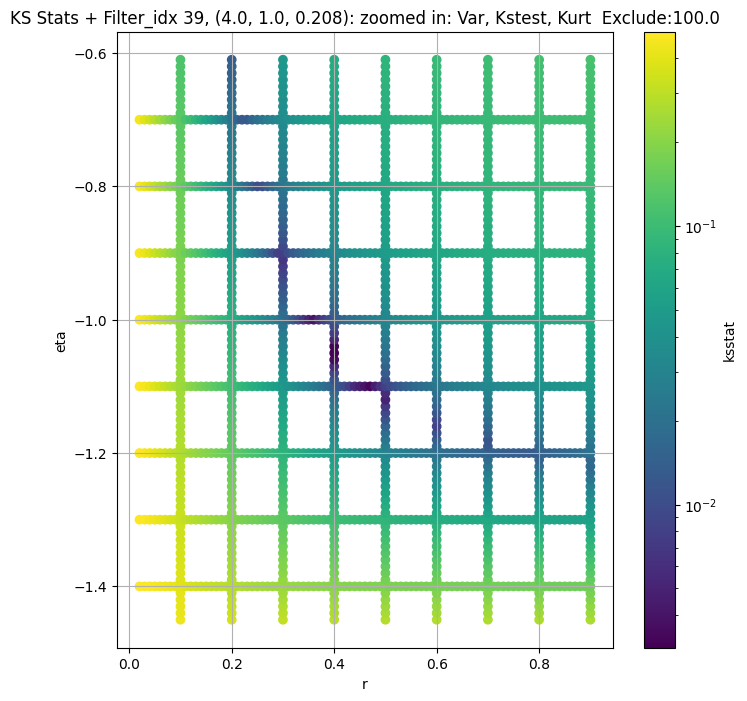

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 50.0 + 100 = 150, ksstat: 0.004002083202695378, var: 503.2402038574219


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 50.0 + 75 = 125, ksstat: 0.0036920874719672536, var: 516.4177856445312


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 50.0 + 50 = 100, ksstat: 0.003759639993140329, var: 531.1715087890625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 50.0 + 25 = 75, ksstat: 0.003489851984643577, var: 548.0083618164062


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 50.0 + 0 = 50, ksstat: 0.0038602543138211987, var: 567.8214721679688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 50.0 + -25 = 25, ksstat: 0.003086021600173794, var: 592.204345703125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 40, 50.0 + -50 = 0, ksstat: 0.002656200257321273, var: 636.5206909179688
Number of samples: 100000, Without approximation : 65536000.0


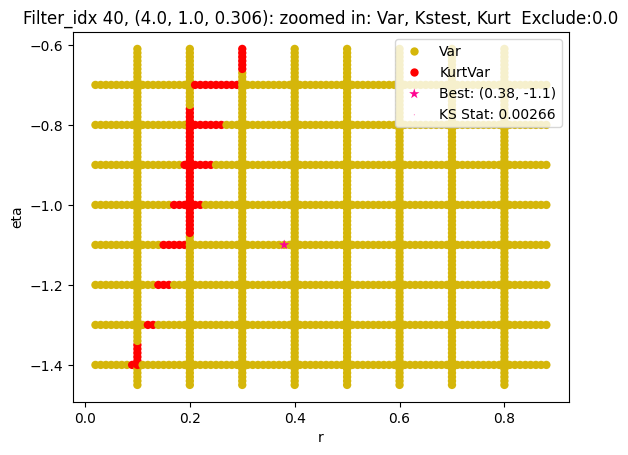

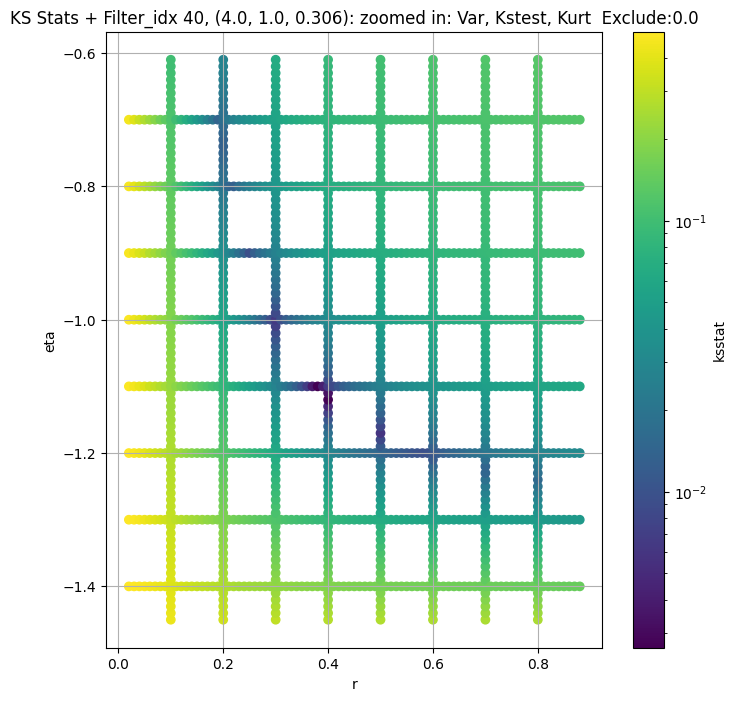

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 41, 0.0 + 100 = 100, ksstat: 0.009375896636916403, var: 237.91802978515625


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 41, 0.0 + 75 = 75, ksstat: 0.00981894052247434, var: 246.05844116210938


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 41, 0.0 + 50 = 50, ksstat: 0.00949774668855885, var: 255.75135803222656


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 41, 0.0 + 25 = 25, ksstat: 0.008681089096221284, var: 267.96075439453125


  0%|          | 0/1160 [00:00<?, ?it/s]

Finding Minimum after computing 1160 CDFs
filter_idx 41, 0.0 + 0 = 0, ksstat: 0.010042469987047942, var: 288.7977600097656
Number of samples: 100000, Without approximation : 65536000.0


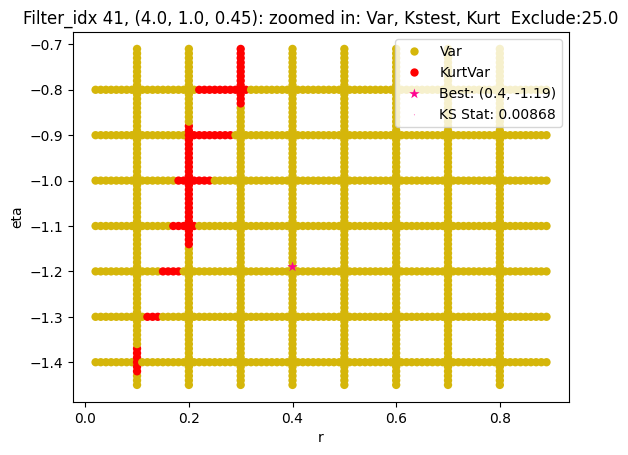

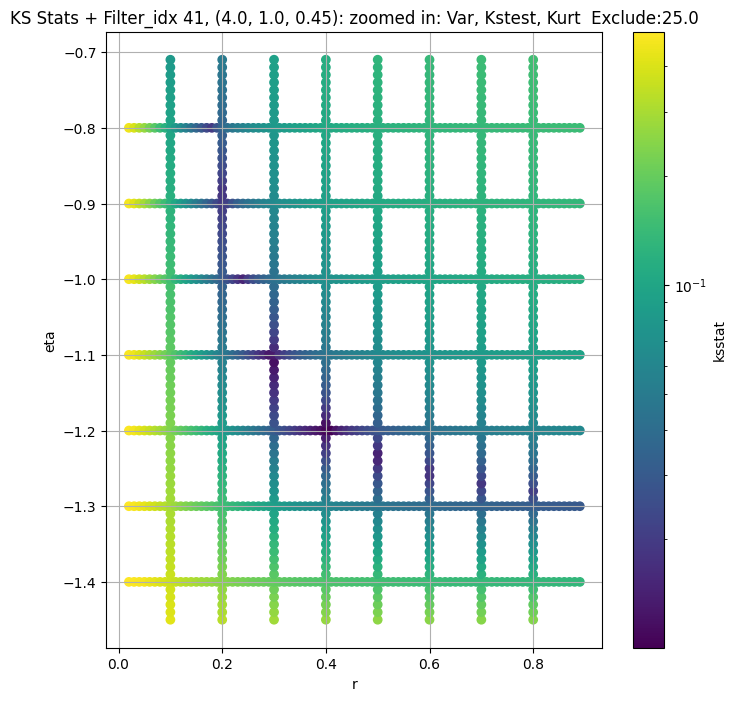

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",53968.47700,42842.63700,65663.23400,4.529419,2.671541,9.929728,65536000.0,"(2.0, 0.5, 0.044)",0.007355,...,81198.947855,0.0,53968.476562,0.000168,0.005743,0.90,-1.02,99893.946996,0.0,54000
1,"(2.0, 0.5, 0.065)",20821.29500,16402.21900,26296.40400,5.743000,3.342600,14.397355,65536000.0,"(2.0, 0.5, 0.065)",0.003834,...,46660.567701,0.0,20821.294922,0.000168,0.003260,0.94,-1.10,48943.191226,0.0,182250
2,"(2.0, 0.5, 0.096)",7666.59000,6005.21500,9682.26800,7.084080,3.844694,16.008696,65536000.0,"(2.0, 0.5, 0.096)",0.004428,...,14162.766920,50.0,7666.589844,0.000168,0.003934,0.70,-1.09,11604.409871,0.0,121500
3,"(2.0, 0.5, 0.141)",3192.91380,2420.70830,4104.83300,8.654820,4.767221,21.822508,65536000.0,"(2.0, 0.5, 0.141)",0.004365,...,3631.311098,0.0,3192.913818,0.000168,0.003536,0.63,-1.10,4048.448858,0.0,144000
4,"(2.0, 0.5, 0.208)",1371.63120,1016.44110,1742.18730,9.491283,5.425109,24.351202,65536000.0,"(2.0, 0.5, 0.208)",0.005394,...,1477.715316,50.0,1371.631226,0.000168,0.003667,0.60,-1.12,1666.377470,0.0,144000
5,"(2.0, 0.5, 0.306)",537.38885,396.54030,695.85910,10.527098,5.672311,24.628796,65536000.0,"(2.0, 0.5, 0.306)",0.009254,...,1420.792471,0.0,520.057251,0.000168,0.009254,0.82,-1.20,1417.843625,25.0,22780
6,"(2.0, 0.5, 0.45)",364.30988,267.56274,482.30508,10.603776,6.072431,26.286480,65536000.0,"(2.0, 0.5, 0.45)",0.011956,...,821.215763,200.0,301.731201,0.000168,0.011952,0.72,-1.20,688.145424,250.0,13500
7,"(2.0, 1.0, 0.044)",76423.19500,61806.15600,95057.44500,5.325180,3.042860,11.335867,65536000.0,"(2.0, 1.0, 0.044)",0.006107,...,70326.058944,50.0,73572.851562,0.000168,0.004090,0.80,-0.95,99460.918182,50.0,108000
8,"(2.0, 1.0, 0.065)",28467.82000,21926.42800,36817.16400,7.597873,3.740597,19.843456,65536000.0,"(2.0, 1.0, 0.065)",0.003486,...,71116.981263,100.0,28467.820312,0.000168,0.002238,0.80,-1.07,50674.641802,0.0,384000


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

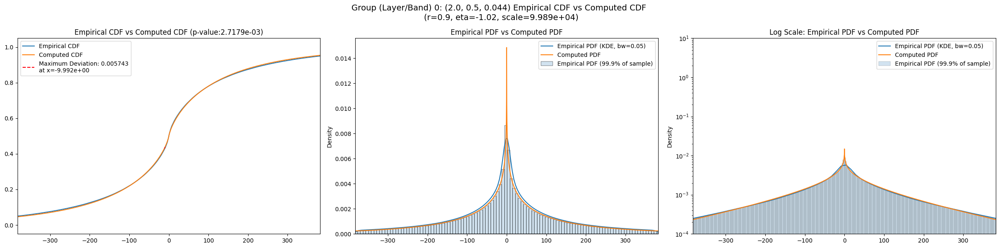

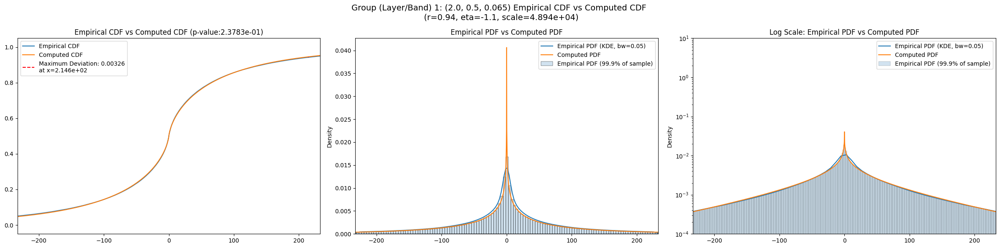

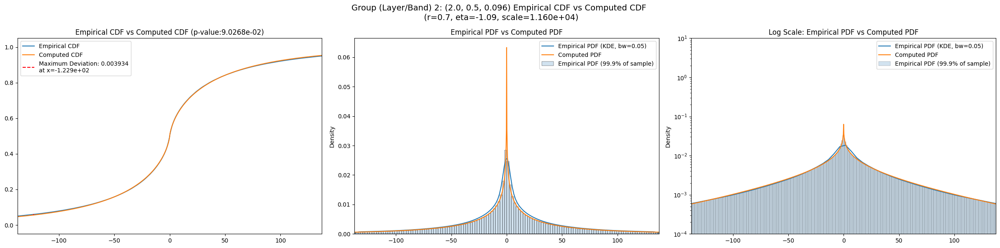

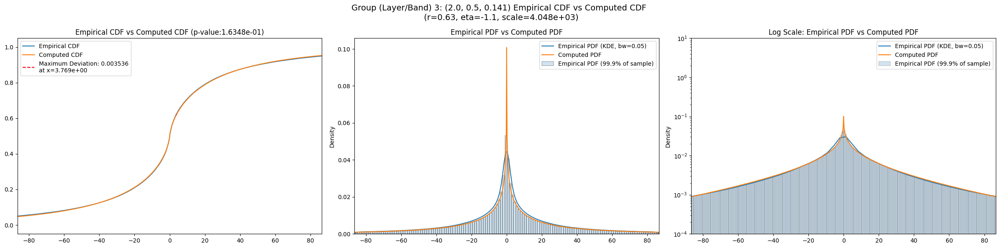

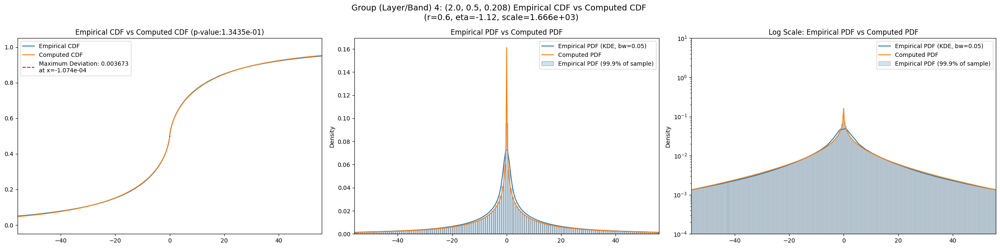

...

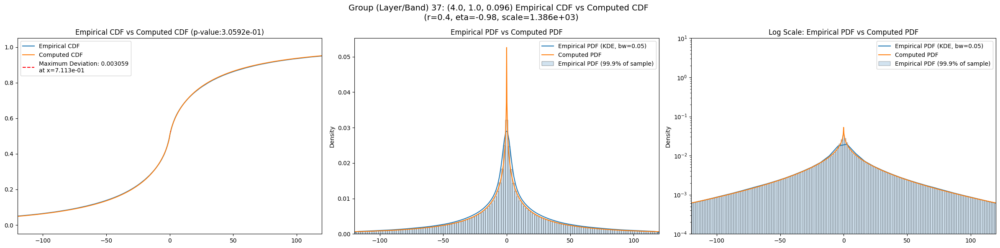

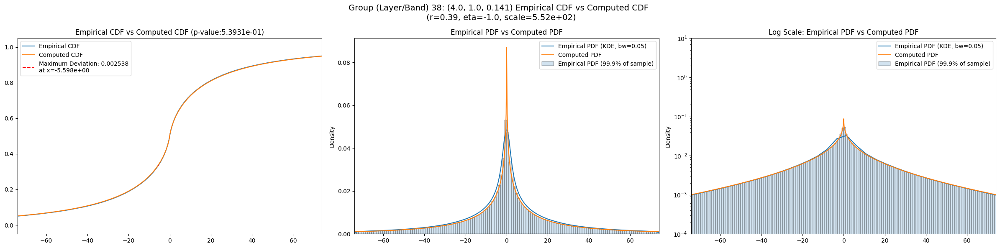

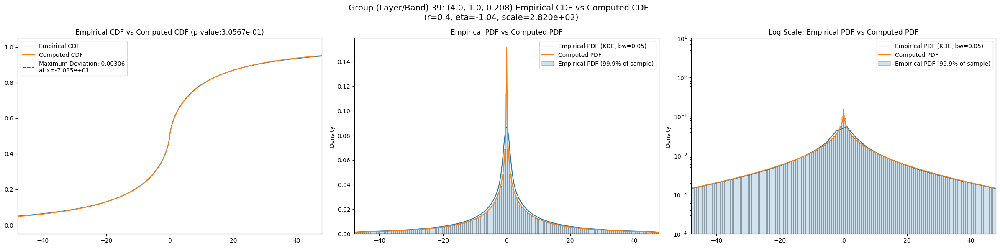

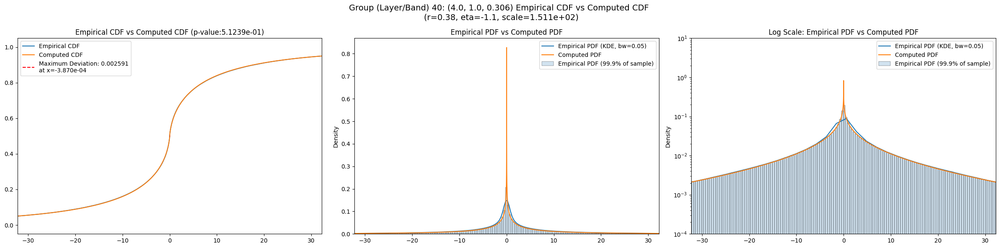

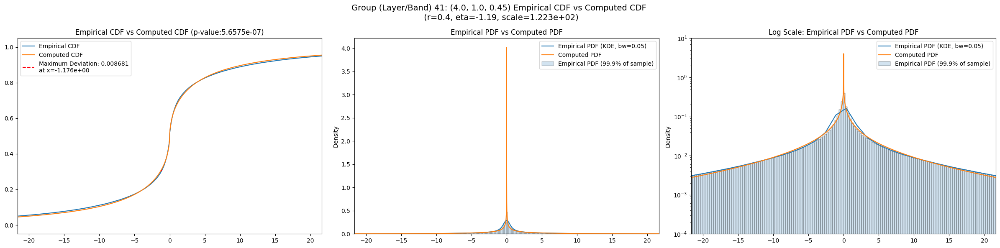

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",53968.47700,42842.63700,65663.23400,4.529419,2.671541,9.929728,65536000.0,"(2.0, 0.5, 0.044)",0.007355,...,142.49300,0.058979,0.0,121.62100,0.033671,0.0,97.37000,0.037580,0.0,0.000000e+00
1,"(2.0, 0.5, 0.065)",20821.29500,16402.21900,26296.40400,5.743000,3.342600,14.397355,65536000.0,"(2.0, 0.5, 0.065)",0.003834,...,79.77150,0.065197,0.0,67.91570,0.040220,0.0,53.79220,0.043362,0.0,0.000000e+00
2,"(2.0, 0.5, 0.096)",7666.59000,6005.21500,9682.26800,7.084080,3.844694,16.008696,65536000.0,"(2.0, 0.5, 0.096)",0.004428,...,44.85610,0.067721,0.0,38.31990,0.042640,0.0,30.10200,0.045094,0.0,0.000000e+00
3,"(2.0, 0.5, 0.141)",3192.91380,2420.70830,4104.83300,8.654820,4.767221,21.822508,65536000.0,"(2.0, 0.5, 0.141)",0.004365,...,26.81360,0.071009,0.0,22.85150,0.046346,0.0,17.85360,0.048454,0.0,0.000000e+00
4,"(2.0, 0.5, 0.208)",1371.63120,1016.44110,1742.18730,9.491283,5.425109,24.351202,65536000.0,"(2.0, 0.5, 0.208)",0.005394,...,16.59120,0.073427,0.0,14.18850,0.048633,0.0,11.03390,0.050295,0.0,0.000000e+00
5,"(2.0, 0.5, 0.306)",537.38885,396.54030,695.85910,10.527098,5.672311,24.628796,65536000.0,"(2.0, 0.5, 0.306)",0.009254,...,9.48080,0.078284,0.0,8.05866,0.054085,0.0,6.25653,0.055803,0.0,0.000000e+00
6,"(2.0, 0.5, 0.45)",364.30988,267.56274,482.30508,10.603776,6.072431,26.286480,65536000.0,"(2.0, 0.5, 0.45)",0.011956,...,7.41032,0.082622,0.0,6.28300,0.058672,0.0,4.87037,0.060317,0.0,0.000000e+00
7,"(2.0, 1.0, 0.044)",76423.19500,61806.15600,95057.44500,5.325180,3.042860,11.335867,65536000.0,"(2.0, 1.0, 0.044)",0.006107,...,173.37300,0.052305,0.0,148.57000,0.026662,0.0,118.77700,0.030467,0.0,0.000000e+00
8,"(2.0, 1.0, 0.065)",28467.82000,21926.42800,36817.16400,7.597873,3.740597,19.843456,65536000.0,"(2.0, 1.0, 0.065)",0.003486,...,93.47160,0.060592,0.0,79.56550,0.035645,0.0,63.32570,0.039168,0.0,1.662357e-285


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.007355,0.000168,0.005743,0.058979,0.033671,0.037580
1,0.003834,0.000168,0.003260,0.065197,0.040220,0.043362
2,0.004428,0.000168,0.003934,0.067721,0.042640,0.045094
3,0.004365,0.000168,0.003536,0.071009,0.046346,0.048454
4,0.005394,0.000168,0.003667,0.073427,0.048633,0.050295
5,0.009254,0.000168,0.009254,0.078284,0.054085,0.055803
6,0.011956,0.000168,0.011952,0.082622,0.058672,0.060317
7,0.006107,0.000168,0.004090,0.052305,0.026662,0.030467
8,0.003486,0.000168,0.002238,0.060592,0.035645,0.039168


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,53968.476562,0.005743,0.90,-1.02,99893.946996,0.0
1,20821.294922,0.003260,0.94,-1.10,48943.191226,0.0
2,7666.589844,0.003934,0.70,-1.09,11604.409871,0.0
3,3192.913818,0.003536,0.63,-1.10,4048.448858,0.0
4,1371.631226,0.003667,0.60,-1.12,1666.377470,0.0
5,520.057251,0.009254,0.82,-1.20,1417.843625,25.0
6,301.731201,0.011952,0.72,-1.20,688.145424,250.0
7,73572.851562,0.004090,0.80,-0.95,99460.918182,50.0
8,28467.820312,0.002238,0.80,-1.07,50674.641802,0.0
